# Package initiation

In [1]:
%load_ext autoreload
%autoreload 2

import os
import re
import shutil
import random
import pprint
import itertools
import functools
import collections

import pysam
import pyranges as pr
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import scipy.stats
import sklearn.cluster
import sklearn.mixture

import sys
sys.path.append('/home/users/pjh/scripts/python_genome_package_dev')

In [2]:
from handygenome.variant.vcfspec import Vcfspec

from handygenome.sv.breakends import Breakends
from handygenome.variant.variantplus import VariantPlus, VariantPlusList
from handygenome.igvhandle import IGVHandle

import handygenome.refgenome as refgenome
import handygenome.variant.filter as libfilter
import handygenome.variant.variantplus as libvp

In [3]:
FASTA_HG19 = refgenome.get_default_fasta('human')
FASTA_HG38 = refgenome.get_default_fasta('hg38')

CHROMDICT_HG19 = refgenome.get_default_chromdict('human')
CHROMDICT_HG38 = refgenome.get_default_chromdict('hg38')

# Basic setups

In [4]:
SAMPLEIDS = [
    '14', '6', '87', 'F13', 'F2', 'F33', 'F37', 'FF1', 'FF104', 'FF115', 'FF13', 'FF18', 'FF20', 'FF21', 'FF23', 'FF24', 'FF27', 
    'FF3', 'FF31', 'FF34', 'FF37', 'FF39', 'FF4', 'FF43', 'FF53', 'FF56', 'FF57', 'FF58', 'FF6', 'FF62', 'FF67', 'FF71', 'FF76', 
    'FF77', 'FF78', 'FF79', 'FF80', 'FF85', 
    #'IO04',  # swapped sample
    'IO05', 'IO06', 'IO07', 'IO08', 'IO09', 'IO12', 'IO13', 'IO15', 'IO16', 'IO17', 
    'IO18', 'IO22', 'IO23', 'IO24', 'IO25', 'SC126', 'SC134', 'SC31', 'SC81', 'SC88', 'SC97', 'SC98', 
]
SAMPLEIDS_LU = [f'LU-{x}' for x in SAMPLEIDS]
SAMPLEIDS_LU_PANEL = [f'{x}_panel' for x in SAMPLEIDS_LU]
SAMPLEIDS_LU_TUMOR = [f'{x}_tumor' for x in SAMPLEIDS_LU]

BAM_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/02_BAM/'
PANEL_REGION_PATH = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/metadata/panel_bait_design/custom/exon_intron_targetregions_merged.bed'
PANEL_REGION_EXONS_PATH = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/metadata/panel_bait_design/custom/SNUH_FIRST_Lung_Cancer_V5_exon_Regions_tracknamechanged.bed'
PANEL_REGION_INTRONS_PATH = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/metadata/panel_bait_design/custom/SNUH_FIRST_Lung_Cancer_V5_intron_Regions_tracknamechanged.bed'
WGS_TMB_PATH = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/metadata/wgs_TMB_previously_found_210312.txt'

ONCOKB_TOKEN = '864a64ee-cfa0-4b99-aa25-305fb4bcda39'

In [5]:
sampletype_filename_map = {
    'tumor': ['tumor'], 
    'normal': ['normal'], 
    'panel': ['panel'], 
    'rna': ['RNA', 'RNA_GFP'],
}
BAM_PATHS = {sampletype: dict() for sampletype in sampletype_filename_map.keys()}

for top, dirs, files in os.walk(BAM_TOPDIR):
    for f in files:
        for sampleid in SAMPLEIDS_LU:
            for sampletype, fname_portions in sampletype_filename_map.items():
                if f in (f'{sampleid}.{fname_portion}.bam' for fname_portion in fname_portions):
                    BAM_PATHS[sampletype][sampleid] = os.path.join(top, f)

In [6]:
BAMS = {
    sampletype: {
        sampleid: pysam.AlignmentFile(bampath) 
        for sampleid, bampath in bampathdic.items()
    }
    for sampletype, bampathdic in BAM_PATHS.items()
}

In [7]:
_sampleid_keys = ['LU-14', 'LU-6', 'LU-87', 'LU-F13', 'LU-F2', 'LU-F33', 'LU-F37', 'LU-FF1', 'LU-FF104', 'LU-FF115', 'LU-FF13', 'LU-FF18', 'LU-FF20', 'LU-FF21', 'LU-FF23', 'LU-FF24', 'LU-FF27', 'LU-FF3', 'LU-FF31', 'LU-FF34', 'LU-FF37', 'LU-FF39', 'LU-FF4', 'LU-FF43', 'LU-FF53', 'LU-FF56', 'LU-FF57', 'LU-FF58', 'LU-FF6', 'LU-FF62', 'LU-FF67', 'LU-FF71', 'LU-FF76', 'LU-FF77', 'LU-FF78', 'LU-FF79', 'LU-FF80', 'LU-FF85', 'LU-IO04', 'LU-IO05', 'LU-IO06', 'LU-IO07', 'LU-IO08', 'LU-IO09', 'LU-IO12', 'LU-IO13', 'LU-IO15', 'LU-IO16', 'LU-IO17', 'LU-IO18', 'LU-IO22', 'LU-IO23', 'LU-IO24', 'LU-IO25', 'LU-SC126', 'LU-SC134', 'LU-SC31', 'LU-SC81', 'LU-SC88', 'LU-SC97', 'LU-SC98',]

PREVIOUS_PURITY = dict(zip(
    _sampleid_keys,
    [0.31, 0.16, 0.24, 0.75, 0.28, 0.5, 0.34, 0.17, 0.45, 0.43, 0.21, 0.86, 0.32, 0.37, 0.35, 0.5, 0.48, 0.2, 0.11, 0.19, 0.75, 0.21, 0.15, 0.34, 0.33, 0.37, 0.21, 0.14, 0.47, 0.52, 0.28, 0.11, 0.54, 0.27, 0.36, 0.36, 0.28, 0.24, 0.1, 0.36, 0.23, 0.24, 0.65, 0.31, 0.49, 0.69, 0.41, 0.32, 0.5, 0.42, 0.57, 0.11, 0.2, 0.28, 0.11, 0.4, 0.22, 0.4, 0.13, 0.15, 0.51,],
))

PREVIOUS_PLOIDY = dict(zip(
    _sampleid_keys,
    [2.6, 2.3, 2.7, 2.4, 1.9, 4.8, 1.9, 2.7, 2, 1.9, 2.9, 2.6, 4.5, 2.9, 2.8, 3.6, 2.1, 2.5, 2.3, 2, 2.4, 2, 2.6, 4.1, 5.7, 2.7, 3.45, 2.3, 2.1, 3.5, 2.2, 2.3, 2, 2.2, 2.9, 2, 2.2, 2.8, 2.1, 2.7, 2.4, 4.5, 2.3, 3.1, 3.5, 3.5, 5.3, 1.9, 3.3, 2.1, 2.9, 1.8, 4.4, 3.3, 2.4, 3.1, 3.7, 3.3, 1.6, 2.5, 1.9,],
))

MEAN_DEPTH_WGS_NORMAL = dict(zip(
    _sampleid_keys,
    [37.3767, 34.0972, 33.8064, 32.7928, 35.8954, 50.7577, 35.2345, 44.4876, 31.9701, 32.5393, 29.2703, 35.8483, 30.652, 30.3674, 30.7484, 37.0206, 32.9964, 32.02, 44.0783, 31.1997, 35.246, 25.3979, 27.8882, 32.5782, 32.0687, 29.2798, 35.0811, 31.21, 31.6326, 30.6922, 34.1979, 36.7596, 46.6577, 31.1763, 33.2672, 30.7369, 49.3219, 39.396, 50.6684, 47.5066, 42.1341, 50.5406, 61.0353, 48.3776, 47.3945, 47.8588, 53.5356, 50.1395, 51.1773, 48.859, 62.2889, 48.3631, 50.9241, 49.4595, 38.866, 48.8294, 60.0835, 39.58, 48.9517, 38.0445, 50.1143, ],
))

MEAN_DEPTH_WGS_TUMOR = dict(zip(
    _sampleid_keys,
    [33.8314, 28.6972, 39.9078, 31.2967, 35.1856, 50.3825, 32.995, 44.5512, 43.6843, 37.4389, 44.6266, 51.0667, 45.7373, 49.1081, 48.7203, 44.3134, 39.4903, 43.6447, 43.191, 46.8438, 32.9415, 43.3598, 47.5503, 48.4404, 47.5455, 42.8442, 36.943, 30.8365, 46.2036, 45.757, 46.2073, 41.2358, 32.9015, 38.2982, 37.7461, 35.5173, 47.0067, 50.212, 47.7919, 49.4914, 40.2729, 48.2904, 48.8819, 49.3573, 48.2809, 48.1625, 46.9765, 48.5246, 47.191, 57.4008, 45.9216, 61.224, 58.4995, 54.2237, 39.9667, 46.8006, 46.7105, 29.9816, 46.1059, 35.9943, 59.4945,],
))

MEAN_DEPTH_PANEL = dict(zip(
    _sampleid_keys,
    [925.555, 828.655, 1056.57, 949.034, 658.752, 943.504, 865.002, 1005.13, 1017.37, 928.113, 704.835, 1038.69, 841.098, 796.267, 861.94, 1199.86, 982.991, 622.94, 755.689, 883.229, 763.161, 994.175, 832.632, 886.978, 870.606, 940.946, 1123.63, 973.926, 867.741, 930.398, 983.845, 933.354, 992.087, 1019.04, 1027.85, 875.693, 860.521, 864.663, 934.823, 894.882, 1150.48, 866.108, 1018.39, 961.328, 1079.97, 792.767, 793.318, 362.512, 858.098, 1006.79, 1154.51, 837.199, 786.832, 1094.11, 689.674, 798.415, 1001.33, 1079.07, 760.339, 761.318, 880.314, ],
))

PANEL_ONTARGET_RATIO = dict(zip(
    _sampleid_keys,
    [0.911, 0.872, 0.79, 0.917, 0.838, 0.761, 0.701, 0.934, 0.924, 0.913, 0.696, 0.718, 0.85, 0.905, 0.87, 0.899, 0.879, 0.66, 0.783, 0.885, 0.761, 0.912, 0.789, 0.868, 0.63, 0.74, 0.808, 0.835, 0.891, 0.698, 0.914, 0.925, 0.922, 0.91, 0.923, 0.86, 0.822, 0.795, 0.758, 0.834, 0.88, 0.926, 0.924, 0.895, 0.869, 0.842, 0.72, 0.838, 0.798, 0.871, 0.91, 0.872, 0.826, 0.904, 0.858, 0.84, 0.881, 0.929, 0.806, 0.831, 0.867, ],
))

GENDER = dict(zip(
    _sampleid_keys,
    ['M', 'F', 'F', 'F', 'M', 'F', 'M', 'M', 'F', 'F', 'M', 'M', 'F', 'F', 'F', 'F', 'M', 'F', 'F', 'M', 'F', 'M', 'F', 'F', 'M', 'M', 'F', 'M', 'M', 'M', 'F', 'M', 'F', 'F', 'F', 'M', 'M', 'M', 'F', 'M', 'F', 'M', 'M', 'M', 'M', 'M', 'M', 'M', 'M', 'F', 'M', 'M', 'F', 'M', 'M', 'M', 'M', 'M', 'M', 'F', 'M',]
))
IS_FEMALE = {key: (val == 'F') for key, val in GENDER.items()}

In [8]:
PANEL_REGION_EXONS_GR = pr.PyRanges(
    pd.read_csv(PANEL_REGION_EXONS_PATH, sep='\t', header=0, skiprows=2, names=['Chromosome', 'Start', 'End', 'gene'])
)
PANEL_REGION_INTRONS_GR = pr.PyRanges(
    pd.read_csv(PANEL_REGION_INTRONS_PATH, sep='\t', header=0, skiprows=2, names=['Chromosome', 'Start', 'End', 'gene'])
)

PANEL_REGION_GR = pr.read_bed(PANEL_REGION_PATH)
PANEL_REGION_GR_100bin = PANEL_REGION_GR.window(100)

In [9]:
WHOLE_GENOME_LENGTH = 3_095_677_412
PANEL_REGION_LENGTH = 1_890_272

In [10]:
igv = IGVHandle(60387)

# Setup convenience functions

In [11]:
def load_bams(sampleid, load_rna=False, new=True):
    if new:
        igv.cmd('new')
    if load_rna:
        igv.load([
            BAM_PATHS['normal'][sampleid], 
            BAM_PATHS['tumor'][sampleid], 
            BAM_PATHS['panel'][sampleid],
            BAM_PATHS['rna'][sampleid],
            PANEL_REGION_PATH,
        ])
    else:
        igv.load([
            BAM_PATHS['normal'][sampleid], 
            BAM_PATHS['tumor'][sampleid], 
            BAM_PATHS['panel'][sampleid],
            PANEL_REGION_PATH,
        ])        

        
def load_bams_multisample(sampleids, normal=False, tumor=False, panel=False, rna=False, new=True):
    if new:
        igv.cmd('new')
        
    igv.load([PANEL_REGION_PATH])

    for sampleid in sampleids:
        if normal:
            igv.load([BAM_PATHS['normal'][sampleid]])
        if tumor:
            igv.load([BAM_PATHS['tumor'][sampleid]])
        if panel:
            igv.load([BAM_PATHS['panel'][sampleid]])
        if rna:
            igv.load([BAM_PATHS['rna'][sampleid]])
        
        
def show_vp_igv(vp, sampleid):
    igv.cmd('new')
    igv.load([PANEL_REGION_PATH, PANEL_REGION_EXONS_PATH, PANEL_REGION_INTRONS_PATH])
    load_bams(sampleid)

    igv.goto([vp.vcfspec], width=200)
    igv.cmd('viewaspairs')
    igv.cmd('sort base')

In [12]:
def set_ccfinfo(vplist, sampleid, cnv_seg, is_female, cellularity):
    for vp in vplist:
        vp.ccfinfo_panel = vp.get_ccf_CNm(cnv_seg, is_female, cellularity, f'{sampleid}_panel', allele_index=1)
        vp.ccfinfo_wgs = vp.get_ccf_CNm(cnv_seg, is_female, cellularity, f'{sampleid}_tumor', allele_index=1)
        joined_CNV_gr = vp.get_gr().join(pr.PyRanges(cnv_seg))
        joined_CNV_gr_row = joined_CNV_gr.df.iloc[0, :]
        vp.CNcalls = {'CNt': int(joined_CNV_gr_row['CNt']), 'A': int(joined_CNV_gr_row['A']), 'B': int(joined_CNV_gr_row['B'])}

# Set data file paths

### Copynumber

##### extract, fit file paths

In [14]:
import re

SEQUENZA_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/05_sequenza'

EXTRACT_PATHS = dict()
FIT_PATHS = dict()

for top, dirs, files in os.walk(SEQUENZA_TOPDIR):
    for f in files:
        if re.search(r'_extract\.', f):
            sampleid = 'LU-' + f.split('_')[0]
            if sampleid in SAMPLEIDS_LU:
                EXTRACT_PATHS[sampleid] = os.path.join(top, f)
        if re.search(r'_cp_table\.', f):
            sampleid = 'LU-' + f.split('_')[0]
            if sampleid in SAMPLEIDS_LU:
                FIT_PATHS[sampleid] = os.path.join(top, f)
                

##### depth file paths

In [15]:
import re

DEPTH_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/results'
TUMOR_DEPTH_PATHS = dict()
NORMAL_DEPTH_PATHS = dict()

for top, dirs, files in os.walk(DEPTH_TOPDIR):
    for f in files:
        if f.endswith('regions.bed.gz'):
            sampleid = f.split('.')[0]
            if sampleid in SAMPLEIDS_LU:
                if 'normal' in f:
                    NORMAL_DEPTH_PATHS[sampleid] = os.path.join(top, f)
                if 'tumor' in f:
                    TUMOR_DEPTH_PATHS[sampleid] = os.path.join(top, f)


##### panel bam germline vcf paths

In [444]:
PANEL_GERMLINE_VCF_PATHS = dict()
topdir = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/20_haplotypecaller_panelbamonly/filtered_germline_hets'
for fname in os.listdir(topdir):
    if fname.endswith('vcf.gz'):
        sid = fname.split('.')[0]
        PANEL_GERMLINE_VCF_PATHS[sid] = os.path.join(topdir, fname)

# Load segments dfs

In [17]:
from handygenome.cnv.sequenza_handler import read_sequenza_segment

SEGMENTS_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/26_cnv_segments/final'
CNV_SEGMENT_PATHS = dict()
for f in os.listdir(SEGMENTS_TOPDIR):
    sampleid = f.split('_')[0]
    assert sampleid in SAMPLEIDS_LU
    CNV_SEGMENT_PATHS[sampleid] = os.path.join(SEGMENTS_TOPDIR, f)

CNV_SEGMENTS = {sampleid: read_sequenza_segment(path) for sampleid, path in CNV_SEGMENT_PATHS.items()}

# Make filtered wgs germline variants

In [285]:
import handygenome.variant.filter as libfilter
import handygenome.bameditor as bameditor

sampleid = 'LU-F13'
sampleid_normal = sampleid + '_normal'
in_vcf_path = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/06_haplotypecaller/merged_vcfs/LU-F13.merged.vcf.gz.strip.n_readstats.vcf.gz'

nbam = BAMS['normal'][sampleid]
avg_depth = bameditor.get_average_depth(nbam)

germlinefilter = libfilter.get_preset_filter_germline(
    with_pon=False, 
    cutoffs_totaldepth=((avg_depth * 0.5), (avg_depth * 1.5)),
    cutoffs_vaf=(0.2, 0.8),
)

def vpfilter(vp):
    return germlinefilter.check(vp, sampleid_normal)

In [286]:
out_vcf_path = re.sub(r'vcf\.gz$', 'filtered_het.vcf.gz', in_vcf_path)
vplist = VariantPlusList.from_vcf_lazy(
    vcf_path, 
    init_all_attrs=False, 
    vp_init_params=dict(init_readstats=True, sampleid_list=[f'LU-F13_normal']),
    logging_lineno=10000,
)
vplist.write_with_filter(out_vcf_path, vpfilter)

[KST 2023-04-10 02:16:56.638] VariantPlusList: Processing 10,000th line
[KST 2023-04-10 02:17:09.578] VariantPlusList: Processing 20,000th line
[KST 2023-04-10 02:17:21.538] VariantPlusList: Processing 30,000th line
[KST 2023-04-10 02:17:32.931] VariantPlusList: Processing 40,000th line
[KST 2023-04-10 02:17:44.072] VariantPlusList: Processing 50,000th line
[KST 2023-04-10 02:17:54.714] VariantPlusList: Processing 60,000th line
[KST 2023-04-10 02:18:06.635] VariantPlusList: Processing 70,000th line
[KST 2023-04-10 02:18:29.279] VariantPlusList: Processing 80,000th line
[KST 2023-04-10 02:18:40.883] VariantPlusList: Processing 90,000th line
[KST 2023-04-10 02:18:51.816] VariantPlusList: Processing 100,000th line
[KST 2023-04-10 02:19:03.161] VariantPlusList: Processing 110,000th line
[KST 2023-04-10 02:19:13.609] VariantPlusList: Processing 120,000th line
[KST 2023-04-10 02:19:24.122] VariantPlusList: Processing 130,000th line
[KST 2023-04-10 02:19:35.021] VariantPlusList: Processing 14

# Main

In [13]:
import handygenome.cnv.gcfraction as libgcfraction
import handygenome.cnv.mosdepth as libmosdepth
import handygenome.cnv.misc as cnvmisc
import handygenome.pyranges_helper as pyranges_helper
import handygenome.variant.variantplus as libvp
import handygenome.cnv.rcopynumber as rcopynumber
import handygenome.plot.genomeplot as libgenomeplot
import handygenome.cnv.baf as libbaf

### Load panel depth dataframes

In [14]:
import pickle

PANEL_DEPTH_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/panel_100bin_depths'

MERGED_NORMAL_PANEL_PATH = os.path.join(PANEL_DEPTH_TOPDIR, 'merged_normal_dfs.pickle')

PANEL_DEPTH_PATHS = dict()
for top, dirs, files in os.walk(PANEL_DEPTH_TOPDIR):
    for f in files:
        if f.endswith('bed.gz'):
            pf = f.split('.')[0]
            PANEL_DEPTH_PATHS[pf] = os.path.join(top, f)
            
PANEL_DEPTH_DFS = dict()
for pf, fname in PANEL_DEPTH_PATHS.items():
    PANEL_DEPTH_DFS[pf] = libmosdepth.load_mosdepth_output(fname, as_gr=False)

### Normal panel analysis

In [15]:
NORMAL_PANEL_DEPTH_DFS = dict((key, df) for key, df in PANEL_DEPTH_DFS.items() if key.startswith('S'))

##### Gender identification of normal panel data

In [17]:
X_nonX_data = dict()
for key, df in NORMAL_PANEL_DEPTH_DFS.items():
    isX = df['Chromosome'] == 'X'
    nonX_depth = df.loc[~isX, 'mean_depth'].mean()
    X_depth = df.loc[isX, 'mean_depth'].mean()
    X_nonX_ratio = X_depth / nonX_depth
    X_nonX_data[key] = {'nonX_depth': nonX_depth, 'X_depth': X_depth, 'X_nonX_ratio': X_nonX_ratio}

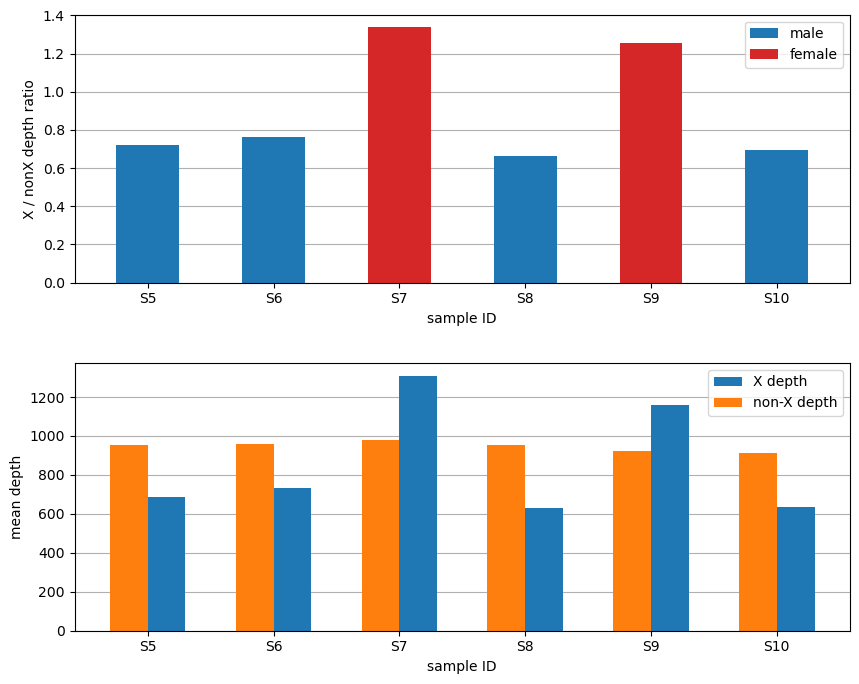

In [18]:
fig, axs = plt.subplots(2, 1, figsize=(10, 8), gridspec_kw=dict(hspace=0.3))
ax_ratio = axs[0]
ax_depth = axs[1]

###

xs_keys = sorted(X_nonX_data.keys(), key=(lambda x: int(x[1:])))
xs = pd.Series(np.arange(len(xs_keys)), index=xs_keys)
xs_num = xs.to_numpy()
# ys_ratio = [X_nonX_data[key]['X_nonX_ratio'] for key in xs.index]

male_samples = ['S5', 'S6', 'S8', 'S10']
female_samples = xs.index.difference(male_samples)

xs_male = xs.loc[male_samples]
ys_ratio_male = [X_nonX_data[key]['X_nonX_ratio'] for key in male_samples]
xs_female = xs.loc[female_samples]
ys_ratio_female = [X_nonX_data[key]['X_nonX_ratio'] for key in female_samples]

ax_ratio.bar(xs_male, ys_ratio_male, width=0.5, color='tab:blue', label='male')
ax_ratio.bar(xs_female, ys_ratio_female, width=0.5, color='tab:red', label='female')
ax_ratio.set_xticks(xs)
ax_ratio.set_xticklabels(xs.index)
ax_ratio.set_xlabel('sample ID')

ax_ratio.set_ylabel('X / nonX depth ratio')
ax_ratio.grid(axis='y')
ax_ratio.yaxis.set_zorder(0)
ax_ratio.legend()

###

width = 0.3
xs_num_xdepth = xs + width / 2
xs_num_nonxdepth = xs - width / 2
ys_xdepth = [X_nonX_data[key]['X_depth'] for key in xs.index]
ys_nonxdepth = [X_nonX_data[key]['nonX_depth'] for key in xs.index]

ax_depth.sharex(ax_ratio)
ax_depth.bar(xs_num_xdepth, ys_xdepth, width=width, label='X depth')
ax_depth.bar(xs_num_nonxdepth, ys_nonxdepth, width=width, label='non-X depth')
ax_depth.set_xticks(xs)
ax_depth.set_xticklabels(xs.index)
ax_depth.set_xlabel('sample ID')

ax_depth.set_ylabel('mean depth')
ax_depth.grid(axis='y')
ax_depth.yaxis.set_zorder(0)
ax_depth.legend()

##### Make merged normal dataframe with X normalization

In [19]:
X_2COPY_NORMAL_PANEL_DEPTHS = list()
isX = NORMAL_PANEL_DEPTH_DFS['S5']['Chromosome'] == 'X'
for key, df in NORMAL_PANEL_DEPTH_DFS.items():
    depths = df['mean_depth'].copy()
    if key in male_samples:
        depths.where(~isX, depths * 2, inplace=True)
    X_2COPY_NORMAL_PANEL_DEPTHS.append(depths)
    
X_2COPY_DF = NORMAL_PANEL_DEPTH_DFS['S5'].iloc[:, :3].copy()
X_2COPY_DF['mean_depth'] = pd.concat(X_2COPY_NORMAL_PANEL_DEPTHS, axis=1).sum(axis=1)

X_1COPY_DF = X_2COPY_DF.assign(mean_depth=(lambda df: df['mean_depth'].where(~isX, df['mean_depth'] * 0.5)))

MERGED_NORMAL_PANEL_DF = {
    'female': X_2COPY_DF,
    'male': X_1COPY_DF,
}

In [20]:


with open(MERGED_NORMAL_PANEL_PATH, mode='wb') as outfile:
    pickle.dump(MERGED_NORMAL_PANEL_DF, outfile)

##### Load merged normal dataframe with X normalization

In [16]:
with open(MERGED_NORMAL_PANEL_PATH, mode='rb') as infile:
    MERGED_NORMAL_PANEL_DF = pickle.load(infile)

##### normal panel copy neutrality test

In [51]:
cnvplotter_panel = libgenomeplot.CNVPlotter(refver='hg19', region_df=PANEL_REGION_GR.df, region_gaps=0)
# cnvplotter_panel = libgenomeplot.CNVPlotter(refver='hg19', region_gaps=0)

[KST 2023-06-10 23:04:20.782 genomeplot.add_sample_file_new] line 973: Loading normal depth
[KST 2023-06-10 23:04:20.782 genomeplot.add_sample_file_new] line 984: Loading tumor depth
[KST 2023-06-10 23:04:21.211 genomeplot.add_sample_file_new] line 1001: Loading tumor germline vcf
[KST 2023-06-10 23:04:21.212 genomeplot.postprocess_depth] line 1074: Beginning postprocess of normal depth
[KST 2023-06-10 23:04:21.333 genomeplot.postprocess_depth] line 1074: Beginning postprocess of tumor depth
[KST 2023-06-10 23:04:21.452 genomeplot.plot_custom] line 1793: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-10 23:04:22.001 genomeplot.plot_custom] line 1804: Finished conversion of data coordinates into plot coordinates


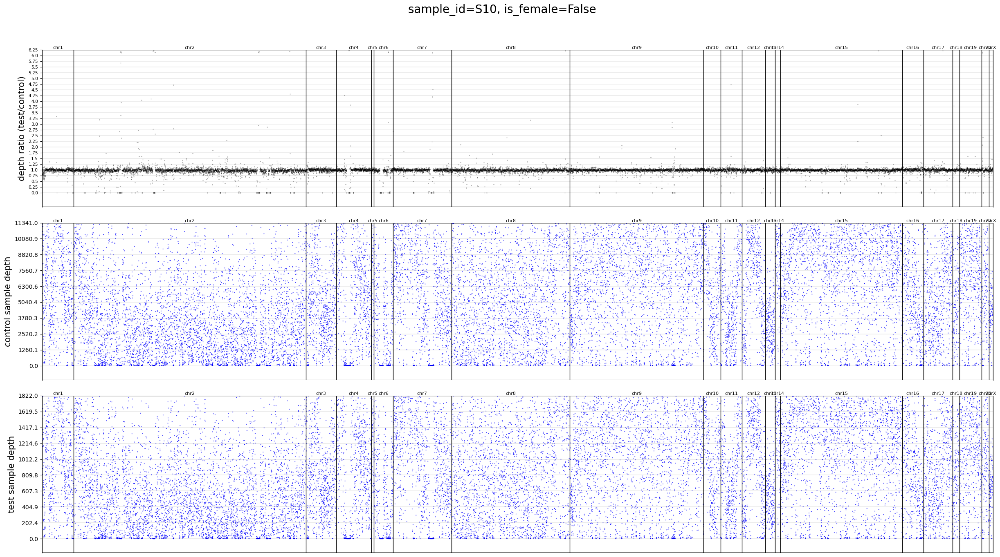

In [251]:
normal_panel_id = 'S10'

is_female = normal_panel_id in female_samples
normal_depth_df = MERGED_NORMAL_PANEL_DF['female' if is_female else 'male']
# normal_depth_df = MERGED_NORMAL_PANEL_DF['female']
tumor_depth_df = PANEL_DEPTH_DFS[normal_panel_id]

cnvplotter_panel.add_sample_file_new(
    sampleid=normal_panel_id,
    is_female=is_female,
    
    mode='panel',
    target_region=PANEL_REGION_GR.df,
    
    normal_depth_df=normal_depth_df,
    tumor_depth_df=tumor_depth_df,
)

cnvplotter_panel.postprocess_depth(normal_panel_id, verbose=False)
cnvplotter_panel.set_depthratio(normal_panel_id)

fig, axd = cnvplotter_panel.plot_custom(
    normal_panel_id,
    draw_depthratio=True,
    draw_normal_depth=True,
    draw_tumor_depth=True,
    
    depthratio_dot_kwargs=dict(alpha=0.8),
    normal_depth_dot_kwargs=dict(alpha=0.8),
    tumor_depth_dot_kwargs=dict(alpha=0.8),
    split_spines=True,
    
    depthratio_ylabel='depth ratio (test/control)',
    depthratio_ylabel_kwargs=dict(size=15),
    normal_depth_ylabel='control sample depth',
    normal_depth_ylabel_kwargs=dict(size=15),
    tumor_depth_ylabel='test sample depth',
    tumor_depth_ylabel_kwargs=dict(size=15),
    
    # title_y=0.95,
    # n_xlabel=50,
    # title=f'sampleid={sampleid}, is_female={cnvplotter_panel.data[sampleid]["is_female"]}, ',
)

### CNV caller establishment

#### hyeinwon test

In [19]:
cnvplotter = libgenomeplot.CNVPlotter(refver='hg19')

In [54]:
cpgmet_tsv_path = '/home/users/team_projects/hcolon_heterogeneity/01_LINE1/03_methylation/01_BAM/bismark/HC01/HC01_X_cpg.tsv'

In [55]:
cpgmet_df = pd.read_csv(cpgmet_tsv_path, sep='\t')

In [117]:
cpgmet_df['Chromosome'] = cpgmet_df['chrom']
cpgmet_df['Start'] = cpgmet_df['pos'] - 1
cpgmet_df['End'] = cpgmet_df['pos']

In [64]:
sampleid = 'HC01-08'
cpgmet_colname = f'tot_me_pct_{sampleid}_E'

In [43]:
bam_path = '/home/users/team_projects/colon_LINE1/02_bam/HC01-08.s.md.bam'

In [118]:
cpgmet_subdf = cpgmet_df.loc[cpgmet_df[cpgmet_colname].between(0, 1, inclusive='neither')]

In [45]:
cnvplotter.add_sample_file_new(sampleid=sampleid, is_female=False, tumor_bam_path=bam_path)

[KST 2023-06-27 22:28:34.027 genomeplot.depth_loading_helper] line 1180: Loading tumor depth - running mosdepth
[KST 2023-06-27 22:31:34.320 genomeplot.postprocess_depth] line 1329: Getting gc fraction dataframe
[KST 2023-06-27 22:31:48.200 genomeplot.postprocess_depth] line 1342: Beginning postprocess of tumor depth
[KST 2023-06-27 22:31:52] printlog: Adding GC fraction values
[KST 2023-06-27 22:32:15] printlog: Marking outlier positions
[KST 2023-06-27 22:32:23] printlog: Getting depth statistics stratified by gc ranges
[KST 2023-06-27 22:32:31] printlog: Getting normalized depths
[KST 2023-06-27 22:32:33] printlog: Getting GC-corrected normalized depths (sequenza style)
[KST 2023-06-27 22:32:34] printlog: Finished


In [ ]:
cnvplotter.reset_genomeplotter()

In [119]:
cnvplotter.reset_genomeplotter(chroms='X')
plotdata = cnvplotter.genomeplotter.prepare_plot_data(cpgmet_df)
plotdata['midpoint'] = 0.5 * (plotdata['Start'] + plotdata['End'] - 1)

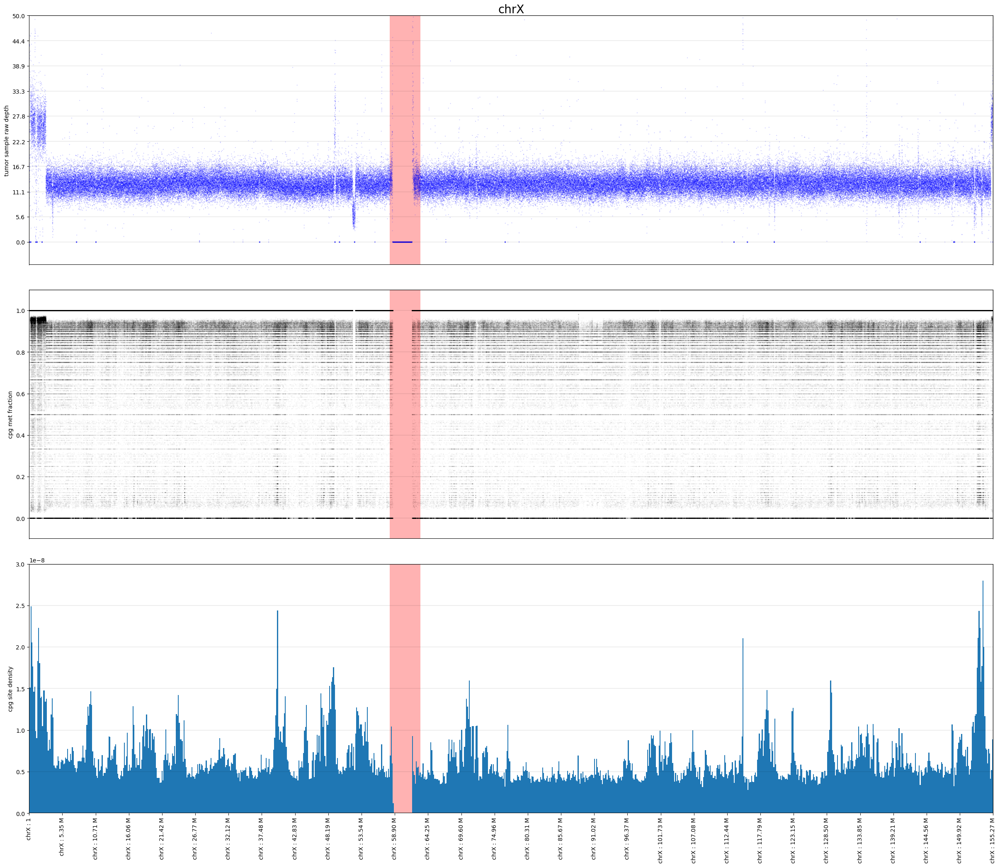

In [130]:
fig, axs = plt.subplots(3, 1, figsize=(30, 25), gridspec_kw=dict(hspace=0.1))


old_plotter = cnvplotter.genomeplotter
cnvplotter.reset_genomeplotter(chroms='X')

cnvplotter.draw_depth_ax(
    sampleid,
    axs[0],
    n_xlabel=None,
    is_tumor=True,
    is_rawdepth=True,
    ymax=50,
    chrom_text_kwargs=dict(size=20),
)

# cpg met pct
axs[1].set_ylim(-0.1, 1.1)
axs[1].set_yticks(np.arange(0, 1.1, 0.2))
axs[1].set_ylabel('cpg met fraction')

cnvplotter.genomeplotter.draw_dots(
    axs[1],
    y_colname=cpgmet_colname,
    df=cpgmet_df,
    plot_kwargs=dict(alpha=0.02, markersize=1),

)
cnvplotter.genomeplotter.draw_ax_common(
    axs[1],
    n_xlabel=None,
    draw_chrom_names=False,
)


# density
axs[2].set_ylim(0, 3e-8)
axs[2].set_ylabel('cpg site density')

cnvplotter.genomeplotter.draw_ax_common(
    axs[2],
    n_xlabel=30,
    draw_chrom_names=False,
)
_ = axs[2].hist(plotdata['midpoint'], bins=1000, density=True)

cnvplotter.genomeplotter = old_plotter

#### set params

In [17]:
WGS_GERMLINE_VCF_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/06_haplotypecaller/merged_vcfs/'
WGS_GERMLINE_VCF_PATHS = dict()
for fname in os.listdir(WGS_GERMLINE_VCF_TOPDIR):
    if fname.endswith('n_readstats.modest_depth.t_readstats.vcf.gz'):
        sid = fname.split('.')[0]
        WGS_GERMLINE_VCF_PATHS[sid] = os.path.join(WGS_GERMLINE_VCF_TOPDIR, fname)

PANEL_GERMLINE_VCF_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/20_haplotypecaller_panelbamonly/filtered_germline_hets'
PANEL_GERMLINE_VCF_PATHS = dict()
for fname in os.listdir(PANEL_GERMLINE_VCF_TOPDIR):
    if fname.endswith('vcf.gz'):
        sid = fname.split('.')[0]
        PANEL_GERMLINE_VCF_PATHS[sid] = os.path.join(PANEL_GERMLINE_VCF_TOPDIR, fname)
        
WGS_DEPTH_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/results/'
WGS_NORMAL_DEPTH_PATHS = dict()
WGS_TUMOR_DEPTH_PATHS = dict()
for top, dirs, files in os.walk(WGS_DEPTH_TOPDIR):
    for fname in files:
        if fname.endswith('regions.bed.gz'):
            sid = fname.split('.')[0]
            if 'normal' in fname:
                WGS_NORMAL_DEPTH_PATHS[sid] = os.path.join(top, fname)
            if 'tumor' in fname:
                WGS_TUMOR_DEPTH_PATHS[sid] = os.path.join(top, fname)
            

In [21]:
# sampleid = 'LU-F13'

# sampleid_normal = sampleid + '_normal'
# sampleid_tumor = sampleid + '_tumor'
# sampleid_panel = f'{sampleid}_panel'
# print(sampleid)

LU-F13


In [22]:
# wgs_normal_mosdepth_output_path = WGS_NORMAL_DEPTH_PATHS[sampleid]
# wgs_tumor_mosdepth_output_path = WGS_TUMOR_DEPTH_PATHS[sampleid]
# baf_vcf_path = WGS_GERMLINE_VCF_PATHS[sampleid]
# panel_germline_vcf_path = PANEL_GERMLINE_VCF_PATHS[sampleid]

In [15]:
# wgs_normal_mosdepth_output_path = f'/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/results/{sampleid}.normal/{sampleid}.normal.regions.bed.gz'
# wgs_tumor_mosdepth_output_path = f'/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/results/{sampleid}.tumor/{sampleid}.tumor.regions.bed.gz'
# # baf_vcf_path = f'/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/06_haplotypecaller/annotation_230126/{sampleid}.readstats.het_filtered.tumorannot.vcf.gz'
# baf_vcf_path = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/06_haplotypecaller/merged_vcfs/LU-F13.merged.vcf.gz.strip.n_readstats.filtered_het.t_readstats.vcf.gz'

In [329]:
# baf_df_path = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/06_haplotypecaller/merged_vcfs/LU-F13.merged.vcf.gz.strip.n_readstats.filtered_het.t_readstats.vcf.gz.vafdf.tsv.gz'

In [18]:
SAMPLEDATA_PATH_TOPDIR = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/28_cnv_new/mycnvcaller_data'
sampledata_path = os.path.join(SAMPLEDATA_PATH_TOPDIR, f'{sampleid}.cnvdata.pickle')

#### panel mode test

In [18]:
cnvplotter_panel = libgenomeplot.CNVPlotter(region_df=PANEL_REGION_GR.df, region_gaps=0)

In [19]:
sampleid = 'LU-F13'

sampleid_normal = sampleid + '_normal'
sampleid_tumor = sampleid + '_tumor'
sampleid_panel = f'{sampleid}_panel'
print(sampleid)

LU-F13


In [23]:
cnvplotter_panel.add_sample_file_new(
    sampleid=sampleid,
    is_female=IS_FEMALE[sampleid],
    
    germline_vcf_path=PANEL_GERMLINE_VCF_PATHS['LU-F13'],
    # germline_vafdf_path=baf_df_path,
    vcf_sampleid_tumor=sampleid_panel,
    # vcf_sampleid_normal=sampleid_normal,
    
    # normal_depth_path=wgs_normal_mosdepth_output_path,
    normal_depth_df=MERGED_NORMAL_PANEL_DF['female' if IS_FEMALE[sampleid] else 'male'],
    # tumor_depth_path=wgs_tumor_mosdepth_output_path,
    tumor_depth_df=PANEL_DEPTH_DFS[sampleid],
    
    vcfload_nproc=8,
    mode='panel',
    target_region=PANEL_REGION_GR.df,
)

[KST 2023-08-04 15:44:55.498 genomeplot.depth_loading_helper] line 1342: Loading normal depth - using the given depth dataframe
[KST 2023-08-04 15:44:55.525 genomeplot.depth_loading_helper] line 1342: Loading tumor depth - using the given depth dataframe
[KST 2023-08-04 15:44:55.836 genomeplot.add_sample_file_new] line 1400: Loading tumor germline vcf
[KST 2023-08-04 15:44:56] Downloading assembly_report file for reference version "NCBI34"
[KST 2023-08-04 15:44:57] Trying to open url 'https://ftp.ncbi.nlm.nih.gov/genomes/refseq/vertebrate_mammalian/Homo_sapiens/all_assembly_versions/GCF_000001405.10_NCBI34/GCF_000001405.10_NCBI34_assembly_report.txt'
[KST 2023-08-04 15:44:58] Succeeded to open url 'https://ftp.ncbi.nlm.nih.gov/genomes/refseq/vertebrate_mammalian/Homo_sapiens/all_assembly_versions/GCF_000001405.10_NCBI34/GCF_000001405.10_NCBI34_assembly_report.txt'
[KST 2023-08-04 15:44:58] Downloading assembly_report file for reference version "NCBI33"
[KST 2023-08-04 15:45:00] Trying 

Exception: Matches assembled chromosome lengths with more than one reference genomes(['GRCh37', 'GRCh37_1kg', 'GRCh37_hs37d5'])

In [24]:
vcf = pysam.VariantFile(PANEL_GERMLINE_VCF_PATHS['LU-F13'])

In [27]:
for x in vcf.header.contigs.values():
    print(x.name, x.length)

1 249250621
2 243199373
3 198022430
4 191154276
5 180915260
6 171115067
7 159138663
8 146364022
9 141213431
10 135534747
11 135006516
12 133851895
13 115169878
14 107349540
15 102531392
16 90354753
17 81195210
18 78077248
19 59128983
20 63025520
21 48129895
22 51304566
X 155270560
Y 59373566
MT 16569
GL000207.1 4262
GL000226.1 15008
GL000229.1 19913
GL000231.1 27386
GL000210.1 27682
GL000239.1 33824
GL000235.1 34474
GL000201.1 36148
GL000247.1 36422
GL000245.1 36651
GL000197.1 37175
GL000203.1 37498
GL000246.1 38154
GL000249.1 38502
GL000196.1 38914
GL000248.1 39786
GL000244.1 39929
GL000238.1 39939
GL000202.1 40103
GL000234.1 40531
GL000232.1 40652
GL000206.1 41001
GL000240.1 41933
GL000236.1 41934
GL000241.1 42152
GL000243.1 43341
GL000242.1 43523
GL000230.1 43691
GL000237.1 45867
GL000233.1 45941
GL000204.1 81310
GL000198.1 90085
GL000208.1 92689
GL000191.1 106433
GL000227.1 128374
GL000228.1 129120
GL000214.1 137718
GL000221.1 155397
GL000209.1 159169
GL000218.1 161147
GL000220.1 1

In [320]:
cnvplotter_panel.postprocess_depth(sampleid, verbose=True)

[KST 2023-06-11 16:41:21.487 genomeplot.postprocess_depth] line 1097: Beginning postprocess of normal depth
[KST 2023-06-11 16:41:21] printlog: Adding GC fraction values
[KST 2023-06-11 16:41:21] printlog: Marking outlier positions
[KST 2023-06-11 16:41:21] printlog: Getting depth statistics stratified by gc ranges
[KST 2023-06-11 16:41:21] printlog: Getting normalized depths
[KST 2023-06-11 16:41:21] printlog: Getting GC-corrected normalized depths (sequenza style)
[KST 2023-06-11 16:41:21] printlog: Finished
[KST 2023-06-11 16:41:21.656 genomeplot.postprocess_depth] line 1097: Beginning postprocess of tumor depth
[KST 2023-06-11 16:41:21] printlog: Adding GC fraction values
[KST 2023-06-11 16:41:21] printlog: Marking outlier positions
[KST 2023-06-11 16:41:21] printlog: Getting depth statistics stratified by gc ranges
[KST 2023-06-11 16:41:21] printlog: Getting normalized depths
[KST 2023-06-11 16:41:21] printlog: Getting GC-corrected normalized depths (sequenza style)
[KST 2023-06-1

In [321]:
cnvplotter_panel.set_depthratio(sampleid)
# cnvplotter.upscale_depthratio(sampleid, 1000)

In [288]:
cnvplotter_panel.make_segments(sampleid, verbose=True, segment_baf_cutoff=0.1, baf_gamma=None, baf_kmin=None, bw=1,)

[KST 2023-06-11 00:57:27.554 rcopynumber.make_merged_df] line 124: Adding chromosome arm information
[KST 2023-06-11 00:57:27.616 rcopynumber.make_merged_df] line 124: Adding chromosome arm information
[KST 2023-06-11 00:57:27.748 rcopynumber.make_merged_df] line 127: Removing rows with missing depth or arm information
[KST 2023-06-11 00:57:27.752 rcopynumber.run_rcopynumber] line 399: Making compact
[KST 2023-06-11 00:57:27.772 rcopynumber.make_merged_df] line 127: Removing rows with missing depth or arm information
[KST 2023-06-11 00:57:27.773 rcopynumber.run_rcopynumber] line 404: Writing dataframe into file for R-copynumber input
[KST 2023-06-11 00:57:27.774 rcopynumber.run_rcopynumber] line 399: Making compact
[KST 2023-06-11 00:57:27.777 rcopynumber.run_rcopynumber] line 404: Writing dataframe into file for R-copynumber input
[KST 2023-06-11 00:57:27.798 rcopynumber.run_rcopynumber] line 409: Running R-copynumber
[KST 2023-06-11 00:57:27.943 rcopynumber.run_rcopynumber] line 409:

pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chromosome arm 15q 
pcf finished for chromosome arm 16p 
pcf finished for chromosome arm 17p 
pcf finished for chromosome arm 17q 
pcf finished for chromosome arm 18q 
pcf finished for 

[KST 2023-06-11 00:57:31.404 rcopynumber.run_rcopynumber] line 428: Loading R-copynumber output


##### Plot data without cp

[KST 2023-06-11 16:46:30.117 genomeplot.plot_custom] line 1829: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-11 16:46:30.449 genomeplot.plot_custom] line 1850: Finished conversion of data coordinates into plot coordinates


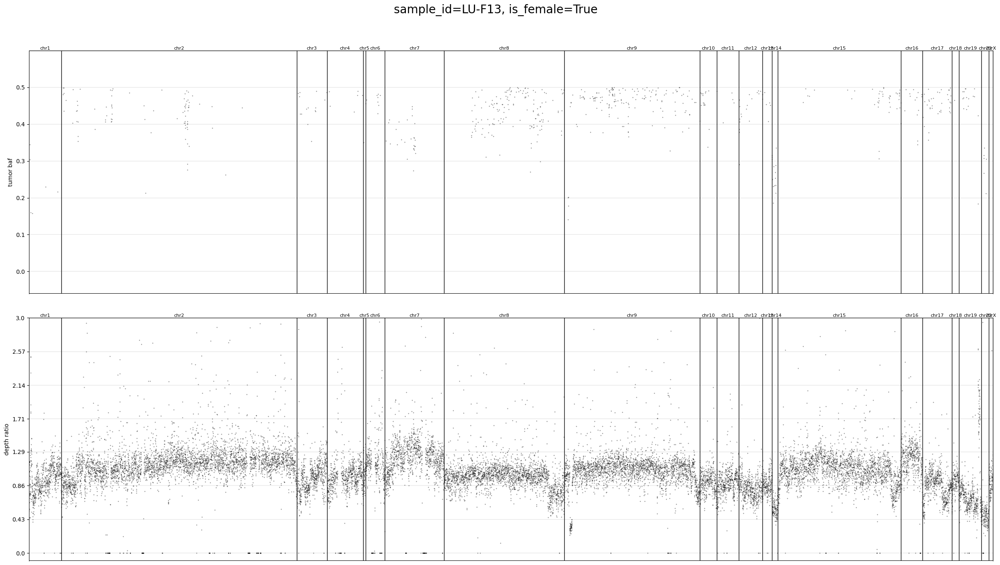

In [324]:
fig, axd = cnvplotter_panel.plot_custom(
    sampleid, 
    # figsize=(30, 20),
    # region_gaps=0,
    # region_chroms=['17',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=True,
    
    use_upscaled_depthratio=False,
    
    depthratio_ymax=3,
)

#### Normal sample CN calling

In [19]:
cnvplotter = libgenomeplot.CNVPlotter(refver='hg19')

In [20]:
# sampleid = 'LU-F13'
sampleid = 'LU-FF18'

sampleid_normal = sampleid + '_normal'
sampleid_tumor = sampleid + '_tumor'
sampleid_panel = f'{sampleid}_panel'
print(sampleid)

LU-FF18


In [21]:
wgs_normal_mosdepth_output_path = WGS_NORMAL_DEPTH_PATHS[sampleid]
wgs_tumor_mosdepth_output_path = WGS_TUMOR_DEPTH_PATHS[sampleid]
wgs_germline_vcf_path = WGS_GERMLINE_VCF_PATHS[sampleid]
panel_germline_vcf_path = PANEL_GERMLINE_VCF_PATHS[sampleid]

##### Load wgs data

In [22]:
cnvplotter.add_sample_file_new(
    sampleid=sampleid,
    is_female=IS_FEMALE[sampleid],
    
    germline_vcf_path=wgs_germline_vcf_path,
    # germline_vafdf_path=baf_df_path,
    vcf_sampleid_tumor=sampleid_tumor,
    vcf_sampleid_normal=sampleid_normal,
    
    normal_depth_path=wgs_normal_mosdepth_output_path,
    tumor_depth_path=wgs_tumor_mosdepth_output_path,
    
    vcfload_nproc=18,
    mode='wgs',
)

[KST 2023-07-10 22:06:09.601 genomeplot.depth_loading_helper] line 1325: Loading normal depth - reading mosdepth output file
[KST 2023-07-10 22:06:18.612 genomeplot.depth_loading_helper] line 1325: Loading tumor depth - reading mosdepth output file
[KST 2023-07-10 22:06:32.603 genomeplot.find_germline_copyneutral_region] line 3737: Running segmentation of normal bam depth in order to find copy-neutral region
[KST 2023-07-10 22:07:54.598 genomeplot.add_sample_file_new] line 1388: Loading tumor germline vcf
[KST 2023-07-10 22:07:54.785 variantplus.get_vafdf] line 1932: Extracting vcf position information
[KST 2023-07-10 22:08:33.288 variantplus.get_vafdf] line 1941: Running parallel jobs
[KST 2023-07-10 22:09:56.913 variantplus.get_vafdf] line 1948: Concatenating split job dataframes
[KST 2023-07-10 22:09:58.115 genomeplot.postprocess_depth] line 1458: Getting gc fraction dataframe
[KST 2023-07-10 22:10:10.492 genomeplot.postprocess_depth] line 1472: Beginning postprocess of normal depth

In [42]:
cnvplotter.set_depthratio(sampleid)
cnvplotter.upscale_depthratio(sampleid, 1000)

In [43]:
cnvplotter.upscale_depth(sampleid, 1000)

In [48]:
segdf = cnvmisc.make_normalsample_segment(cnvplotter.data[sampleid]['normal_depth_upscaled'], 'hg19', verbose=True)

[KST 2023-07-10 23:29:33.836 rcopynumber.make_merged_df] line 124: Adding chromosome arm information
[KST 2023-07-10 23:29:36.167 rcopynumber.make_merged_df] line 127: Removing rows with missing depth or arm information
[KST 2023-07-10 23:29:36.608 rcopynumber.run_rcopynumber] line 504: Writing dataframe into file for R-copynumber input
[KST 2023-07-10 23:30:02.087 rcopynumber.run_rcopynumber] line 509: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13p 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14p 
pcf finished for ch

[KST 2023-07-10 23:30:32.778 rcopynumber.run_rcopynumber] line 529: Loading R-copynumber output


pcf finished for chromosome arm Yq 


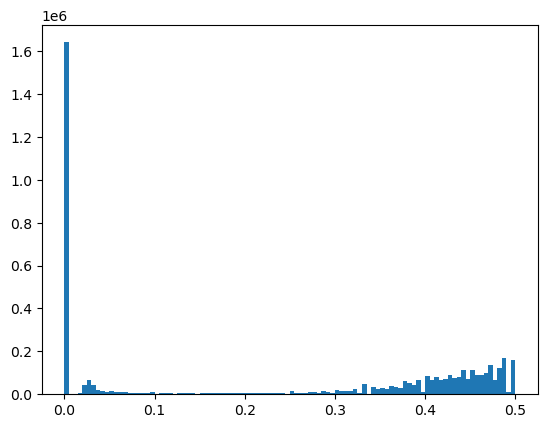

In [ ]:
_ = plt.hist(cnvplotter.data[sampleid]['original_baf']['baf_raw_normal'], bins=100)

In [99]:
seginput_baf_df = cnvplotter.data[sampleid]['original_baf'].loc[cnvplotter.data[sampleid]['original_baf']['baf_raw_normal'] > 0.1, :].copy()
seginput_baf_df.rename(columns={'baf_raw_normal': 'depth_raw'}, inplace=True)

baf_segdf, _ = rcopynumber.run_rcopynumber(
    depth_df=seginput_baf_df,
    refver='hg19',
    as_gr=False,
    winsorize=False,
    compact=False,
    verbose=True,
    remove_unassembled_contigs=True,
    gamma=50,
)

[KST 2023-07-11 16:03:08.716 rcopynumber.make_merged_df] line 124: Adding chromosome arm information
[KST 2023-07-11 16:03:10.853 rcopynumber.make_merged_df] line 127: Removing rows with missing depth or arm information
[KST 2023-07-11 16:03:11.198 rcopynumber.run_rcopynumber] line 459: Writing dataframe into file for R-copynumber input
[KST 2023-07-11 16:03:31.151 rcopynumber.run_rcopynumber] line 464: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chromosome arm 15q 
pcf finished for ch

[KST 2023-07-11 16:04:22.475 rcopynumber.run_rcopynumber] line 484: Loading R-copynumber output


In [57]:
MQ_df = cnvplotter.data[sampleid]['normal_depth'].loc[:, ['Chromosome', 'Start', 'End']].copy()

In [109]:
new_sid = 'LU-14'
sampledata_path = os.path.join(SAMPLEDATA_PATH_TOPDIR, f'{new_sid}.cnvdata.pickle')
cnvplotter.load_data(new_sid, sampledata_path)
cnvplotter.postprocess_depth(new_sid)
cnvplotter.upscale_depth(new_sid, binsize=1000, do_normal=True, do_tumor=False)

[KST 2023-07-11 16:27:47.337 genomeplot.postprocess_depth] line 1458: Getting gc fraction dataframe
[KST 2023-07-11 16:27:47.338 genomeplot.postprocess_depth] line 1472: Beginning postprocess of normal depth
[KST 2023-07-11 16:28:34.570 genomeplot.postprocess_depth] line 1472: Beginning postprocess of tumor depth


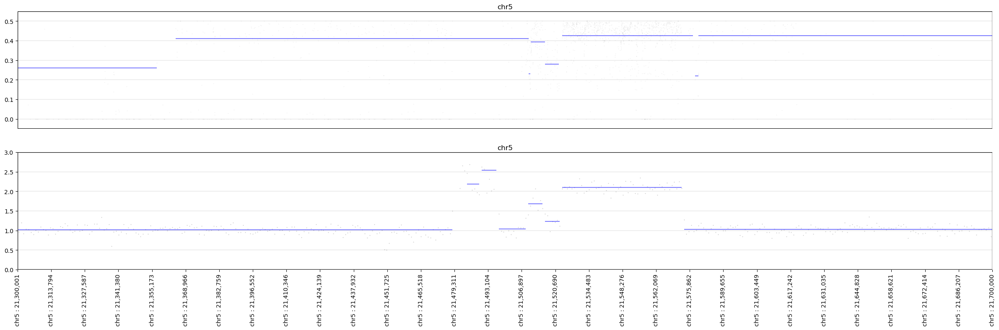

In [105]:
# gplotter = libgenomeplot.GenomePlotter(refver='hg19', chroms=['5'])
gplotter = libgenomeplot.GenomePlotter(refver='hg19', chroms='5', start0s=21_300_000, end0s=21_700_000)
fig, axd = plt.subplot_mosaic(
    [['baf'], ['depth']], 
    figsize=(30, 8),
)

axd['baf'].set_ylim(-0.05, 0.55)
gplotter.draw_dots(axd['baf'], df=cnvplotter.data[sampleid]['original_baf'], y_colname='baf_raw_normal', plot_kwargs=dict(markersize=0.5, alpha=0.05))
gplotter.draw_hlines(axd['baf'], df=baf_segdf, y_colname='depth_segment_mean', plot_kwargs=dict(color='blue', alpha=0.5))
gplotter.draw_ax_common(axd['baf'])

axd['depth'].set_ylim(0, 3)
gplotter.draw_dots(axd['depth'], df=cnvplotter.data[sampleid]['normal_depth_upscaled'], y_colname='norm_mean_depth', plot_kwargs=dict(markersize=0.5, alpha=0.2))
# gplotter.draw_dots(axd['depth'], df=cnvplotter.data[sampleid]['normal_depth'], y_colname='norm_mean_depth', plot_kwargs=dict(markersize=0.5, alpha=0.01))
gplotter.draw_hlines(axd['depth'], df=segdf, y_colname='depth_segment_mean', plot_kwargs=dict(color='blue', alpha=0.5))
gplotter.draw_ax_common(axd['depth'], n_xlabel=30)

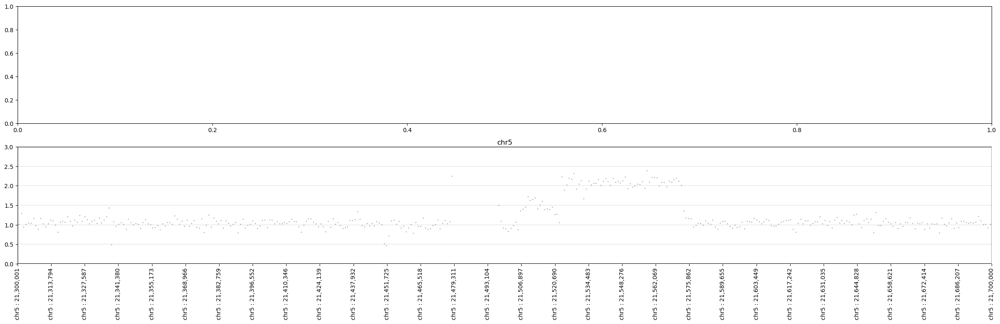

In [111]:
# gplotter = libgenomeplot.GenomePlotter(refver='hg19', chroms=['5'])
gplotter = libgenomeplot.GenomePlotter(refver='hg19', chroms='5', start0s=21_300_000, end0s=21_700_000)
fig, axd = plt.subplot_mosaic(
    [['baf'], ['depth']], 
    figsize=(30, 8),
)

# axd['baf'].set_ylim(-0.05, 0.55)
# gplotter.draw_dots(axd['baf'], df=cnvplotter.data[sampleid]['original_baf'], y_colname='baf_raw_normal', plot_kwargs=dict(markersize=0.5, alpha=0.05))
# gplotter.draw_hlines(axd['baf'], df=baf_segdf, y_colname='depth_segment_mean', plot_kwargs=dict(color='blue', alpha=0.5))
# gplotter.draw_ax_common(axd['baf'])

axd['depth'].set_ylim(0, 3)
gplotter.draw_dots(axd['depth'], df=cnvplotter.data[new_sid]['normal_depth_upscaled'], y_colname='norm_mean_depth', plot_kwargs=dict(markersize=0.5, alpha=0.5))
# gplotter.draw_dots(axd['depth'], df=cnvplotter.data[sampleid]['normal_depth'], y_colname='norm_mean_depth', plot_kwargs=dict(markersize=0.5, alpha=0.01))
# gplotter.draw_hlines(axd['depth'], df=segdf, y_colname='depth_segment_mean', plot_kwargs=dict(color='blue', alpha=0.5))
gplotter.draw_ax_common(axd['depth'], n_xlabel=30)

In [74]:
igv.load([BAM_PATHS['normal'][sampleid]])

OK


In [106]:
igv.goto([('5', 21_575_862, 21_575_862)])

OK


#### Main analysis

In [18]:
cnvplotter = libgenomeplot.CNVPlotter(refver='hg19')

In [197]:
# sampleid = 'LU-F13'
sampleid = 'LU-FF18'

sampleid_normal = sampleid + '_normal'
sampleid_tumor = sampleid + '_tumor'
sampleid_panel = f'{sampleid}_panel'

sampleid_seqz = sampleid + '_seqz'
sampleid_panel_seqz = sampleid_panel + '_seqz'

print(sampleid)

LU-FF18


In [20]:
wgs_normal_mosdepth_output_path = WGS_NORMAL_DEPTH_PATHS[sampleid]
wgs_tumor_mosdepth_output_path = WGS_TUMOR_DEPTH_PATHS[sampleid]
wgs_germline_vcf_path = WGS_GERMLINE_VCF_PATHS[sampleid]
panel_germline_vcf_path = PANEL_GERMLINE_VCF_PATHS[sampleid]

##### Load panel data

In [59]:
cnvplotter.add_sample_file_new(
    sampleid=sampleid_panel,
    is_female=IS_FEMALE[sampleid],
    
    germline_vcf_path=panel_germline_vcf_path,
    # germline_vafdf_path=baf_df_path,
    vcf_sampleid_tumor=sampleid_panel,
    # vcf_sampleid_normal=sampleid_normal,
    
    # normal_depth_path=wgs_normal_mosdepth_output_path,
    normal_depth_df=MERGED_NORMAL_PANEL_DF['female' if IS_FEMALE[sampleid] else 'male'],
    # tumor_depth_path=wgs_tumor_mosdepth_output_path,
    tumor_depth_df=PANEL_DEPTH_DFS[sampleid],
    
    vcfload_nproc=8,
    mode='panel',
    target_region=PANEL_REGION_GR.df,
    
    norm_method='plain',
)

[KST 2023-07-14 04:07:44.153 genomeplot.depth_loading_helper] line 1332: Loading normal depth - using the given depth dataframe
[KST 2023-07-14 04:07:44.154 genomeplot.depth_loading_helper] line 1332: Loading tumor depth - using the given depth dataframe
[KST 2023-07-14 04:07:45.103 genomeplot.add_sample_file_new] line 1390: Loading tumor germline vcf
[KST 2023-07-14 04:07:45.493 variantplus.get_vafdf] line 1932: Extracting vcf position information
[KST 2023-07-14 04:07:45.535 variantplus.get_vafdf] line 1941: Running parallel jobs
[KST 2023-07-14 04:07:46.881 variantplus.get_vafdf] line 1948: Concatenating split job dataframes
[KST 2023-07-14 04:07:47.128 genomeplot.postprocess_depth] line 1477: Beginning postprocess of normal depth
[KST 2023-07-14 04:07:47] printlog: Marking outlier positions
[KST 2023-07-14 04:07:47] printlog: Getting normalized depths
[KST 2023-07-14 04:07:47] printlog: Finished
[KST 2023-07-14 04:07:47.232 genomeplot.postprocess_depth] line 1477: Beginning postpro

In [61]:
cnvplotter.set_depthratio(sampleid_panel)
# cnvplotter.upscale_depthratio(sampleid, 1000)

In [250]:
cnvplotter.make_segments(sampleid_panel)

##### Load wgs data

In [62]:
cnvplotter.add_sample_file_new(
    sampleid=sampleid,
    is_female=IS_FEMALE[sampleid],
    
    germline_vcf_path=wgs_germline_vcf_path,
    # germline_vafdf_path=baf_df_path,
    vcf_sampleid_tumor=sampleid_tumor,
    vcf_sampleid_normal=sampleid_normal,
    
    normal_depth_path=wgs_normal_mosdepth_output_path,
    tumor_depth_path=wgs_tumor_mosdepth_output_path,
    
    vcfload_nproc=18,
    mode='wgs',
    
    norm_method='plain',
)

[KST 2023-07-14 04:11:46.701 genomeplot.depth_loading_helper] line 1327: Loading normal depth - reading mosdepth output file
[KST 2023-07-14 04:11:55.270 genomeplot.depth_loading_helper] line 1327: Loading tumor depth - reading mosdepth output file
[KST 2023-07-14 04:12:09.020 genomeplot.find_germline_copyneutral_region] line 3607: Running segmentation of normal bam depth in order to find copy-neutral region
[KST 2023-07-14 04:13:19.193 genomeplot.add_sample_file_new] line 1390: Loading tumor germline vcf
[KST 2023-07-14 04:13:19.452 variantplus.get_vafdf] line 1932: Extracting vcf position information
[KST 2023-07-14 04:13:56.087 variantplus.get_vafdf] line 1941: Running parallel jobs
[KST 2023-07-14 04:15:05.648 variantplus.get_vafdf] line 1948: Concatenating split job dataframes
[KST 2023-07-14 04:15:06.963 genomeplot.postprocess_depth] line 1477: Beginning postprocess of normal depth
[KST 2023-07-14 04:15:07] printlog: Marking outlier positions
[KST 2023-07-14 04:15:16] printlog: G

In [194]:
cnvplotter.set_depthratio(sampleid)
cnvplotter.upscale_depthratio(sampleid, 1000)
cnvplotter.upscale_depth(sampleid, 1000)

In [195]:
cnvplotter.make_segments(sampleid)

##### Load wgs data with seqz style

In [199]:
cnvplotter.add_sample_file_new(
    sampleid=sampleid_seqz,
    is_female=IS_FEMALE[sampleid],
    
    germline_vcf_path=wgs_germline_vcf_path,
    # germline_vafdf_path=baf_df_path,
    vcf_sampleid_tumor=sampleid_tumor,
    vcf_sampleid_normal=sampleid_normal,
    
    normal_depth_path=wgs_normal_mosdepth_output_path,
    tumor_depth_path=wgs_tumor_mosdepth_output_path,
    
    vcfload_nproc=18,
    mode='wgs',
    
    norm_method='sequenza',
)

[KST 2023-07-14 07:23:42.562 genomeplot.depth_loading_helper] line 1333: Loading normal depth - reading mosdepth output file
[KST 2023-07-14 07:23:50.852 genomeplot.depth_loading_helper] line 1333: Loading tumor depth - reading mosdepth output file
[KST 2023-07-14 07:24:04.065 genomeplot.find_germline_copyneutral_region] line 3662: Running segmentation of normal bam depth in order to find copy-neutral region
[KST 2023-07-14 07:25:10.290 genomeplot.add_sample_file_new] line 1396: Loading tumor germline vcf
[KST 2023-07-14 07:25:10.359 variantplus.get_vafdf] line 1932: Extracting vcf position information
[KST 2023-07-14 07:25:46.632 variantplus.get_vafdf] line 1941: Running parallel jobs
[KST 2023-07-14 07:27:01.109 variantplus.get_vafdf] line 1948: Concatenating split job dataframes
[KST 2023-07-14 07:27:02.897 genomeplot.postprocess_depth] line 1469: Getting gc fraction dataframe
[KST 2023-07-14 07:27:02.898 genomeplot.postprocess_depth] line 1483: Beginning postprocess of normal depth

In [203]:
cnvplotter.set_depthratio(sampleid_seqz)
cnvplotter.upscale_depthratio(sampleid_seqz, 1000)
cnvplotter.upscale_depth(sampleid_seqz, 1000)

In [204]:
cnvplotter.make_segments(sampleid_seqz)

##### plot & find solution - WGS

[KST 2023-07-14 07:00:39.092 genomeplot.plot_beforecp] line 1719: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 07:00:44.256 genomeplot.plot_beforecp] line 1723: Finished conversion of data coordinates into plot coordinates


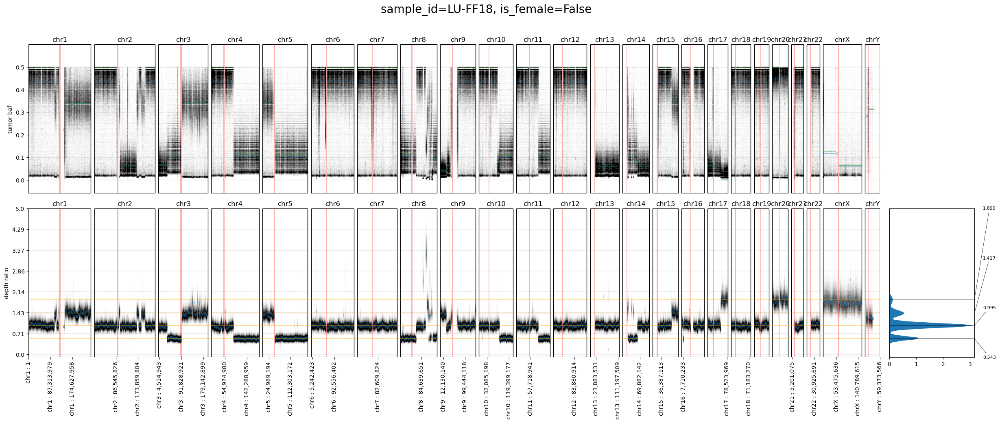

In [196]:
fig, axd = cnvplotter.plot_beforecp(
    sampleid, 
    # figsize=(30, 20),
    # hspace=0.5,
    # region_gaps=0,
    # region_chroms=['17',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 
    
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    # baf_line_segmean_kwargs=dict(alpha=0.8),
    # depth_dot_kwargs=dict(alpha=0.4),
    # use_merged_segment=True,
    
    draw_upscaled_depthratio=True,
    draw_depth=False,
    # is_rawdepth=True,
    # depth_binsize=None,
    
    depthratio_hist_bw=0.1,
    depthratio_hist_threshold=0.1,
    
    # depthratio_ymax=6,
    # depth_ymax=300,
    n_xlabel=40,
    
    depthratio_dot_kwargs=dict(alpha=0.01),
    
    depthratio_ymax=5,
)

[KST 2023-07-14 08:22:32.456 genomeplot.plot_beforecp] line 1719: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 08:22:38.079 genomeplot.plot_beforecp] line 1723: Finished conversion of data coordinates into plot coordinates


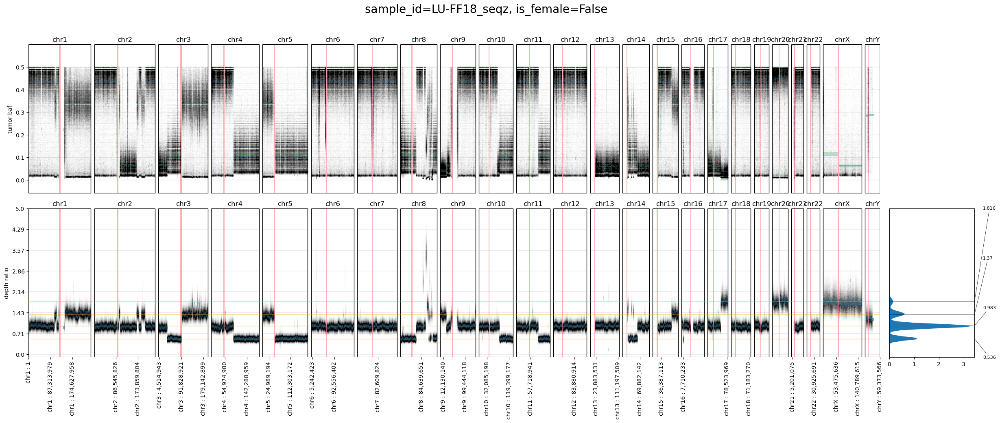

In [205]:
fig, axd = cnvplotter.plot_beforecp(
    sampleid_seqz, 
    # figsize=(30, 20),
    # hspace=0.5,
    # region_gaps=0,
    # region_chroms=['17',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 
    
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    # baf_line_segmean_kwargs=dict(alpha=0.8),
    # depth_dot_kwargs=dict(alpha=0.4),
    # use_merged_segment=True,
    
    draw_upscaled_depthratio=True,
    draw_depth=False,
    # is_rawdepth=True,
    # depth_binsize=None,
    
    depthratio_hist_bw=0.1,
    depthratio_hist_threshold=0.1,
    
    # depthratio_ymax=6,
    # depth_ymax=300,
    n_xlabel=40,
    
    depthratio_dot_kwargs=dict(alpha=0.01),
    
    depthratio_ymax=5,
)

In [304]:
cellularity, ploidy = cnvmisc.get_cp_from_twodata(
    depthratio1=0.995, 
    CNt1=2, 
    depthratio2=0.543, 
    CNt2=1, 
    normal_ploidy=cnvplotter.data[sampleid]['normal_mean_ploidy'],
    CNn=2,
)

In [305]:
cellularity, ploidy

(0.9085427135678529, 2.0108508171764004)

[KST 2023-07-14 09:32:53.225 genomeplot.plot_aftercp_freeccf] line 1856: Beginning calculation of subclonal solution
[KST 2023-07-14 09:32:53.238 genomeplot.plot_aftercp_freeccf] line 1869: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 09:32:58.475 genomeplot.plot_aftercp_freeccf] line 1873: Finished conversion of data coordinates into plot coordinates


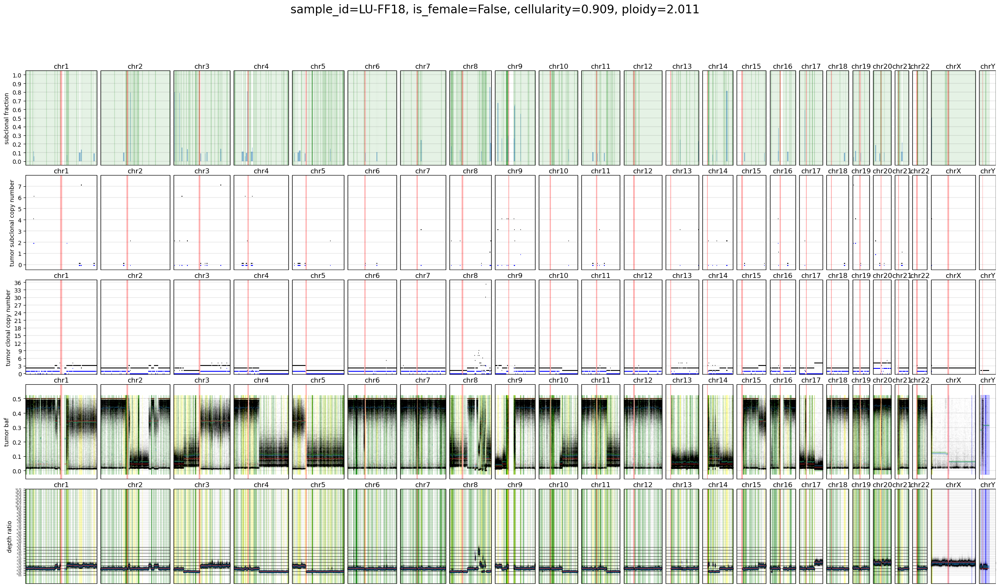

In [228]:
fig, axd = cnvplotter.plot_aftercp_freeccf(sampleid, cellularity, ploidy)

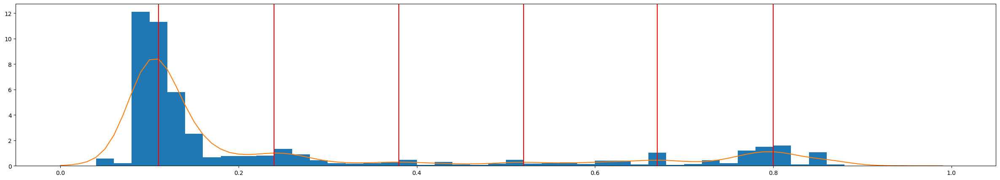

In [231]:
cnvplotter.show_ccfs(sampleid)

In [232]:
print(cnvplotter.data[sampleid]['fixed_ccfs'])

[0.11 0.8 ]


[KST 2023-07-14 09:49:58.029 genomeplot.plot_aftercp_fixedccf] line 2050: Beginning calculation of subclonal solution
[KST 2023-07-14 09:49:58.039 genomeplot.plot_aftercp_fixedccf] line 2061: Finished calculation of subclonal solution
[KST 2023-07-14 09:49:58.040 genomeplot.plot_aftercp_fixedccf] line 2063: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 09:50:03.070 genomeplot.plot_aftercp_fixedccf] line 2070: Finished conversion of data coordinates into plot coordinates


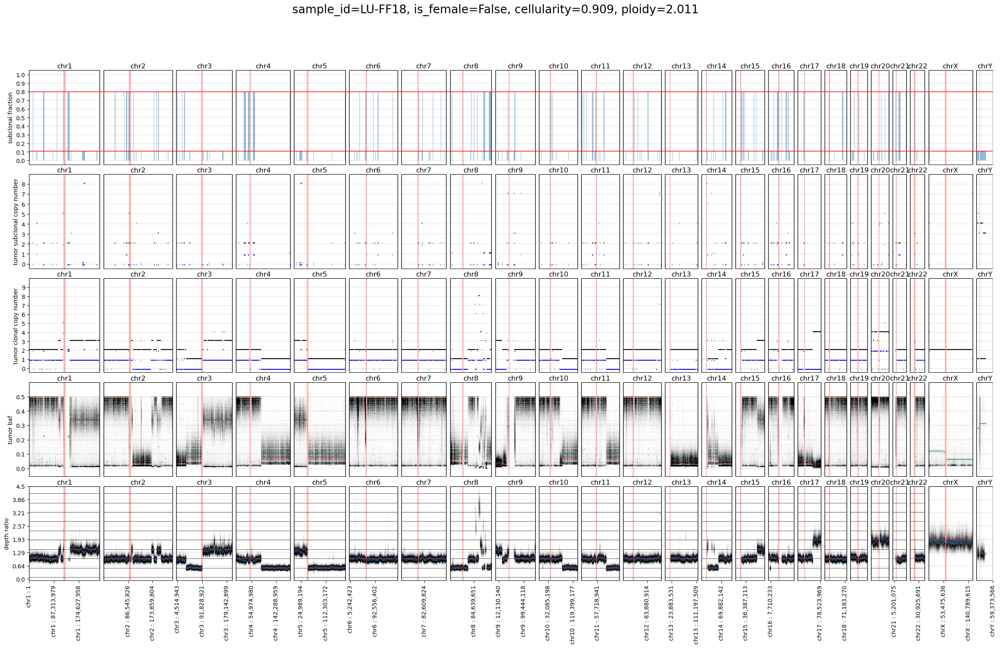

In [241]:
fig, axd = cnvplotter.plot_aftercp_fixedccf(
    sampleid, cellularity, ploidy,
    
    # region_chroms=['21', '22',],
    # region_start0s=[19_000_000, 19_000_000],
    # region_end0s=[23_000_000, 23_000_000],
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    
    # CNt_diff_factor=0.01,
    
    # figsize=(30, 50),
    # CN_ymax=10,
    # subCN_ymax=5,
    
    n_xlabel=40,
    # mark_unfit_regions=False,
    
    depthratio_ymax=4.5,
    CN_ymax=10,
    
    baf_dot_kwargs=dict(alpha=0.01),
)

In [236]:
cnvplotter.data[sampleid]['merged_segment']

,Chromosome,Start,End,depthratio_segment_mean,depthratio_segment_std,depthratio_segment_std_mean_ratio,baf_segment_mean,baf_segment_peak,left_rowidxs,CNn,...,baf_predicted_clonal,depthratio_fit,baf_fit,polyploid_unfit,monoploid_unfit,polyploid_unfit_bafonly,clonal_A,subclonal_A,depthratio_predicted,baf_predicted
0,1,9499,13500,2.9138,3.219935,1.105064,0.2913,0.230964,0.0,2.0,...,0.177488,True,False,False,False,True,3.0,5.0,2.80300,0.241991
1,1,14499,40499,1.4088,0.130280,0.092476,0.2913,0.230964,1.0,2.0,...,0.343815,True,False,False,False,True,0.0,3.0,1.44700,0.218867
2,1,40499,227499,1.1639,0.145155,0.124714,0.2913,0.230964,2.0,2.0,...,0.045729,False,False,True,False,False,1.0,2.0,1.08540,0.208495
3,1,227499,241499,1.6678,0.144414,0.086589,0.2913,0.230964,3.0,2.0,...,0.343815,False,False,True,False,False,3.0,0.0,1.70012,0.263381
4,1,241499,317499,1.3752,0.149118,0.108434,0.2913,0.230964,4.0,2.0,...,0.343815,True,False,False,False,True,0.0,3.0,1.44700,0.218867
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5977,Y,22495499,22501500,2.4550,1.261994,0.514050,0.3244,0.313100,16.0,1.0,...,NaN,True,False,False,False,False,NaN,NaN,2.80300,NaN
5978,Y,22502499,23195500,1.2991,0.243652,0.187555,0.3244,0.313100,17.0,1.0,...,NaN,False,False,False,True,False,NaN,NaN,1.29332,NaN
5979,Y,23196499,34664500,1.2237,0.221712,0.181182,0.3244,0.313100,18.0,1.0,...,NaN,False,False,False,True,False,NaN,NaN,1.19388,NaN
5980,Y,58819499,58917500,1.8263,0.086692,0.047469,0.3244,0.313100,19.0,1.0,...,NaN,True,False,False,False,False,NaN,NaN,1.89900,NaN


##### plot & find solution - TPS

[KST 2023-07-14 10:02:16.856 genomeplot.plot_beforecp] line 1719: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 10:02:17.197 genomeplot.plot_beforecp] line 1723: Finished conversion of data coordinates into plot coordinates


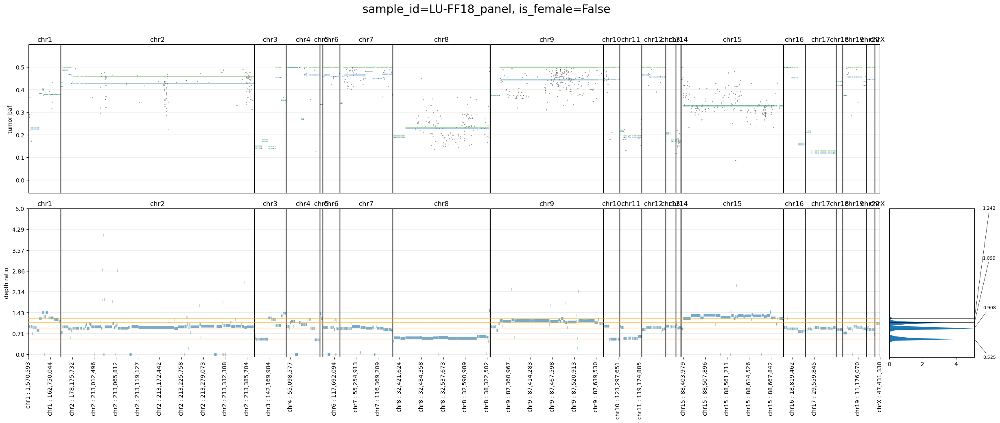

In [251]:
cnvplotter.reset_genomeplotter(region_df=cnvplotter.data[sampleid_panel]['target_region'])

fig, axd = cnvplotter.plot_beforecp(
    sampleid_panel, 
    # figsize=(30, 20),
    # hspace=0.5,
    # region_gaps=0,
    # region_chroms=['17',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 
    
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    # baf_line_segmean_kwargs=dict(alpha=0.8),
    # depth_dot_kwargs=dict(alpha=0.4),
    # use_merged_segment=True,
    
    draw_upscaled_depthratio=False,
    draw_upscaled_depth=False,
    draw_depth=False,
    # is_rawdepth=True,
    # depth_binsize=None,
    
    depthratio_hist_bw=0.1,
    depthratio_hist_threshold=0.1,
    
    # depthratio_ymax=6,
    # depth_ymax=300,
    n_xlabel=40,
    
    depthratio_dot_kwargs=dict(alpha=0.01),
    
    depthratio_ymax=5,
)

cnvplotter.reset_genomeplotter()

In [300]:
tps_cellularity, tps_ploidy = cnvmisc.get_cp_from_twodata(
    depthratio1=0.908, 
    CNt1=2, 
    depthratio2=0.525, 
    CNt2=1, 
    normal_ploidy=cnvplotter.data[sampleid_panel]['normal_mean_ploidy'],
    CNn=2,
)

In [301]:
tps_cellularity, tps_ploidy

(0.8436123348017625, 2.2353285319392384)

[KST 2023-07-14 10:37:28.416 genomeplot.plot_aftercp_freeccf] line 1857: Beginning calculation of subclonal solution
[KST 2023-07-14 10:37:28.428 genomeplot.plot_aftercp_freeccf] line 1870: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 10:37:28.861 genomeplot.plot_aftercp_freeccf] line 1874: Finished conversion of data coordinates into plot coordinates


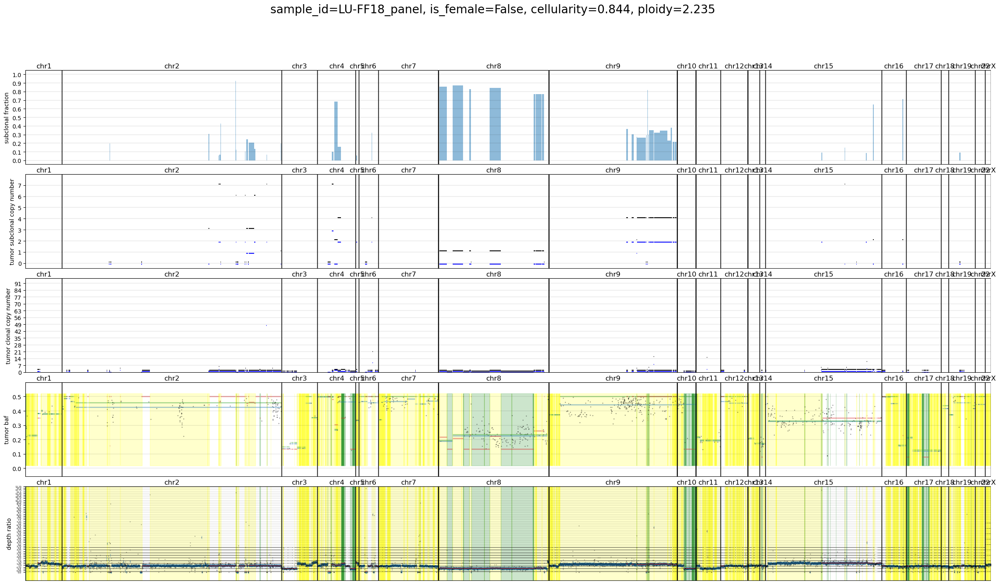

In [302]:
cnvplotter.reset_genomeplotter(region_df=cnvplotter.data[sampleid_panel]['target_region'])

fig, axd = cnvplotter.plot_aftercp_freeccf(
    sampleid_panel, tps_cellularity, tps_ploidy,
    draw_upscaled_depthratio=False,
    draw_upscaled_depth=False,
)

cnvplotter.reset_genomeplotter()

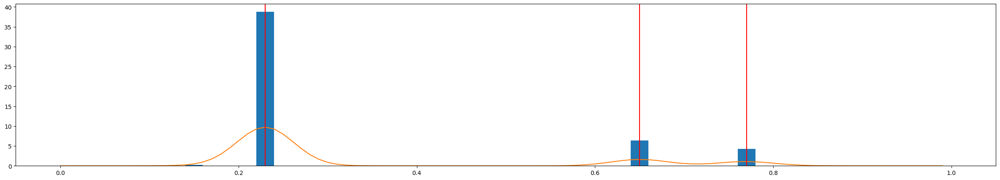

In [259]:
cnvplotter.show_ccfs(sampleid_panel)

In [260]:
print(cnvplotter.data[sampleid_panel]['fixed_ccfs'])

[0.23 0.65]


[KST 2023-07-14 10:37:54.277 genomeplot.plot_aftercp_fixedccf] line 2051: Beginning calculation of subclonal solution
[KST 2023-07-14 10:37:54.283 genomeplot.plot_aftercp_fixedccf] line 2062: Finished calculation of subclonal solution
[KST 2023-07-14 10:37:54.283 genomeplot.plot_aftercp_fixedccf] line 2064: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 10:37:54.650 genomeplot.plot_aftercp_fixedccf] line 2071: Finished conversion of data coordinates into plot coordinates


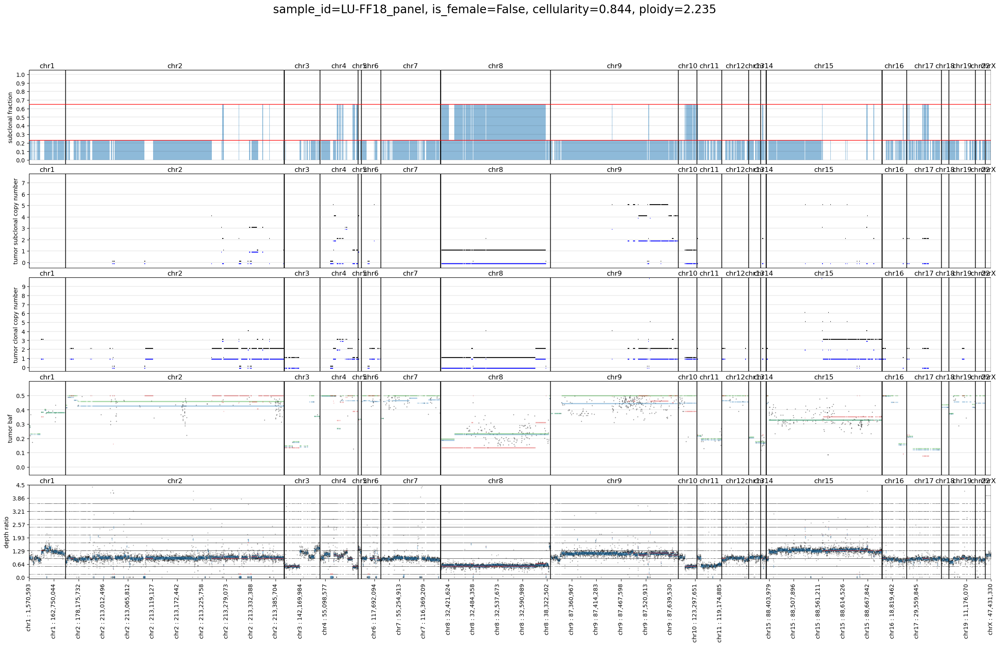

In [303]:
cnvplotter.reset_genomeplotter(region_df=cnvplotter.data[sampleid_panel]['target_region'])

fig, axd = cnvplotter.plot_aftercp_fixedccf(
    sampleid_panel, tps_cellularity, tps_ploidy,
    
    # region_chroms=['21', '22',],
    # region_start0s=[19_000_000, 19_000_000],
    # region_end0s=[23_000_000, 23_000_000],
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    
    # CNt_diff_factor=0.01,
    
    # figsize=(30, 50),
    # CN_ymax=10,
    # subCN_ymax=5,
    
    draw_upscaled_depthratio=False,
    draw_upscaled_depth=False,
    
    n_xlabel=40,
    # mark_unfit_regions=False,
    
    depthratio_ymax=4.5,
    CN_ymax=10,
    
    # baf_dot_kwargs=dict(alpha=0.01),
)

cnvplotter.reset_genomeplotter()

In [289]:
wgs_segment = pr.PyRanges(cnvplotter.data[sampleid]['merged_segment'])
tps_segment = pr.PyRanges(cnvplotter.data[sampleid_panel]['merged_segment'])

In [290]:
right_gr = tps_segment[['clonal_B', 'clonal_CNt']]
right_df = right_gr.df.rename(columns={'clonal_B': 'tps_clonal_B', 'clonal_CNt': 'tps_clonal_CNt'})
wgs_join_tps = pyranges_helper.join(wgs_segment, right_df, how='left', as_gr=True, sort=True, refver='hg19')
wgs_join_tps = wgs_join_tps[wgs_join_tps.tps_clonal_B.notna()]
wgs_join_tps = wgs_join_tps[wgs_join_tps.tps_clonal_CNt.notna()]

In [297]:
tps_loh_sn = (wgs_join_tps[wgs_join_tps.clonal_B == 0].tps_clonal_B == 0).mean()
tps_loh_sp = (wgs_join_tps[wgs_join_tps.clonal_B > 0].tps_clonal_B > 0).mean()

tps_amp_sn = (wgs_join_tps[wgs_join_tps.clonal_CNt >= 3].tps_clonal_CNt >= 3).mean()
tps_amp_sp = (wgs_join_tps[wgs_join_tps.clonal_CNt < 3].tps_clonal_CNt < 3).mean()

In [299]:
print('TPS Sn of capturing LOH:', tps_loh_sn)
print('TPS Sp of capturing LOH:', tps_loh_sp)
print('TPS Sn of capturing amp:', tps_amp_sn)
print('TPS Sp of capturing amp:', tps_amp_sp)

TPS Sn of capturing LOH: 0.341991341991342
TPS Sp of capturing LOH: 0.8656036446469249
TPS Sn of capturing amp: 0.7017543859649122
TPS Sp of capturing amp: 0.8345323741007195


In [306]:
print('WGS cellularity:', cellularity)
print('WGS ploidy:', ploidy)
print('TPS cellularity:', tps_cellularity)
print('TPS_WGS ploidy:', tps_ploidy)

WGS cellularity: 0.9085427135678529
WGS ploidy: 2.0108508171764004
TPS cellularity: 0.8436123348017625
TPS_WGS ploidy: 2.2353285319392384


In [307]:
import handygenome.analysis.feature as libfeature

In [311]:
myc_coord_gr = libfeature.get_gene_coords_gr(['MYC'], 'hg19')

[KST 2023-07-14 10:58:13] Trying to open url 'http://grch37.rest.ensembl.org/lookup/symbol/homo_sapiens?expand=0'
[KST 2023-07-14 10:58:14] Succeeded to open url 'http://grch37.rest.ensembl.org/lookup/symbol/homo_sapiens?expand=0'


In [338]:
tps_segment.intersect(myc_coord_gr)

,Chromosome,Start,End,depthratio_segment_mean,depthratio_segment_std,depthratio_segment_std_mean_ratio,baf_segment_mean,baf_segment_peak,left_rowidxs,CNn,...,baf_predicted_clonal,depthratio_fit,baf_fit,polyploid_unfit,monoploid_unfit,polyploid_unfit_bafonly,clonal_A,subclonal_A,depthratio_predicted,baf_predicted
0,8,128747718,128747719,4.9888,0.000000,0.00000,0.48,0.48,NaN,NaN,...,NaN,False,False,True,False,False,NaN,NaN,NaN,NaN
1,8,128747818,128747819,4.9582,0.000000,0.00000,0.48,0.48,NaN,NaN,...,NaN,False,False,True,False,False,NaN,NaN,NaN,NaN
2,8,128747918,128753581,1.5094,0.119348,0.07907,0.48,0.48,NaN,NaN,...,NaN,False,False,True,False,False,NaN,NaN,NaN,NaN
3,8,128753660,128753661,1.0429,0.000000,0.00000,0.48,0.48,NaN,NaN,...,NaN,False,False,True,False,False,NaN,NaN,NaN,NaN


In [336]:
tps_segment.intersect(myc_coord_gr).columns

Index(['Chromosome', 'Start', 'End', 'depthratio_segment_mean',
       'depthratio_segment_std', 'depthratio_segment_std_mean_ratio',
       'baf_segment_mean', 'baf_segment_peak', 'left_rowidxs', 'CNn',
       'overlap_length', 'corrected_baf_segment_mean', 'clonal_CNt',
       'clonal_B', 'subclonal_CNt', 'subclonal_B', 'ccf',
       'depthratio_predicted_clonal', 'baf_predicted_clonal', 'depthratio_fit',
       'baf_fit', 'polyploid_unfit', 'monoploid_unfit',
       'polyploid_unfit_bafonly', 'clonal_A', 'subclonal_A',
       'depthratio_predicted', 'baf_predicted'],
      dtype='object')

In [322]:
chr8_gr = CHROMDICT_HG19.to_gr()['8']
no_myc = chr8_gr.subtract(myc_coord_gr)
no_myc.weight = 1
myc_gr = myc_coord_gr.copy()
myc_gr.weight = 50000
zoomin_gr = pr.concat([no_myc, myc_gr]).sort()

In [323]:
zoomin_gr

,Chromosome,Start,End,weight,gene_name
0,8,0,128747679,1,NaN
1,8,128747679,128753674,50000,MYC
2,8,128753674,146364022,1,NaN


[KST 2023-07-14 11:07:52.758 genomeplot.plot_aftercp_fixedccf] line 2053: Beginning calculation of subclonal solution
[KST 2023-07-14 11:07:52.766 genomeplot.plot_aftercp_fixedccf] line 2064: Finished calculation of subclonal solution
[KST 2023-07-14 11:07:52.766 genomeplot.plot_aftercp_fixedccf] line 2066: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 11:07:52.819 genomeplot.plot_aftercp_fixedccf] line 2073: Finished conversion of data coordinates into plot coordinates
/home/users/pjh/tools/miniconda/221104/miniconda3/envs/genome_v7/lib/python3.10/site-packages/matplotlib/axes/_base.py:2539: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


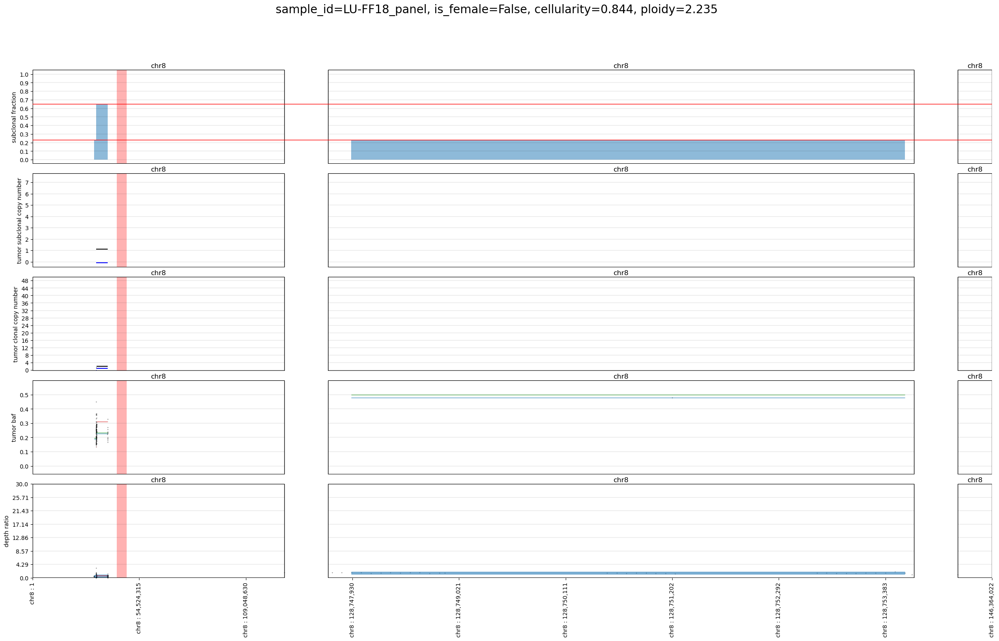

In [333]:
cnvplotter.reset_genomeplotter(region_df=zoomin_gr, region_gaps=0.1, )

fig, axd = cnvplotter.plot_aftercp_fixedccf(
    sampleid_panel, tps_cellularity, tps_ploidy,
    
    # region_chroms=['21', '22',],
    # region_start0s=[19_000_000, 19_000_000],
    # region_end0s=[23_000_000, 23_000_000],
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    
    # CNt_diff_factor=0.01,
    
    # figsize=(30, 50),
    # CN_ymax=10,
    # subCN_ymax=5,
    
    draw_upscaled_depthratio=False,
    draw_upscaled_depth=False,
    
    n_xlabel=10,
    # mark_unfit_regions=False,
    
    depthratio_ymax=30,
    CN_ymax=50,
    
    # baf_dot_kwargs=dict(alpha=0.01),
    merge_same_chroms=False,
)

cnvplotter.reset_genomeplotter()

[KST 2023-07-14 11:07:18.734 genomeplot.plot_aftercp_fixedccf] line 2053: Beginning calculation of subclonal solution
[KST 2023-07-14 11:07:18.745 genomeplot.plot_aftercp_fixedccf] line 2064: Finished calculation of subclonal solution
[KST 2023-07-14 11:07:18.746 genomeplot.plot_aftercp_fixedccf] line 2066: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 11:07:21.031 genomeplot.plot_aftercp_fixedccf] line 2073: Finished conversion of data coordinates into plot coordinates


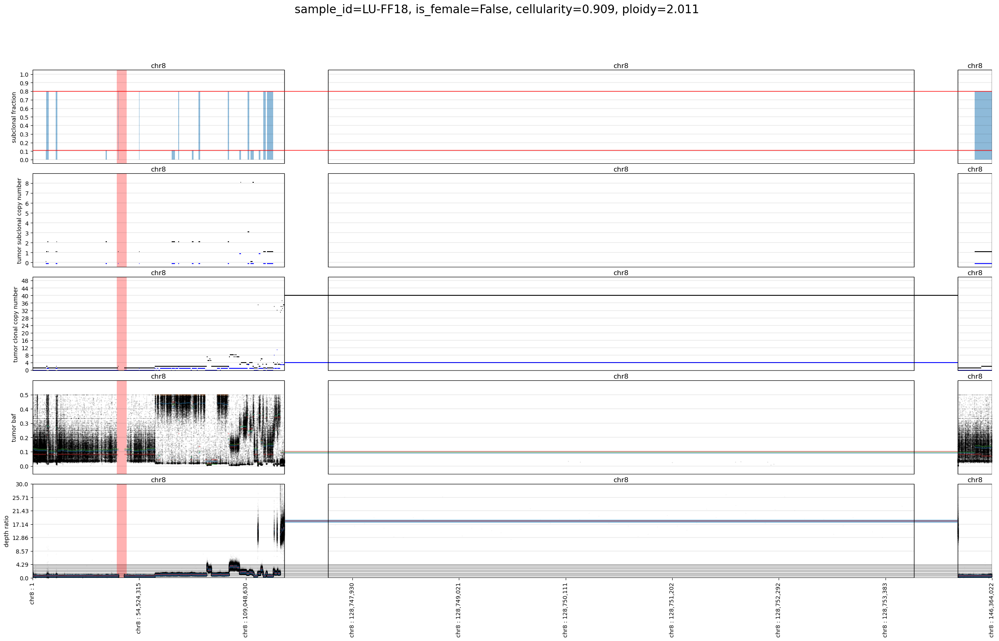

In [332]:
cnvplotter.reset_genomeplotter(region_df=zoomin_gr, region_gaps=0.1, )

fig, axd = cnvplotter.plot_aftercp_fixedccf(
    sampleid, cellularity, ploidy,
    
    # region_chroms=['21', '22',],
    # region_start0s=[19_000_000, 19_000_000],
    # region_end0s=[23_000_000, 23_000_000],
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    
    # CNt_diff_factor=0.01,
    
    # figsize=(30, 50),
    # CN_ymax=10,
    # subCN_ymax=5,
    
    draw_upscaled_depthratio=False,
    draw_upscaled_depth=False,
    
    n_xlabel=10,
    # mark_unfit_regions=False,
    
    depthratio_ymax=30,
    CN_ymax=50,
    
    # baf_dot_kwargs=dict(alpha=0.01),
    merge_same_chroms=False,
)

cnvplotter.reset_genomeplotter()

##### panel WGS overlap plotting

[KST 2023-07-14 11:36:15.807 genomeplot.plot_custom] line 2287: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 11:36:16.512 genomeplot.plot_custom] line 2308: Finished conversion of data coordinates into plot coordinates
[KST 2023-07-14 11:36:17.390 genomeplot.plot_custom] line 2287: Beginning conversion of data coordinates into plot coordinates
[KST 2023-07-14 11:36:17.420 genomeplot.plot_custom] line 2308: Finished conversion of data coordinates into plot coordinates


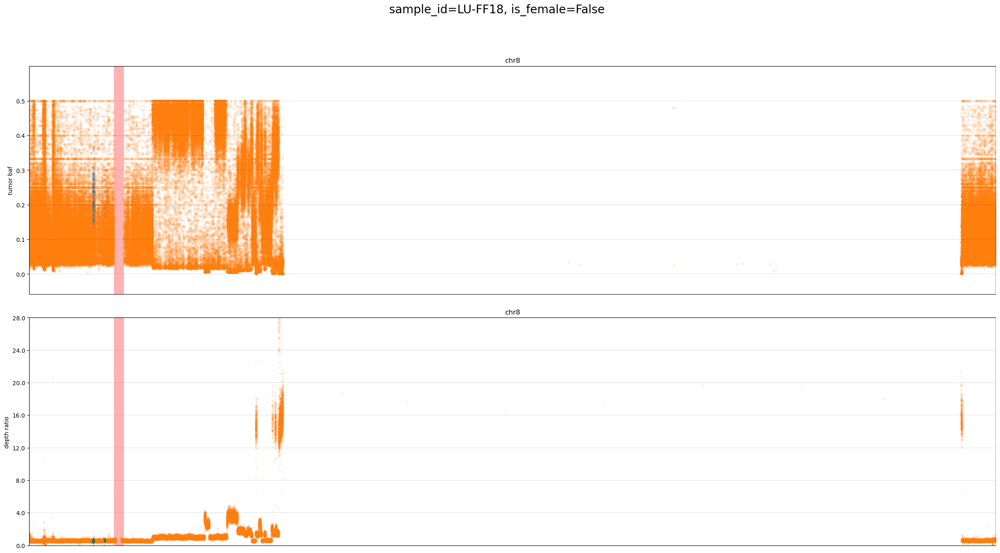

In [350]:
cnvplotter.reset_genomeplotter(region_df=zoomin_gr, region_gaps=0.1)

fig, axd = cnvplotter.plot_custom(
    sampleid, 
    figsize=(30, 15),
    title_y=0.98,
    
    # region_gaps=0,
    # region_chroms=['17',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 

    draw_tumor_baf=True,
    draw_depthratio=True,
    # use_plain_depthratio=False,
    
    use_upscaled_depthratio=True,
    
    # depthratio_ymax=3,
    depthratio_dot_kwargs=dict(color='tab:orange', markersize=3, alpha=0.08),
    baf_dot_kwargs=dict(color='tab:orange', markersize=4, alpha=0.1),
    # depthratio_dot_kwargs=dict(color='red'),
    # baf_dot_kwargs=dict(color='red'),
    
    # draw_feature=True,
    # feature_df=cancergene_gr,
    
    # height_ratios=[1, 3],
    
    depthratio_ymax=28,
)

fig, axd = cnvplotter.plot_custom(
    sampleid_panel,
    
    fig=fig,
    axd=axd,

    draw_tumor_baf=True,
    draw_depthratio=True,
    # use_plain_depthratio=False,
    
    use_upscaled_tumor_depth=False,
    use_upscaled_normal_depth=False,
    use_upscaled_depthratio=False,
    
    depthratio_dot_kwargs=dict(color='tab:blue', markersize=3, alpha=0.01),
    baf_dot_kwargs=dict(color='tab:blue', markersize=4, alpha=0.1),
    # depthratio_dot_kwargs=dict(color='blue'),
    # baf_dot_kwargs=dict(color='blue'),
)

cnvplotter.reset_genomeplotter()

In [63]:
import handygenome.annotation.oncokb as liboncokb
import handygenome.analysis.feature as libfeature

cancergenes = liboncokb.get_cancerGeneList(ONCOKB_TOKEN)
cancergene_gr = libfeature.get_gene_coords_gr(cancergenes['hugoSymbol'], 'hg19')
cancergene_gr.name = cancergene_gr.gene_name

[KST 2023-06-14 22:25:22] Trying to send http request to https://www.oncokb.org/api/v1/utils/cancerGeneList
[KST 2023-06-14 22:25:26] Trying to send http request to http://grch37.rest.ensembl.org/lookup/symbol/homo_sapiens?expand=0
[KST 2023-06-14 22:25:44] Trying to send http request to http://grch37.rest.ensembl.org/lookup/symbol/homo_sapiens?expand=0


[KST 2023-06-14 22:25:46.555 genomeplot.plot_custom] line 1985: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-14 22:25:57.695 genomeplot.plot_custom] line 2006: Finished conversion of data coordinates into plot coordinates
[KST 2023-06-14 22:25:58.159 genomeplot.plot_custom] line 1985: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-14 22:25:58.397 genomeplot.plot_custom] line 2006: Finished conversion of data coordinates into plot coordinates


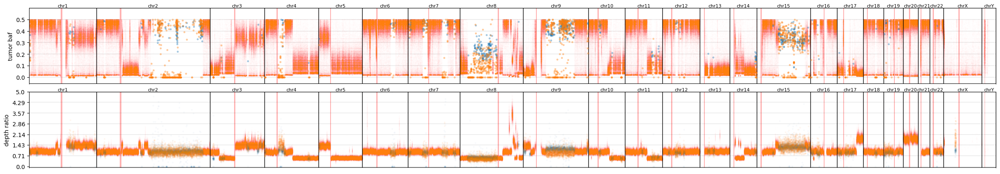

In [64]:
whole_gr = common.DEFAULT_CHROMDICTS['hg19'].to_gr(assembled_only=True)
panel_gr = PANEL_REGION_GR.copy()
whole_minus_panel = whole_gr.subtract(panel_gr)

whole_minus_panel.weight = 1
panel_gr.weight = 500

weighted_region = pr.concat([whole_minus_panel, panel_gr])
weighted_region = weighted_region.sort()


# weighted_region = weighted_region['4']

#####

panelregion_props_depth = dict(alpha=0.02, markersize=2)
panelregion_props_baf = dict(alpha=0.3, markersize=2.5)

#####

cnvplotter.reset_genomeplotter(region_df=weighted_region, region_gaps=0)

fig, axd = cnvplotter.plot_custom(
    sampleid, 
    figsize=(30, 5),
    title='',
    
    # region_gaps=0,
    # region_chroms=['1', '2', '3',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=True,
    
    # depthratio_ymax=3,
    # depthratio_dot_kwargs=dict(color='red', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='red', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=dict(color='tab:orange'),
    baf_dot_kwargs=dict(color='tab:orange', alpha=0.01),
    
    # n_xlabel=50,
    depthratio_ymax=5,
)

fig, axd = cnvplotter.plot_custom(
    sampleid_panel,
    
    fig=fig,
    axd=axd,

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=False,
    
    # depthratio_dot_kwargs=dict(color='blue', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='blue', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=(panelregion_props_depth | dict(color='tab:blue')),
    baf_dot_kwargs=(panelregion_props_baf | dict(color='tab:blue')),
)

wgs_depthratio_panelregion = pr.PyRanges(cnvplotter.data[sampleid]['depthratio']).intersect(PANEL_REGION_GR)
cnvplotter.genomeplotter.draw_dots(
    axd['depthratio'],
    y_colname='depthratio_raw',
    df=wgs_depthratio_panelregion,
    plot_kwargs=(panelregion_props_depth | dict(color='tab:orange', alpha=0.04)),
)

wgs_baf_panelregion = pr.PyRanges(cnvplotter.data[sampleid]['original_baf']).intersect(PANEL_REGION_GR)
cnvplotter.genomeplotter.draw_dots(
    axd['baf'],
    y_colname='baf_raw_tumor',
    df=wgs_baf_panelregion,
    plot_kwargs=(panelregion_props_baf | dict(color='tab:orange')),
)

# merged_panel_region = PANEL_REGION_GR.merge(slack=1_000_000)
# for ax in (axd['depthratio'], axd['baf']):
#     cnvplotter.genomeplotter.draw_bgcolors(
#         ax,
#         df=merged_panel_region,
#         colors='green',
#         plot_kwargs=dict(alpha=0.1),
#     )

cnvplotter.reset_genomeplotter()

[KST 2023-06-14 22:28:30.844 genomeplot.plot_custom] line 1985: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-14 22:28:36.349 genomeplot.plot_custom] line 2006: Finished conversion of data coordinates into plot coordinates
[KST 2023-06-14 22:28:36.816 genomeplot.plot_custom] line 1985: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-14 22:28:37.034 genomeplot.plot_custom] line 2006: Finished conversion of data coordinates into plot coordinates


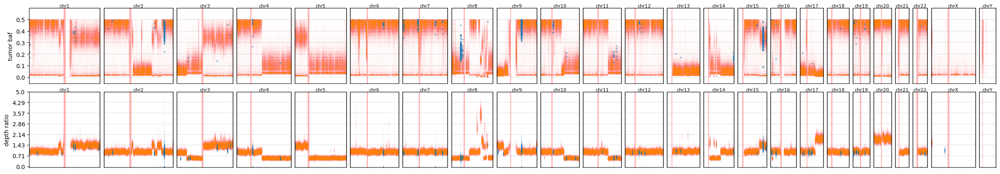

In [65]:
# cnvplotter.reset_genomeplotter(region_df=PANEL_REGION_GR.df)

fig, axd = cnvplotter.plot_custom(
    sampleid, 
    figsize=(30, 5),
    title='',
    
    # region_gaps=0,
    # region_chroms=['17',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=True,
    
    # depthratio_ymax=3,
    # depthratio_dot_kwargs=dict(color='red', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='red', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=dict(color='tab:orange'),
    baf_dot_kwargs=dict(color='tab:orange', alpha=0.01),
    
    depthratio_ymax=5,
)

fig, axd = cnvplotter.plot_custom(
    sampleid_panel,
    
    fig=fig,
    axd=axd,

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=False,
    
    # depthratio_dot_kwargs=dict(color='blue', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='blue', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=dict(color='tab:blue', alpha=0.2),
    baf_dot_kwargs=dict(color='tab:blue', alpha=0.4, markersize=2),
)

# cnvplotter.reset_genomeplotter()

In [84]:
cnvplotter.data[sampleid]['depthratio']['depthratio_raw'].quantile(0.99)

2.5426462957376628

##### gene finding

[KST 2023-06-15 07:10:49.606 genomeplot.plot_custom] line 2072: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-15 07:10:50.774 genomeplot.plot_custom] line 2093: Finished conversion of data coordinates into plot coordinates
[KST 2023-06-15 07:10:51.103 genomeplot.plot_custom] line 2072: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-15 07:10:51.147 genomeplot.plot_custom] line 2093: Finished conversion of data coordinates into plot coordinates


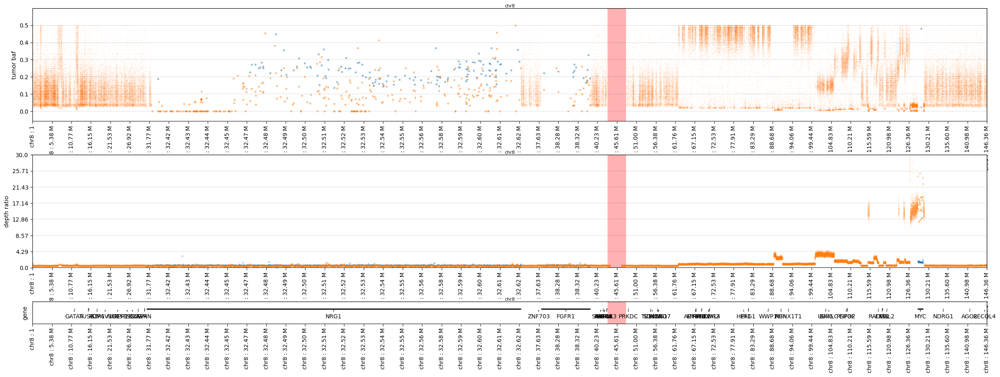

In [137]:
whole_gr = common.DEFAULT_CHROMDICTS['hg19'].to_gr(assembled_only=True)
panel_gr = PANEL_REGION_GR.copy()
whole_minus_panel = whole_gr.subtract(panel_gr)

whole_minus_panel.weight = 1
panel_gr.weight = 500

weighted_region = pr.concat([whole_minus_panel, panel_gr])
weighted_region = weighted_region.sort()


weighted_region = weighted_region['8']
# weighted_region = weighted_region.intersect(pr.from_dict({'Chromosome': ['8'], 'Start': [88_000_000], 'End': [130_000_000]}))

#####

panelregion_props_depth = dict(alpha=0.3, markersize=2)
panelregion_props_baf = dict(alpha=0.4, markersize=2.5)

#####

cnvplotter.reset_genomeplotter(region_df=weighted_region, region_gaps=0)

fig, axd = cnvplotter.plot_custom(
    sampleid, 
    figsize=(30, 10),
    title='',
    height_ratios=(5, 5, 1),
    
    # region_gaps=0,
    # region_chroms=['1', '2', '3',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=True,
    
    # depthratio_ymax=3,
    # depthratio_dot_kwargs=dict(color='red', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='red', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=dict(color='tab:orange'),
    baf_dot_kwargs=dict(color='tab:orange', alpha=0.1),
    
    n_xlabel=50,
    depthratio_ymax=30,
    
    draw_feature=True,
    feature_df=cancergene_gr,
)

fig, axd = cnvplotter.plot_custom(
    sampleid_panel,
    
    fig=fig,
    axd=axd,

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=False,
    
    # depthratio_dot_kwargs=dict(color='blue', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='blue', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=(panelregion_props_depth | dict(color='tab:blue')),
    baf_dot_kwargs=(panelregion_props_baf | dict(color='tab:blue')),
)

wgs_depthratio_panelregion = pr.PyRanges(cnvplotter.data[sampleid]['depthratio']).intersect(PANEL_REGION_GR)
cnvplotter.genomeplotter.draw_dots(
    axd['depthratio'],
    y_colname='depthratio_raw',
    df=wgs_depthratio_panelregion,
    plot_kwargs=(panelregion_props_depth | dict(color='tab:orange')),
)

wgs_baf_panelregion = pr.PyRanges(cnvplotter.data[sampleid]['original_baf']).intersect(PANEL_REGION_GR)
cnvplotter.genomeplotter.draw_dots(
    axd['baf'],
    y_colname='baf_raw_tumor',
    df=wgs_baf_panelregion,
    plot_kwargs=(panelregion_props_baf | dict(color='tab:orange')),
)

# merged_panel_region = PANEL_REGION_GR.merge(slack=1_000_000)
# for ax in (axd['depthratio'], axd['baf']):
#     cnvplotter.genomeplotter.draw_bgcolors(
#         ax,
#         df=merged_panel_region,
#         colors='green',
#         plot_kwargs=dict(alpha=0.1),
#     )

cnvplotter.reset_genomeplotter()

[KST 2023-06-15 07:16:08.262 genomeplot.plot_custom] line 2072: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-15 07:16:09.200 genomeplot.plot_custom] line 2093: Finished conversion of data coordinates into plot coordinates
[KST 2023-06-15 07:16:10.082 genomeplot.plot_custom] line 2072: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-15 07:16:10.123 genomeplot.plot_custom] line 2093: Finished conversion of data coordinates into plot coordinates


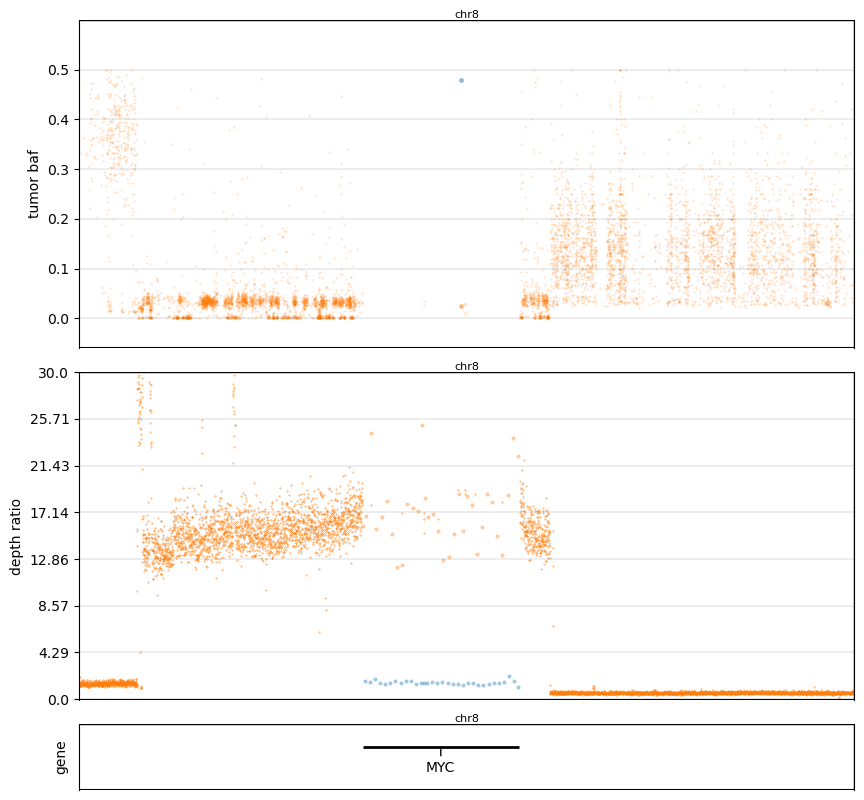

In [142]:
whole_gr = common.DEFAULT_CHROMDICTS['hg19'].to_gr(assembled_only=True)
panel_gr = PANEL_REGION_GR.copy()
whole_minus_panel = whole_gr.subtract(panel_gr)

whole_minus_panel.weight = 1
panel_gr.weight = 500

weighted_region = pr.concat([whole_minus_panel, panel_gr])
weighted_region = weighted_region.sort()


# weighted_region = weighted_region['8', 88_000_000:130_000_000]
weighted_region = weighted_region.intersect(pr.from_dict({'Chromosome': ['8'], 'Start': [126_000_000], 'End': [132_000_000]}))

#####

panelregion_props_depth = dict(alpha=0.3, markersize=2)
panelregion_props_baf = dict(alpha=0.4, markersize=2.5)

#####

cnvplotter.reset_genomeplotter(region_df=weighted_region, region_gaps=0)

fig, axd = cnvplotter.plot_custom(
    sampleid, 
    figsize=(10, 10),
    title='',
    height_ratios=(5, 5, 1),
    
    # region_gaps=0,
    # region_chroms=['1', '2', '3',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=True,
    
    # depthratio_ymax=3,
    # depthratio_dot_kwargs=dict(color='red', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='red', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=dict(color='tab:orange'),
    baf_dot_kwargs=dict(color='tab:orange', alpha=0.4),
    
    n_xlabel=None,
    depthratio_ymax=30,
    
    draw_feature=True,
    feature_df=cancergene_gr,
)

fig, axd = cnvplotter.plot_custom(
    sampleid_panel,
    
    fig=fig,
    axd=axd,

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=False,
    
    # depthratio_dot_kwargs=dict(color='blue', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='blue', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=(panelregion_props_depth | dict(color='tab:blue')),
    baf_dot_kwargs=(panelregion_props_baf | dict(color='tab:blue')),
)

wgs_depthratio_panelregion = pr.PyRanges(cnvplotter.data[sampleid]['depthratio']).intersect(PANEL_REGION_GR)
cnvplotter.genomeplotter.draw_dots(
    axd['depthratio'],
    y_colname='depthratio_raw',
    df=wgs_depthratio_panelregion,
    plot_kwargs=(panelregion_props_depth | dict(color='tab:orange')),
)

wgs_baf_panelregion = pr.PyRanges(cnvplotter.data[sampleid]['original_baf']).intersect(PANEL_REGION_GR)
cnvplotter.genomeplotter.draw_dots(
    axd['baf'],
    y_colname='baf_raw_tumor',
    df=wgs_baf_panelregion,
    plot_kwargs=(panelregion_props_baf | dict(color='tab:orange')),
)

# merged_panel_region = PANEL_REGION_GR.merge(slack=1_000_000)
# for ax in (axd['depthratio'], axd['baf']):
#     cnvplotter.genomeplotter.draw_bgcolors(
#         ax,
#         df=merged_panel_region,
#         colors='green',
#         plot_kwargs=dict(alpha=0.1),
#     )

cnvplotter.reset_genomeplotter()

[KST 2023-06-15 05:57:41.242 genomeplot.plot_custom] line 1988: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-15 05:57:50.769 genomeplot.plot_custom] line 2009: Finished conversion of data coordinates into plot coordinates


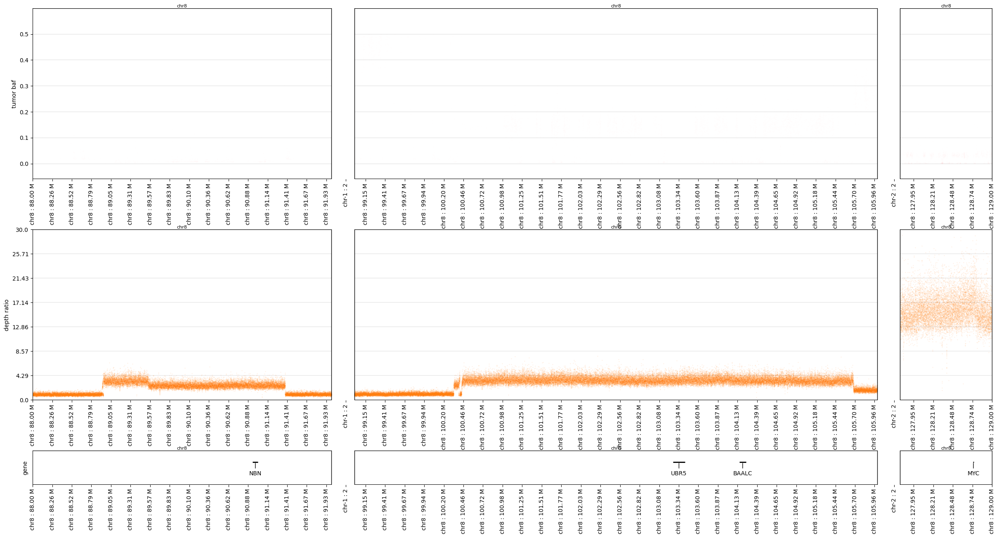

In [97]:
# cnvplotter.reset_genomeplotter(region_df=PANEL_REGION_GR.df)

fig, axd = cnvplotter.plot_custom(
    sampleid, 
    figsize=(30, 15),
    height_ratios=[5, 5, 1],
    title='',
    
    region_gaps=0.05,
    region_chroms=['8',],
    region_start0s=[88_000_000, 99_000_000, 127_770_000], 
    region_end0s=[92_000_000, 106_000_000, 129_000_000], 

    draw_tumor_baf=True,
    draw_depthratio=True,
    use_plain_depthratio=False,
    
    use_upscaled_depthratio=False,
    
    # depthratio_ymax=3,
    # depthratio_dot_kwargs=dict(color='red', markersize=3, alpha=0.05),
    # baf_dot_kwargs=dict(color='red', markersize=4, alpha=0.1),
    depthratio_dot_kwargs=dict(color='tab:orange'),
    baf_dot_kwargs=dict(color='tab:orange', alpha=0.01),
    
    depthratio_ymax=30,
    
    n_xlabel=50,
    
    draw_feature=True,
    feature_df=cancergene_gr,
    
    merge_same_chroms=False,
)

# fig, axd = cnvplotter.plot_custom(
#     sampleid_panel,
    
#     fig=fig,
#     axd=axd,

#     draw_tumor_baf=True,
#     draw_depthratio=True,
#     use_plain_depthratio=False,
    
#     use_upscaled_depthratio=False,
    
#     # depthratio_dot_kwargs=dict(color='blue', markersize=3, alpha=0.05),
#     # baf_dot_kwargs=dict(color='blue', markersize=4, alpha=0.1),
#     depthratio_dot_kwargs=dict(color='tab:blue', alpha=0.2),
#     baf_dot_kwargs=dict(color='tab:blue', alpha=0.4, markersize=2),
# )

# cnvplotter.reset_genomeplotter()

In [99]:
cancergene_gr[cancergene_gr.name == 'MYC']

,Chromosome,Start,End,gene_name,name
161,8,128747679,128753674,MYC,MYC


#### Germline 2-copy area selection

In [105]:
normal_baf_df = libvp.get_vafdf(baf_vcf_path, sampleid=f'{sampleid}_normal', nproc=18)

[KST 2023-05-08 16:43:17.421 variantplus.get_vafdf] line 1928: Extracting vcf position information
[KST 2023-05-08 16:43:37.291 variantplus.get_vafdf] line 1937: Running parallel jobs
[KST 2023-05-08 16:44:11.238 variantplus.get_vafdf] line 1944: Concatenating split job dataframes


In [107]:
normal_baf_df['baf_raw'] = cnvmisc.get_bafs(normal_baf_df['vaf_LU-F13_normal'])

In [121]:
cnvplotter.data[sampleid]['normal_depth']

,Chromosome,Start,End,mean_depth,GC,excluded,sequenza_style_norm_mean_depth
0,1,0,100,0.00,0.000000,True,0.000000
1,1,100,200,0.00,0.000000,True,0.000000
2,1,200,300,0.00,0.000000,True,0.000000
3,1,300,400,0.00,0.000000,True,0.000000
4,1,400,500,0.00,0.000000,True,0.000000
...,...,...,...,...,...,...,...
31018081,GL000192.1,547000,547100,54.70,0.420000,True,1.677708
31018082,GL000192.1,547100,547200,29.80,0.390000,False,0.905119
31018083,GL000192.1,547200,547300,23.29,0.580000,False,0.738535
31018084,GL000192.1,547300,547400,16.79,0.530000,True,0.531165


In [27]:
upscaled_depth_df = cnvmisc.upsize_depth_df_bin(cnvplotter.data[sampleid]['normal_depth'], size=1000, refver='hg19')

In [29]:
segdf, _ = rcopynumber.run_rcopynumber(depth_df=upscaled_depth_df.rename(columns={'mean_depth': 'depth_raw'}), refver='hg19', as_gr=False, winsorize=False, verbose=True)

[KST 2023-05-08 14:04:24.652 rcopynumber.make_merged_df] line 124: Adding chromosome arm information
[KST 2023-05-08 14:04:27.118 rcopynumber.make_merged_df] line 127: Removing rows with missing depth or arm information
[KST 2023-05-08 14:04:27.537 rcopynumber.run_rcopynumber] line 404: Writing dataframe into file for R-copynumber input
[KST 2023-05-08 14:04:51.594 rcopynumber.run_rcopynumber] line 409: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13p 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14p 
pcf finished for ch

[KST 2023-05-08 14:05:42.436 rcopynumber.run_rcopynumber] line 428: Loading R-copynumber output


In [40]:
global_mean = np.average(upscaled_depth_df['mean_depth'], weights=(upscaled_depth_df['End'] - upscaled_depth_df['Start']))

In [101]:
width = 0.2
upper = global_mean * (1 + width)
lower = global_mean * (1 - width)
segdf['excluded'] = ~ segdf['depth_segment_mean'].between(lower, upper)

re_upscaled_depth_df = cnvmisc.upsize_depth_df_bin(cnvplotter.data[sampleid]['normal_depth'], size=1000, refver='hg19')
plotting_depth_df = pyranges_helper.join(re_upscaled_depth_df.drop('excluded', axis=1), segdf.drop('depth_segment_mean', axis=1), how='left', merge='first', find_nearest=True, as_gr=False)
plotting_depth_df['color'] = plotting_depth_df['excluded'].apply(lambda x: 'blue' if x is False else 'red')

/home/users/pjh/scripts/python_genome_package_dev/handygenome/pyranges_helper.py:751: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  result = pd.concat(concat_dfs, axis=0)


8


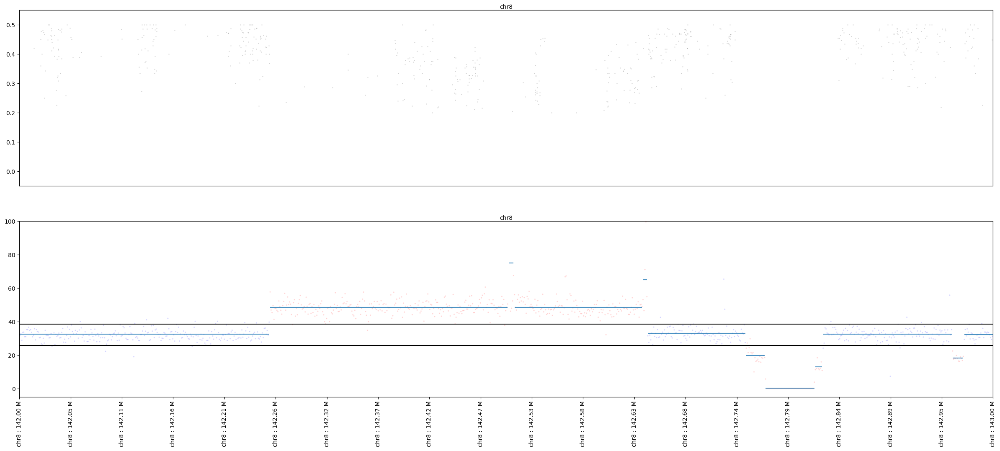

In [120]:
# chromlist = ['1', '2', '3']
chromlist = ['8']
# chromlist = [str(x) for x in range(1, 23)] + ['X', 'Y']

fig, axs = plt.subplots(len(chromlist) * 2, 1, figsize=(30, 6 * len(chromlist) * 2))

for idx, chrom in enumerate(chromlist):
    ax1 = axs[2 * idx]
    ax2 = axs[2 * idx + 1]
    
    print(chrom)
    
    genomeplotter = libgenomeplot.GenomePlotter(refver='hg19', chroms=[chrom], start0s=[142_000_000], end0s=[143_000_000])
    
    # ax1
    ax1.set_ylim(-0.05, 0.55)
    genomeplotter.set_xlim(ax1)
    genomeplotter.draw_dots(ax1, 'baf_raw', df=normal_baf_df, plot_kwargs=dict(alpha=0.1, markersize=1))
    genomeplotter.draw_chrom_borders(ax1, text_kwargs=dict(size=10))
    ax1.set_xticks([])
    
    # ax2
    ax2.set_ylim(-5, 100)
    genomeplotter.set_xlim(ax2)
    genomeplotter.draw_dots_scatter(ax2, 'mean_depth', df=plotting_depth_df, color_colname='color', plot_kwargs=dict(s=2, alpha=0.1))
    genomeplotter.draw_hlines(ax2, 'depth_segment_mean', df=segdf, plot_kwargs=dict(alpha=0.8))
    genomeplotter.draw_chrom_borders(ax2, text_kwargs=dict(size=10))
    genomeplotter.draw_genomecoord_labels(ax2, n=20)
    ax2.axhline(upper, color='black')
    ax2.axhline(lower, color='black')

In [99]:
width = 0.2
upper = global_mean * (1 + width)
lower = global_mean * (1 - width)

plotting_depth_df = cnvmisc.upsize_depth_df_bin(cnvplotter.data[sampleid]['normal_depth'], size=1000, refver='hg19')
plotting_depth_df['excluded'] = ~plotting_depth_df['mean_depth'].between(lower, upper)
plotting_depth_df['color'] = plotting_depth_df['excluded'].apply(lambda x: 'blue' if x is False else 'red')

1
2
3


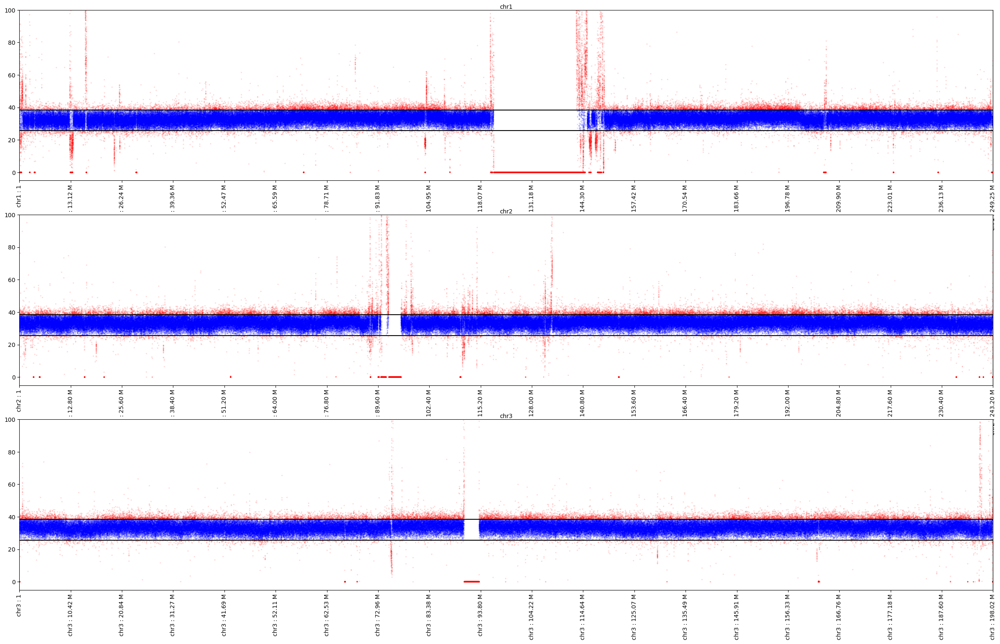

In [100]:
chromlist = ['1', '2', '3']

fig, axs = plt.subplots(len(chromlist), 1, figsize=(30, 6 * len(chromlist)))

for ax, chrom in zip(axs, chromlist):
    print(chrom)
    ax.set_ylim(-5, 100)

    genomeplotter = libgenomeplot.GenomePlotter(refver='hg19', chroms=[chrom])
    genomeplotter.set_xlim(ax)
    genomeplotter.draw_dots_scatter(ax, 'mean_depth', df=plotting_depth_df, color_colname='color', plot_kwargs=dict(s=2, alpha=0.1))
    # genomeplotter.draw_hlines(ax, 'depth_segment_mean', df=segdf, plot_kwargs=dict(alpha=0.8))
    genomeplotter.draw_chrom_borders(ax, text_kwargs=dict(size=10))
    genomeplotter.draw_genomecoord_labels(ax, n=20)

    ax.axhline(upper, color='black')
    ax.axhline(lower, color='black')

In [87]:
np.average(segdf['excluded'], weights=(segdf['End'] - segdf['Start']))

0.09958365904864262

#### WGS mode test

In [494]:
cnvplotter = libgenomeplot.CNVPlotter(refver='hg19')

In [19]:
cnvplotter.load_data(sampleid, sampledata_path)

In [499]:
cnvplotter.add_sample_file_new(
    sampleid=sampleid,
    is_female=IS_FEMALE[sampleid],
    
    # germline_vcf_path=baf_vcf_path,
    germline_vafdf_path=baf_df_path,
    vcf_sampleid_tumor=sampleid_tumor,
    vcf_sampleid_normal=sampleid_normal,
    
    normal_depth_path=wgs_normal_mosdepth_output_path,
    tumor_depth_path=wgs_tumor_mosdepth_output_path,
    
    vcfload_nproc=18,
    mode='wgs',
)

[KST 2023-06-11 19:01:55.939 genomeplot.add_sample_file_new] line 1031: Loading normal depth
[KST 2023-06-11 19:02:07.276 genomeplot.add_sample_file_new] line 1042: Loading tumor depth
[KST 2023-06-11 19:02:23.355 genomeplot.find_germline_copyneutral_region] line 3207: Running segmentation of normal bam depth in order to find copy-neutral region
[KST 2023-06-11 19:03:54.524 genomeplot.add_sample_file_new] line 1059: Loading tumor germline vcf


In [500]:
cnvplotter.postprocess_depth(sampleid, verbose=False)

[KST 2023-06-11 19:04:02.839 genomeplot.postprocess_depth] line 1125: Getting gc fraction dataframe
[KST 2023-06-11 19:04:02.840 genomeplot.postprocess_depth] line 1135: Beginning postprocess of normal depth
[KST 2023-06-11 19:04:46.819 genomeplot.postprocess_depth] line 1135: Beginning postprocess of tumor depth


In [501]:
cnvplotter.set_depthratio(sampleid)
cnvplotter.upscale_depthratio(sampleid, 1000)

In [35]:
cnvplotter.make_segments(sampleid, verbose=True, segment_baf_cutoff=0.1, baf_gamma=500, baf_kmin=50)

[KST 2023-06-04 18:50:18.672 rcopynumber.make_merged_df] line 124: Adding chromosome arm information
[KST 2023-06-04 18:50:19.252 rcopynumber.make_merged_df] line 124: Adding chromosome arm information
[KST 2023-06-04 18:50:20.983 rcopynumber.make_merged_df] line 127: Removing rows with missing depth or arm information
[KST 2023-06-04 18:50:21.183 rcopynumber.run_rcopynumber] line 404: Writing dataframe into file for R-copynumber input
[KST 2023-06-04 18:50:23.185 rcopynumber.make_merged_df] line 127: Removing rows with missing depth or arm information
[KST 2023-06-04 18:50:23.736 rcopynumber.run_rcopynumber] line 404: Writing dataframe into file for R-copynumber input
[KST 2023-06-04 18:50:36.017 rcopynumber.run_rcopynumber] line 409: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 


[KST 2023-06-04 18:50:52.999 rcopynumber.run_rcopynumber] line 409: Running R-copynumber


pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chromosome arm 15q 
pcf finished for chromosome arm 16p 
pcf finished for chromosome arm 16q 
pcf finished for chromosome arm 17p 
pcf finished for chromosome arm 17q 
pcf finished for chromosome arm 18p 
pcf finished for chromosome arm 18q 
pcf finished for chromosome arm 19p 
pcf finished for chromosome arm 19q 
pcf finished for chromosome arm 20p 
pcf finish

[KST 2023-06-04 18:51:06.491 rcopynumber.run_rcopynumber] line 428: Loading R-copynumber output


pcf finished for chromosome arm Xq 
pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chr

[KST 2023-06-04 18:51:38.666 rcopynumber.run_rcopynumber] line 428: Loading R-copynumber output


In [36]:
cnvplotter.save_data(sampleid, sampledata_path)

##### Plot data without cp

[KST 2023-06-06 01:22:25.553 genomeplot.plot_beforecp] line 1224: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-06 01:22:32.515 genomeplot.make_plotdata_fordepth] line 1969: Beginning tumor depth data processing
[KST 2023-06-06 01:22:39.588 genomeplot.make_plotdata_fordepth] line 1971: Finished tumor depth data processing
[KST 2023-06-06 01:22:39.589 genomeplot.make_plotdata_fordepth] line 1973: Beginning normal depth data processing
[KST 2023-06-06 01:22:46.725 genomeplot.make_plotdata_fordepth] line 1975: Finished normal depth data processing
[KST 2023-06-06 01:22:46.726 genomeplot.plot_beforecp] line 1228: Finished conversion of data coordinates into plot coordinates


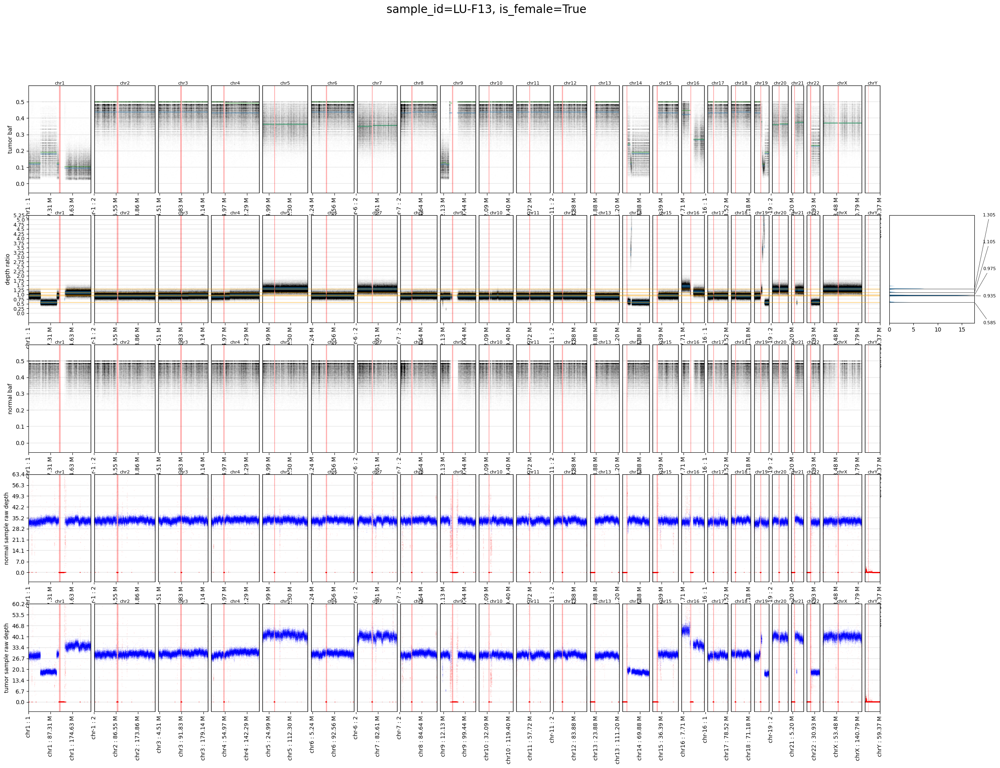

In [25]:
fig, axd = cnvplotter.plot_beforecp(
    sampleid, 
    # figsize=(30, 20),
    # region_gaps=0,
    # region_chroms=['17',],
    # region_start0s=[20_000_000], 
    # region_end0s=[24_000_000], 
    
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    # baf_line_segmean_kwargs=dict(alpha=0.8),
    # depth_dot_kwargs=dict(alpha=0.4),
    # use_merged_segment=True,
    
    draw_depth=True,
    # is_rawdepth=True,
    # depth_binsize=None,
    
    # depthratio_ymax=6,
    # depth_ymax=300,
    n_xlabel=40,
)

##### baf simulation

In [ ]:
bafgr = pr.PyRanges(cnvplotter.data[sampleid]['baf'])

[0.1410508]


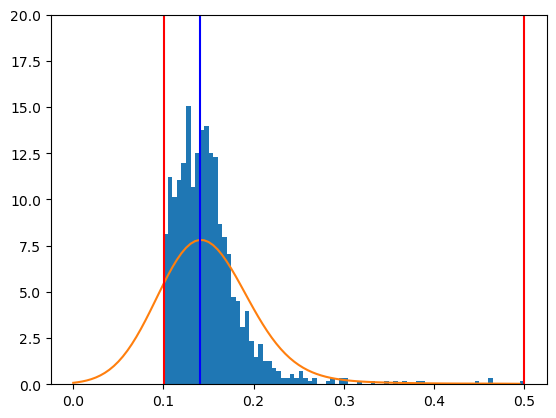

In [900]:
# bafs = bafgr['2', 0:80_000_000].baf_raw_tumor
# bafs = bafgr['2'].baf_raw_tumor
# bafs = bafgr['14', 32_000_000:36_000_000].baf_raw_tumor
bafs = bafgr['14', 33_500_000:34_500_000].baf_raw_tumor

# bafs = bafs.sample(10000)

bafs = bafs[bafs > 0.1]

bw = 1
peak_values, peak_densities, density = cnvmisc.get_density_peaks(bafs.dropna(), invert=False, bw_method=bw)
neg_peak_values, neg_peak_densities, density = cnvmisc.get_density_peaks(bafs.dropna(), invert=True, bw_method=bw)

fig, ax = plt.subplots()
_ = ax.hist(bafs, bins=100, range=(0, 0.5), density=True)
dxs = np.arange(0, 0.5, 0.005)
ax.plot(dxs, density(dxs))
for x in peak_values:
    ax.axvline(x, color='blue')
for x in neg_peak_values:
    ax.axvline(x, color='red')

ax.set_ylim(0, 20)

print(peak_values)

[0.19929982]


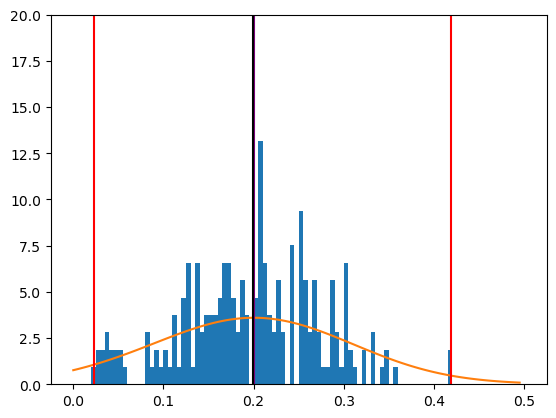

In [881]:
N = 500
hom_fraction = 0.6
N_hom = int(N * hom_fraction)
N_het = int(N * (1 - hom_fraction))
vaf = 0.2
p_error = 0.001
avg_depth = 30

td_hom = scipy.stats.poisson.rvs(avg_depth, size=N_hom)
ad_hom = scipy.stats.binom.rvs(n=td_hom, p=p_error)
vafs_hom = ad_hom / td_hom
bafs_hom = np.where(vafs_hom > 0.5, 1 - vafs_hom, vafs_hom)

td_het = scipy.stats.poisson.rvs(avg_depth, size=N_het)
ad_het = scipy.stats.binom.rvs(n=td_het, p=vaf)
vafs_het = ad_het / td_het
bafs_het = np.where(vafs_het > 0.5, 1 - vafs_het, vafs_het)

bafs = np.concatenate([bafs_hom, bafs_het])


bafs = bafs[bafs > 0]

bw = 1
peak_values, peak_densities, density = cnvmisc.get_density_peaks(bafs, bw_method=bw)
neg_peak_values, neg_peak_densities, density = cnvmisc.get_density_peaks(bafs, invert=True, bw_method=bw)
# density = scipy.stats.gaussian_kde(bafs, bw_method=bw)
dxs = np.arange(0, 0.5, 0.005)
dys = density(dxs)

fig, ax = plt.subplots()
_ = ax.hist(bafs, bins=100, range=(0, 0.5), density=True)
_ = ax.plot(dxs, dys)
ax.axvline(vaf, color='purple')
for x in peak_values:
    ax.axvline(x, color='black')
for x in neg_peak_values:
    ax.axvline(x, color='red')
ax.set_ylim(0, 20)

print(peak_values)

In [1027]:
simbaf_data = libbaf.make_simulated_baf_dataset(mean_depth=30, N=100, p_error=0.001, reps=10, hom_portion=0.6, verbose=False)
infbaf_data = libbaf.make_inferred_baf_dataset(simbaf_data, bw=1)

ValueError: `dataset` input should have multiple elements.

In [1028]:
simbaf_data.shape

(51, 10, 100)

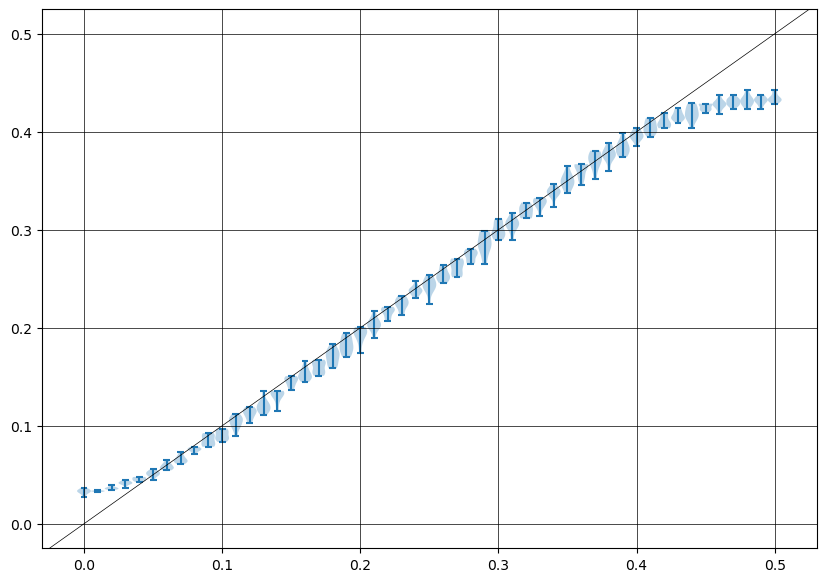

In [1024]:
fig, ax = plt.subplots(figsize=(10, 7))
_ = ax.violinplot(infbaf_data.T, positions=np.arange(0, 0.51, 0.01), widths=0.01)
ax.axline((0, 0), (0.5, 0.5), linewidth=0.5, color='black')
for x in (0, 0.1, 0.2, 0.3, 0.4, 0.5):
    ax.axvline(x, color='black', linewidth=0.5)
    ax.axhline(x, color='black', linewidth=0.5)

In [818]:
simbaf_data = libbaf.make_simulated_baf_dataset(mean_depth=30, N=10000, p_error=0.001, reps=10, hom_portion=0.6, verbose=False)

In [820]:
infbaf_data = libbaf.make_inferred_baf_dataset(simbaf_data, bw=1)

In [803]:
libbaf.find_best_bandwidth(30)

0.9500000000000004

In [821]:
infbaf_data.mean(axis=1)

array([0.03725229, 0.03388644, 0.05423358, 0.04049335, 0.04596537,
       0.05200782, 0.05834434, 0.06648574, 0.07371594, 0.08354683,
       0.09208899, 0.10149182, 0.11084544, 0.12068021, 0.1287882 ,
       0.14063876, 0.15202859, 0.16217617, 0.17269397, 0.18174015,
       0.1932403 , 0.20347532, 0.21398728, 0.22349394, 0.2339413 ,
       0.24520335, 0.25438962, 0.26554245, 0.27637215, 0.28700242,
       0.29730521, 0.30795645, 0.3178218 , 0.32846416, 0.33975979,
       0.34960255, 0.35976275, 0.36951342, 0.37954868, 0.38880786,
       0.39621443, 0.40329887, 0.40969638, 0.41452601, 0.42028971,
       0.42415   , 0.4275518 , 0.43095899, 0.43232526, 0.43241357,
       0.43319284])

In [822]:
interp = scipy.interpolate.interp1d(infbaf_data.mean(axis=1), np.arange(0, 0.51, 0.01), fill_value='extrapolate')

In [825]:
libbaf.save_bafcorrect_func(interp)

In [826]:
bafcor = libbaf.load_bafcorrect_func()

<function handygenome.cnv.baf.load_bafcorrect_func.<locals>.newfunc(x)>

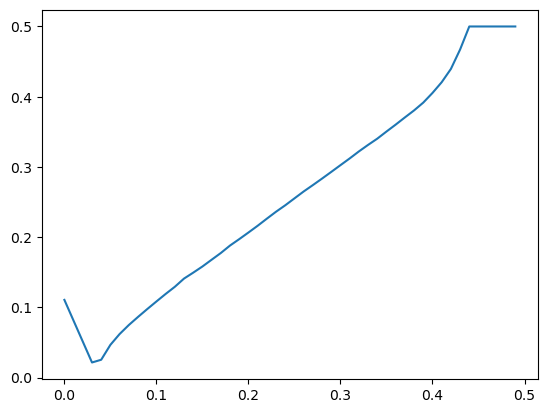

In [829]:
xs = np.arange(0, 0.5, 0.01)
ys = bafcor(xs)
plt.plot(xs, ys)

##### set cp and plot

In [22]:
cellularity, ploidy = cnvmisc.get_cp_from_twodata(
    depthratio1=0.935, 
    CNt1=4, 
    depthratio2=1.305, 
    CNt2=6, 
    normal_ploidy=cnvplotter.data[sampleid]['normal_mean_ploidy'],
    CNn=2,
)

In [23]:
cellularity, ploidy

(0.654867256637167, 4.351351351351351)

##### find subclonal solution

[KST 2023-06-06 01:21:05.673 genomeplot.plot_aftercp_freeccf] line 1450: Beginning calculation of subclonal solution
[KST 2023-06-06 01:21:05.679 genomeplot.plot_aftercp_freeccf] line 1462: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-06 01:21:10.674 genomeplot.plot_aftercp_freeccf] line 1466: Finished conversion of data coordinates into plot coordinates


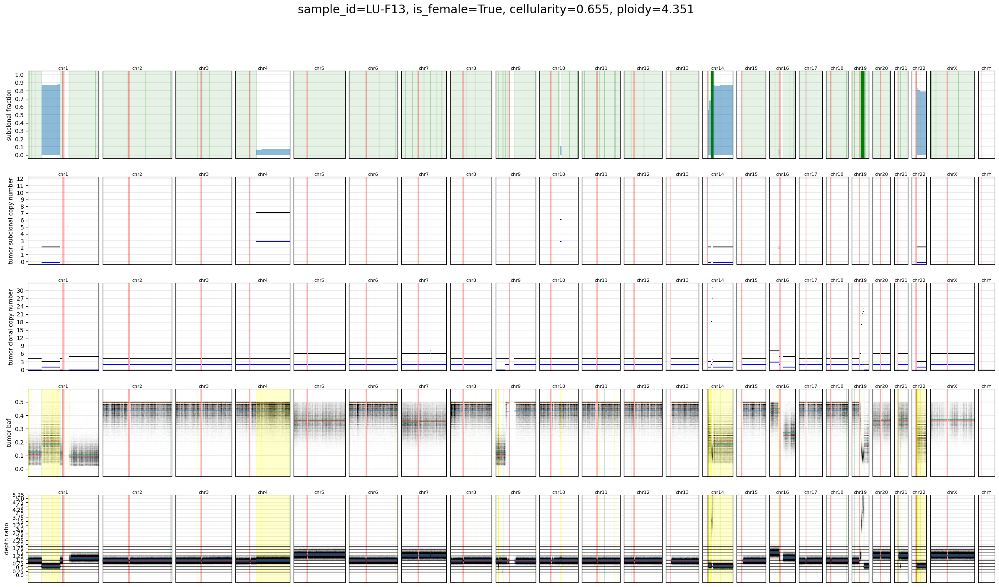

In [24]:
fig, axd = cnvplotter.plot_aftercp_freeccf(sampleid, cellularity, ploidy)

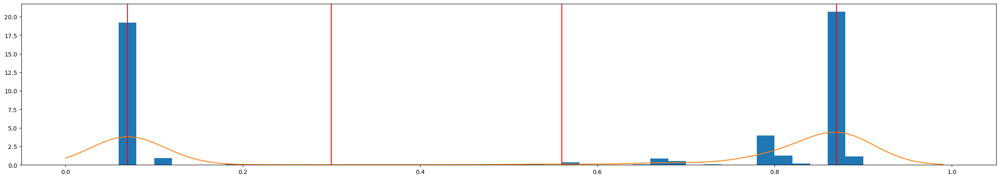

In [27]:
cnvplotter.show_ccfs(sampleid)

In [28]:
print(cnvplotter.data[sampleid]['fixed_ccfs'])

[0.87 0.07]


[KST 2023-06-06 04:28:46.790 genomeplot.plot_aftercp_fixedccf] line 1629: Beginning calculation of subclonal solution
[KST 2023-06-06 04:28:46.795 genomeplot.plot_aftercp_fixedccf] line 1640: Finished calculation of subclonal solution
[KST 2023-06-06 04:28:46.795 genomeplot.plot_aftercp_fixedccf] line 1642: Beginning conversion of data coordinates into plot coordinates
[KST 2023-06-06 04:28:51.661 genomeplot.plot_aftercp_fixedccf] line 1649: Finished conversion of data coordinates into plot coordinates


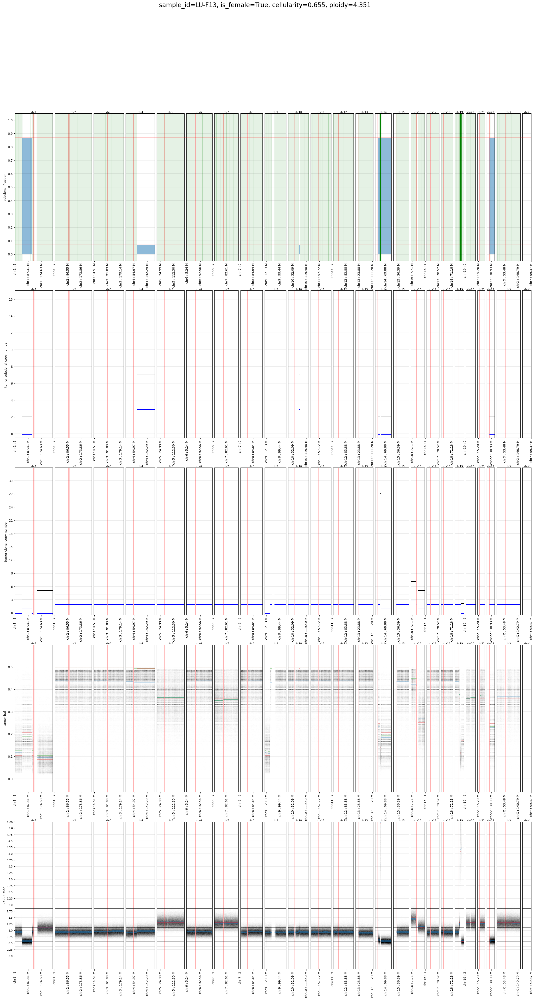

In [52]:
fig, axd = cnvplotter.plot_aftercp_fixedccf(
    sampleid, cellularity, ploidy,
    
    # region_chroms=['21', '22',],
    # region_start0s=[19_000_000, 19_000_000],
    # region_end0s=[23_000_000, 23_000_000],
    # depthratio_dot_kwargs=dict(alpha=0.5),
    # baf_dot_kwargs=dict(alpha=0.5),
    
    update_plotdata=False,
    # CNt_diff_factor=0.01,
    
    figsize=(30, 50),
    # CN_ymax=10,
    # subCN_ymax=5,
    
    n_xlabel=40,
    # mark_unfit_regions=False,
)

In [60]:
calc_ploidy, target_fit_seggr = cnvmisc.calculate_tumor_mean_ploidy(
    cnvplotter.data[sampleid]['merged_segment'], 
    cnvplotter.data[sampleid]['target_region'],
)

In [62]:
calc_ploidy

4.472014341258349

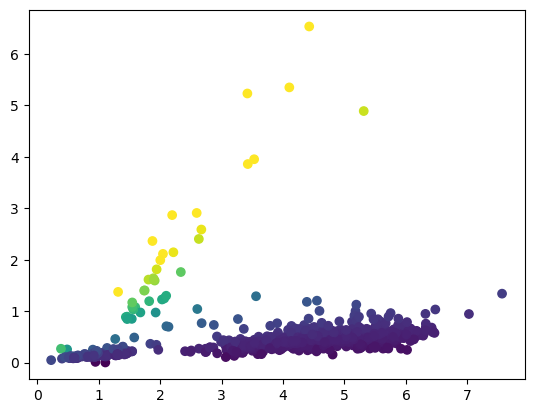

In [1547]:
colors = mpl.cm.viridis(segdf['depthratio_segment_std'] / segdf['depthratio_segment_mean'])
plt.scatter(segdf['depthratio_segment_mean'], segdf['depthratio_segment_std'], c=colors)

### Plot panel region only

##### create depth df of tumor panel bam

In [442]:
bam_path = BAM_PATHS['panel'][sampleid]
tumor_panel_depth_df, tumor_panel_gcbin_depths = cnvmisc.get_processed_depth_df(
    bam_path=bam_path, 
    fasta=FASTA_HG19, 
    region_gr=PANEL_REGION_GR_100bin, 
    preset_cutoffs='panel', 
    donot_subset_bam=True, 
    as_gr=False,
)

##### create germline variant df

In [452]:
panel_germline_vplist = VariantPlusList.from_vcf_lazy(PANEL_GERMLINE_VCF_PATHS[sampleid])
panel_germline_gr = panel_germline_vplist.get_df(
    alt_index=0,
    vaf_sampleid=sampleid_panel,
    as_gr=True,
    get_vaf_kwargs={
        'exclude_other': True,
    },
    lazy=True,
)
# panel_germline_gr.baf_raw = cnvmisc.get_bafs(panel_germline_gr.vaf)
panel_germline_df = panel_germline_gr.df
panel_germline_df.rename(columns={'vaf_LU-F13_panel': 'vaf'}, inplace=True)

##### compact r-copynumber run validation

In [404]:
panel_depthratio_gr = cnvmisc.make_depth_ratio_df(tumor_panel_depth_df, merged_normal_panel_depth_gr.df, as_gr=True)
panel_depthratio_gr.depth = panel_depthratio_gr.depth_ratio_sequenzastyle

In [409]:
_merged_gr = rcopynumber.make_merged_gr(panel_depthratio_gr['X'].df, panel_germline_df, refver='hg19')
_compact_merged_df, _coord_converter, _rev_coord_converter = rcopynumber.make_compact(_merged_gr)

In [412]:
panel_segment_gr = rcopynumber.run_rcopynumber_unified(
    panel_depthratio_gr.df, baf_df=panel_germline_gr.df, refver='hg19', as_gr=True, 
    df_written=_compact_merged_df,
    compact=False, 
    winsorize=False, 
    kmin=5,
    gamma=40,
)
# panel_segment_gr = rcopynumber.add_CNn_to_targetseq_segment_gr(panel_segment_gr, PANEL_REGION_GR_100bin, refver='hg19', is_female=IS_FEMALE[sampleid])

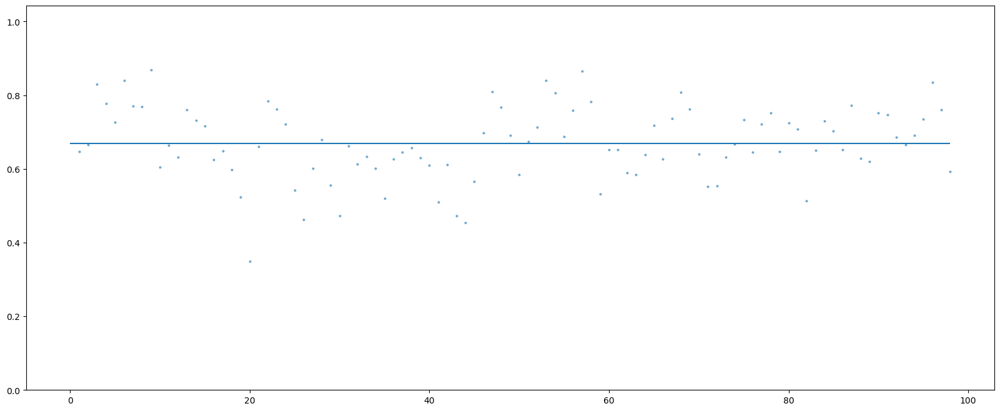

In [413]:
fig, ax = plt.subplots(figsize=(20, 8))
ax.set_ylim(0, _compact_merged_df.depth.max() * 1.2)
ax.hlines(panel_segment_gr.depth_mean, panel_segment_gr.Start, panel_segment_gr.End)
ax.plot(_compact_merged_df.pos, _compact_merged_df.depth, linestyle='', marker='o', markersize=2, alpha=0.5)

##### main

In [460]:
import handygenome.plot.genomeplot as libgenomeplot

segment_df, depth_baf_gr = libgenomeplot.draw_targetseq_cnvplot_from_data_precp(
    # tumor_panel_depth_df,
    # merged_normal_panel_depth_df,
    # panel_germline_df,
    
    tumor_panel_depth_df.loc[tumor_panel_depth_df.Chromosome == '2', :],
    merged_normal_panel_depth_df.loc[merged_normal_panel_depth_df.Chromosome == '2', :],
    panel_germline_df.loc[panel_germline_df.Chromosome == '2', :],
    
    PANEL_REGION_GR_100bin,
    'hg19',
    IS_FEMALE[sampleid],
)

/home/users/pjh/scripts/python_genome_package_dev/handygenome/plot/genomeplot.py:1447: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # make depth ratio


TypeError: run_rcopynumber_unified() takes 0 positional arguments but 1 positional argument (and 5 keyword-only arguments) were given

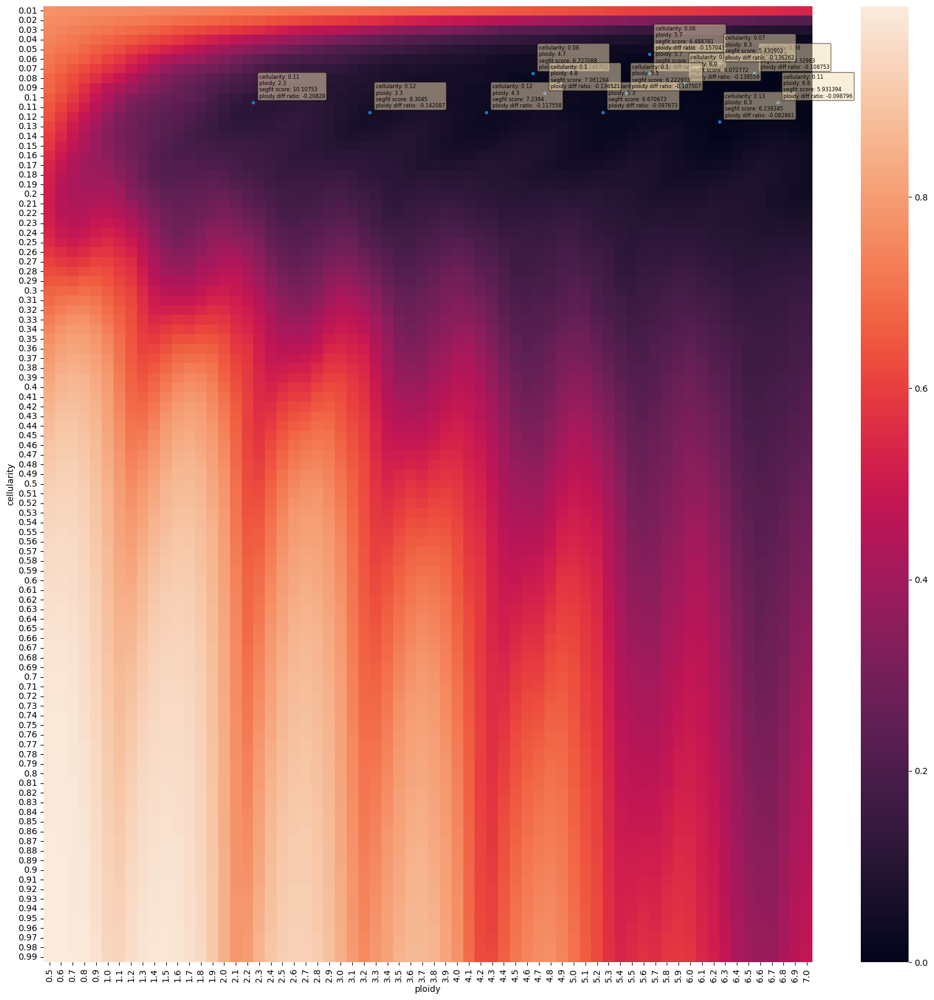

In [564]:
peak_values, dfs, cpscore_dict = libgenomeplot.draw_targetseq_cnvplot_from_data_choosecp(
    segment_df,
    depth_baf_gr,
    
    PANEL_REGION_GR_100bin,
    'hg19',
    IS_FEMALE[sampleid],
    
    CNt_weight=5,
    nproc=None,
)

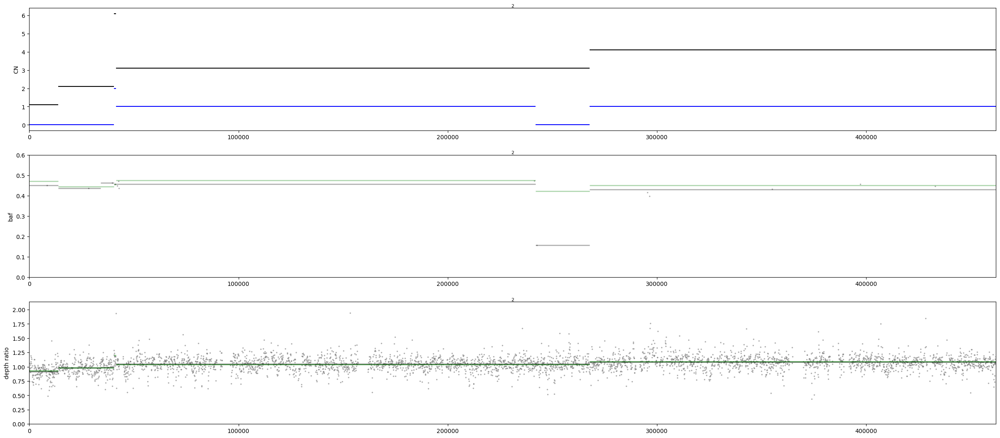

In [573]:
cellularity = 0.11 ; ploidy = 2.3
fig, axd = libgenomeplot.draw_targetseq_cnvplot_from_data_postcp(
    cellularity,
    ploidy,
    segment_df,
    depth_baf_gr,
    
    PANEL_REGION_GR_100bin,
    'hg19',
    IS_FEMALE[sampleid],
)

In [463]:
sampleid

'LU-F13'

In [465]:
cnvplotter_panel = libgenomeplot.CNVPlotter(refver='hg19', region_df=PANEL_REGION_GR.df)

In [467]:
cnvplotter_panel.add_sample_file(
    sampleid=sampleid,
    is_female=IS_FEMALE[sampleid],
    
    tumor_vcf_path=PANEL_GERMLINE_VCF_PATHS[sampleid],
    tumor_vcf_sampleid=sampleid_panel,
    
    normal_depth_path=MERGED_NORMAL_PANEL_DEPTH_DF_PATH,
    tumor_depth_path='/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/region_depth_files/LU-F13.panel.regions.bed.gz',
    
    vcfload_nproc=1,
    target_region=cnvplotter_panel.cconv.totalregion_df,
    mode='panel',
)

[KST 2023-04-10 13:42:30.559 genomeplot.add_sample_file] line 614: Loading normal depth


ValueError: invalid literal for int() with base 10: 'Start'

In [354]:
cnvplotter.set_depthratio(sampleid)
cnvplotter.upscale_depthratio(sampleid, 1000)
cnvplotter.make_depth_segment(sampleid, verbose=True)
cnvplotter.make_baf_segment(sampleid, bafcorrector=libbaf.load_bafcorrect_func(), verbose=True)

[KST 2023-04-10 10:12:51.963 rcopynumber.make_merged_df] line 429: Adding chromosome arm information
[KST 2023-04-10 10:12:55.481 rcopynumber.make_merged_df] line 432: Removing rows with missing depth or arm information
[KST 2023-04-10 10:12:56.009 rcopynumber.run_rcopynumber_unified] line 709: Writing dataframe into file for R-copynumber input
[KST 2023-04-10 10:13:23.436 rcopynumber.run_rcopynumber_unified] line 714: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chromosome arm 15q 
pcf finished for ch

[KST 2023-04-10 10:14:21.126 rcopynumber.run_rcopynumber_unified] line 733: Loading R-copynumber output
[KST 2023-04-10 10:14:22.298 rcopynumber.make_merged_df] line 429: Adding chromosome arm information
[KST 2023-04-10 10:14:24.911 rcopynumber.make_merged_df] line 432: Removing rows with missing depth or arm information
[KST 2023-04-10 10:14:25.241 rcopynumber.run_rcopynumber_unified] line 709: Writing dataframe into file for R-copynumber input
[KST 2023-04-10 10:14:39.959 rcopynumber.run_rcopynumber_unified] line 714: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chromosome arm 15q 
pcf finished for ch

[KST 2023-04-10 10:15:08.500 rcopynumber.run_rcopynumber_unified] line 733: Loading R-copynumber output


pcf finished for chromosome arm Xq 
pcf finished for chromosome arm Yp 
pcf finished for chromosome arm Yq 


[KST 2023-04-10 13:29:29.429 genomeplot.plot_woCN_base] line 1070: Beginning conversion of data coordinates into plot coordinates
[KST 2023-04-10 13:29:34.859 genomeplot.plot_woCN_base] line 1072: Finished conversion of data coordinates into plot coordinates


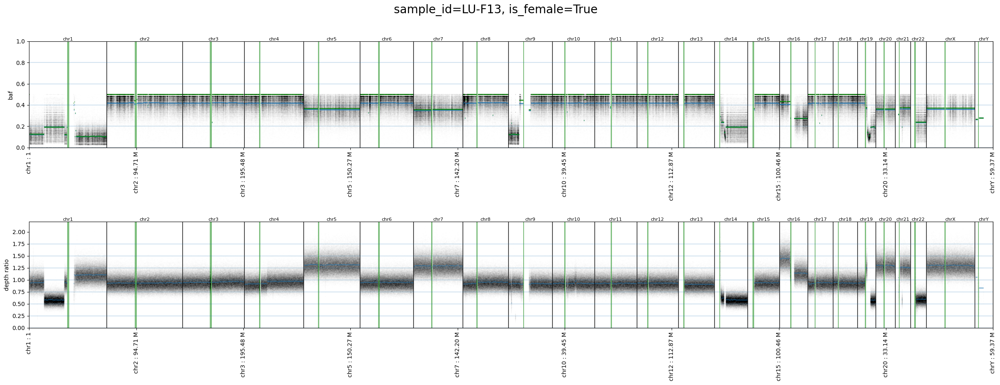

In [459]:
fig, axd = cnvplotter.plot_woCN(sampleid)
for y in np.arange(0, 1, 0.2):
    axd['baf'].axhline(y, alpha=0.2)
for y in np.arange(0, 2, 0.25):
    axd['depth'].axhline(y, alpha=0.2)

### Plot panel region with wgs

In [288]:
import handygenome.cnv.gcfraction as libgcfraction
import handygenome.cnv.mosdepth as libmosdepth
import handygenome.cnv.misc as cnvmisc
import handygenome.pyranges_helper as pyranges_helper
import handygenome.variant.variantplus as libvp
import handygenome.cnv.rcopynumber as rcopynumber
import handygenome.plot.genomeplot as libgenomeplot
import handygenome.cnv.baf as libbaf

In [291]:
sampleid = 'LU-F13'
sampleid_normal = sampleid + '_normal'
sampleid_tumor = sampleid + '_tumor'
sampleid_panel = f'{sampleid}_panel'
print(sampleid)

LU-F13


In [289]:
wgs_normal_mosdepth_output_path = f'/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/results/{sampleid}.normal/{sampleid}.normal.regions.bed.gz'
wgs_tumor_mosdepth_output_path = f'/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/23_binned_depths/results/{sampleid}.tumor/{sampleid}.tumor.regions.bed.gz'
# baf_vcf_path = f'/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/06_haplotypecaller/annotation_230126/{sampleid}.readstats.het_filtered.tumorannot.vcf.gz'
baf_vcf_path = '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/06_haplotypecaller/merged_vcfs/LU-F13.merged.vcf.gz.strip.n_readstats.filtered_het.t_readstats.vcf.gz'

In [290]:
cnvplotter = libgenomeplot.CNVPlotter(refver='hg19')

In [292]:
cnvplotter.add_sample_file(
    sampleid=sampleid,
    is_female=IS_FEMALE[sampleid],
    
    tumor_vcf_path=baf_vcf_path,
    tumor_vcf_sampleid=sampleid_tumor,
    
    normal_depth_path=wgs_normal_mosdepth_output_path,
    tumor_depth_path=wgs_tumor_mosdepth_output_path,
    
    vcfload_nproc=18,
    mode='wgs',
)

[KST 2023-04-10 03:57:36.679 genomeplot.add_sample_file] line 614: Loading normal depth
[KST 2023-04-10 03:58:25.524 genomeplot.add_sample_file] line 616: Loading tumor depth
[KST 2023-04-10 03:59:14.108 genomeplot.add_sample_file] line 618: Loading tumor germline vcf
[KST 2023-04-10 03:59:14.160 variantplus.get_vafdf] line 1861: Extracting vcf position information
[KST 2023-04-10 03:59:34.131 variantplus.get_vafdf] line 1870: Running parallel jobs
[KST 2023-04-10 04:00:10.442 variantplus.get_vafdf] line 1877: Concatenating split job dataframes


In [354]:
cnvplotter.set_depthratio(sampleid)
cnvplotter.upscale_depthratio(sampleid, 1000)
cnvplotter.make_depth_segment(sampleid, verbose=True)
cnvplotter.make_baf_segment(sampleid, bafcorrector=libbaf.load_bafcorrect_func(), verbose=True)

[KST 2023-04-10 10:12:51.963 rcopynumber.make_merged_df] line 429: Adding chromosome arm information
[KST 2023-04-10 10:12:55.481 rcopynumber.make_merged_df] line 432: Removing rows with missing depth or arm information
[KST 2023-04-10 10:12:56.009 rcopynumber.run_rcopynumber_unified] line 709: Writing dataframe into file for R-copynumber input
[KST 2023-04-10 10:13:23.436 rcopynumber.run_rcopynumber_unified] line 714: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chromosome arm 15q 
pcf finished for ch

[KST 2023-04-10 10:14:21.126 rcopynumber.run_rcopynumber_unified] line 733: Loading R-copynumber output
[KST 2023-04-10 10:14:22.298 rcopynumber.make_merged_df] line 429: Adding chromosome arm information
[KST 2023-04-10 10:14:24.911 rcopynumber.make_merged_df] line 432: Removing rows with missing depth or arm information
[KST 2023-04-10 10:14:25.241 rcopynumber.run_rcopynumber_unified] line 709: Writing dataframe into file for R-copynumber input
[KST 2023-04-10 10:14:39.959 rcopynumber.run_rcopynumber_unified] line 714: Running R-copynumber


pcf finished for chromosome arm 1p 
pcf finished for chromosome arm 1q 
pcf finished for chromosome arm 2p 
pcf finished for chromosome arm 2q 
pcf finished for chromosome arm 3p 
pcf finished for chromosome arm 3q 
pcf finished for chromosome arm 4p 
pcf finished for chromosome arm 4q 
pcf finished for chromosome arm 5p 
pcf finished for chromosome arm 5q 
pcf finished for chromosome arm 6p 
pcf finished for chromosome arm 6q 
pcf finished for chromosome arm 7p 
pcf finished for chromosome arm 7q 
pcf finished for chromosome arm 8p 
pcf finished for chromosome arm 8q 
pcf finished for chromosome arm 9p 
pcf finished for chromosome arm 9q 
pcf finished for chromosome arm 10p 
pcf finished for chromosome arm 10q 
pcf finished for chromosome arm 11p 
pcf finished for chromosome arm 11q 
pcf finished for chromosome arm 12p 
pcf finished for chromosome arm 12q 
pcf finished for chromosome arm 13q 
pcf finished for chromosome arm 14q 
pcf finished for chromosome arm 15q 
pcf finished for ch

[KST 2023-04-10 10:15:08.500 rcopynumber.run_rcopynumber_unified] line 733: Loading R-copynumber output


pcf finished for chromosome arm Xq 
pcf finished for chromosome arm Yp 
pcf finished for chromosome arm Yq 


[KST 2023-04-10 13:29:29.429 genomeplot.plot_woCN_base] line 1070: Beginning conversion of data coordinates into plot coordinates
[KST 2023-04-10 13:29:34.859 genomeplot.plot_woCN_base] line 1072: Finished conversion of data coordinates into plot coordinates


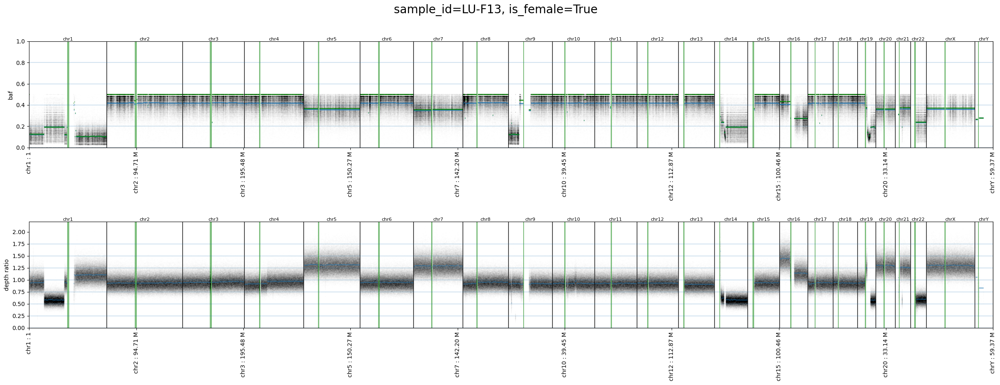

In [459]:
fig, axd = cnvplotter.plot_woCN(sampleid)
for y in np.arange(0, 1, 0.2):
    axd['baf'].axhline(y, alpha=0.2)
for y in np.arange(0, 2, 0.25):
    axd['depth'].axhline(y, alpha=0.2)

In [376]:
bafgr = pr.PyRanges(cnvplotter.data[sampleid]['tumor_baf'])
data_dict = {
    x: bafgr[x].baf_raw.to_numpy() 
    for x in ('2', '3', '4', '6', '8', '10', '11', '12', '13', '15', '17', '18')
}
datalist = list(data_dict.values())

In [343]:
subdatalist = list(itertools.chain.from_iterable(
    (np.random.choice(x, 10000) for k in range(100))
    for x in datalist
))

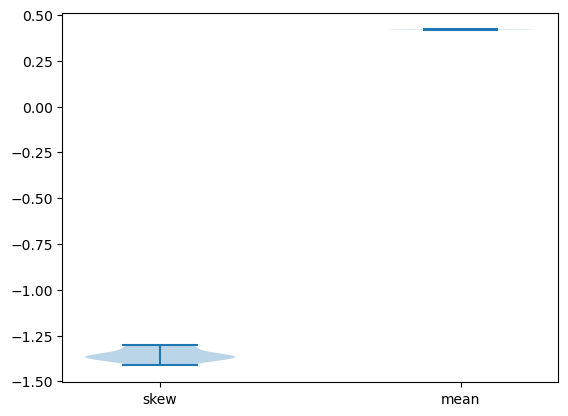

In [377]:
# skews = np.fromiter((scipy.stats.skew(x) for x in subdatalist), dtype=float)
# means = np.fromiter((x.mean() for x in subdatalist), dtype=float)

skews = np.fromiter((scipy.stats.skew(x) for x in datalist), dtype=float)
means = np.fromiter((x.mean() for x in datalist), dtype=float)

fig, ax = plt.subplots()
ax.set_xticks([1, 2])
ax.set_xticklabels(['skew', 'mean'])
_ = ax.violinplot(np.array([skews, means]).T)

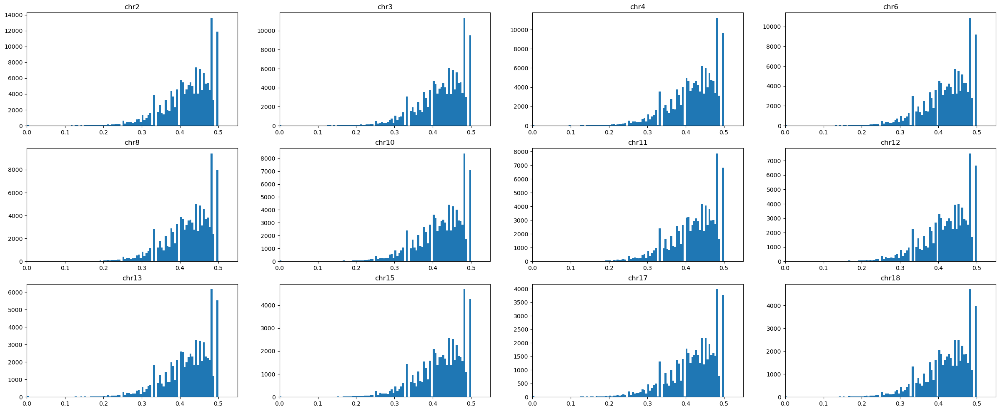

In [378]:
fig, axs = plt.subplots(3, 4, figsize=(30, 12))
for (chrom, data), ax in zip(data_dict.items(), axs.flat):
    ax.set_xlim(0, 0.55)
    ax.set_title(f'chr{chrom}')
    _ = ax.hist(data, bins=100)

In [427]:
cnvplotter.make_merged_segment(sampleid)

In [428]:
cnvplotter.calc_cpscore(sampleid, nproc=16, CNt_weight=5)

In [429]:
PREVIOUS_PLOIDY[sampleid], PREVIOUS_PURITY[sampleid]

(2.4, 0.75)

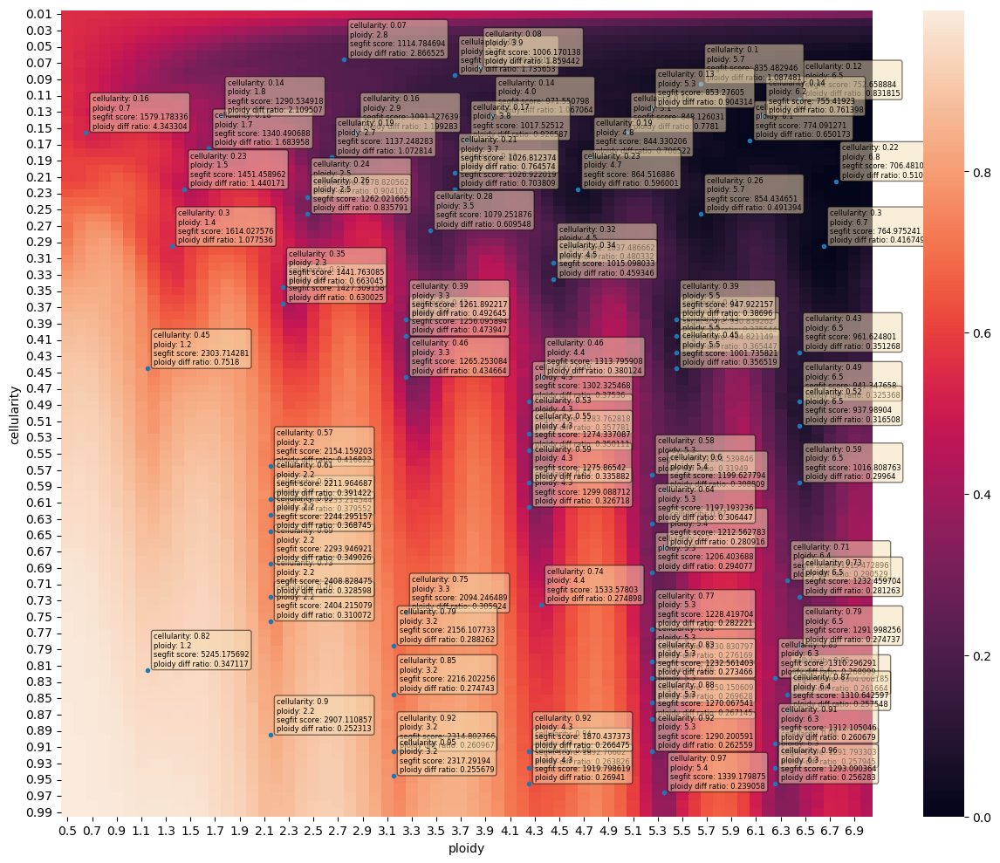

In [430]:
cnvplotter.show_peaks(sampleid, figsize=(15, 12))

In [431]:
cnvplotter.postprocess_segment(sampleid, cellularity=0.75, ploidy=2.2)

In [432]:
cnvplotter.data[sampleid]['merged_segment']

,Chromosome,Start,End,depthratio_segment_mean,baf_segment_mean,corrected_baf_segment_mean,CNn,overlap_length,CNt,B,A,depthratio_predicted,baf_predicted
0,7,10499,31438,1.2789,0.3481,0.3554,2,20939,3.0,1.0,2.0,1.279070,0.363636
1,7,31438,2896500,1.2789,0.3481,0.3554,2,2865062,3.0,1.0,2.0,1.279070,0.363636
2,7,2896500,2897499,1.2789,0.3481,0.3554,2,999,3.0,1.0,2.0,1.279070,0.363636
3,7,2897499,2901500,46.4952,0.3481,0.3554,2,4001,133.0,46.0,87.0,46.627907,0.346633
4,7,2901500,2902499,46.4952,0.3481,0.3554,2,999,133.0,46.0,87.0,46.627907,0.346633
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6864,6,162423499,162744500,0.8658,0.4208,0.5000,2,321001,2.0,1.0,1.0,0.930233,0.500000
6865,6,162744500,162745499,0.8658,0.4208,0.5000,2,999,2.0,1.0,1.0,0.930233,0.500000
6866,6,162745499,170919858,0.9470,0.4208,0.5000,2,8174359,2.0,1.0,1.0,0.930233,0.500000
6867,6,170919858,171038500,0.9470,0.4208,0.5000,2,118642,2.0,1.0,1.0,0.930233,0.500000


[KST 2023-04-10 13:23:57.915 genomeplot.plot_final_base] line 1114: Beginning conversion of data coordinates into plot coordinates
[KST 2023-04-10 13:24:04.090 genomeplot.plot_final_base] line 1116: Finished conversion of data coordinates into plot coordinates


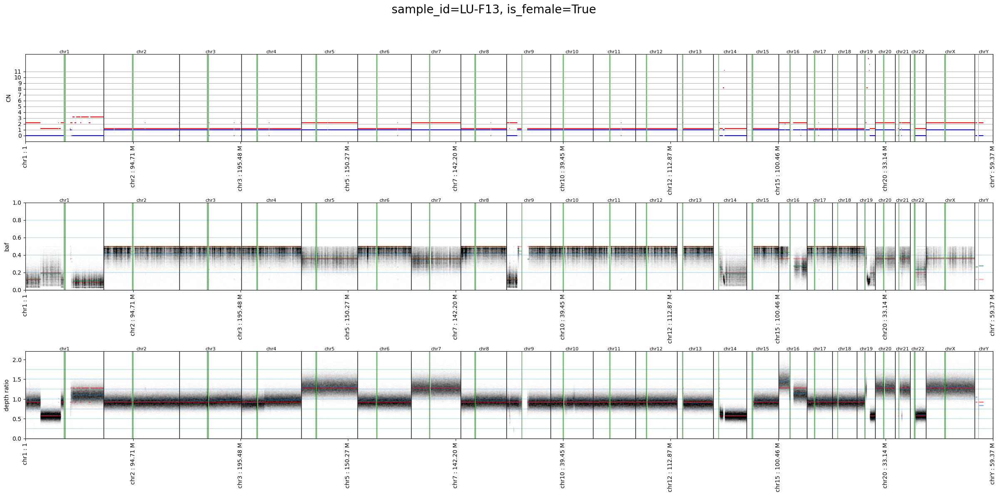

In [457]:
fig, axd = cnvplotter.plot_final(sampleid)
for y in np.arange(0, 1, 0.2):
    axd['baf'].axhline(y, alpha=0.2)
for y in np.arange(0, 2, 0.25):
    axd['depth'].axhline(y, alpha=0.2)

axd['CN'].set_yticks(np.arange(0, 12, 1))
axd['CN'].grid(axis='y')

In [684]:
baf_segments_mode2 = rcopynumber.run_rcopynumber_unified(
    depth_df=cnvplotter.data['LU-14']['tumor_baf'].rename(columns={'baf_raw': 'depth_raw'}),
    refver='hg19', as_gr=False, winsorize=False,
)

In [716]:
seg_baf_joined = pyranges_helper.join(
    pr.PyRanges(baf_segments_mode2[0])[[]]['12'], 
    cnvplotter.data['LU-14']['tumor_baf'], 
    how='left', merge=None,
)
grouped_bafs = dict(
    (key, val.baf_raw) for key, val in seg_baf_joined.groupby(['Chromosome', 'Start', 'End'])
)

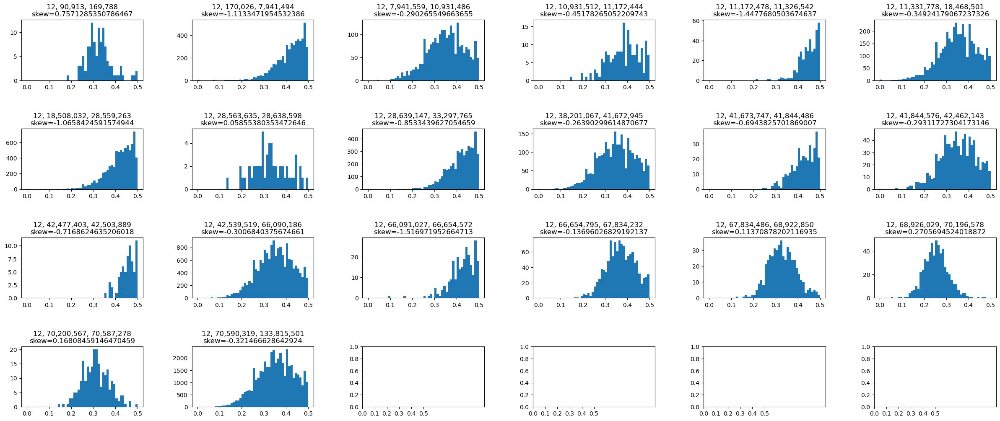

In [740]:
ncol = 6
nrow = np.ceil(len(grouped_bafs) / ncol).astype(int)

fig, axs = plt.subplots(
    nrow, ncol, figsize=(30, 12), 
    gridspec_kw=dict(wspace=0.4, hspace=0.8),
    subplot_kw=dict(
        xticks=np.arange(0, 0.6, 0.1), 
        # ylim=(0, 150_000), 
        # yscale='log',
    ),
)
for ax, (coords, baf_vals) in zip(axs.flat, grouped_bafs.items()):
    skew = scipy.stats.skew(baf_vals, nan_policy='omit')
    ax.set_title(
        f'{coords[0]}, {coords[1]:,}, {coords[2]:,}' + '\n' + f'skew={skew}'
    )
    ax.hist(baf_vals, range=(0, .5), bins=50)

In [285]:
seqz_df = pd.read_csv(
    '/home/users/team_projects/Lung_Cancer_Panel_data/03_Data_from_YTKim/05_sequenza/14/sequenza_files/seqz_files/14_tumor.bin50.seqz.gz', 
    sep='\t',
    header=0,
    usecols=['chromosome', 'position', 'Bf'],
    dtype={'chromosome': str, 'position': int, 'Bf': float},
)

In [291]:
seqz_df_het = seqz_df.loc[seqz_df.Bf > 0, :]

In [292]:
seqz_chr1 = seqz_df_het.loc[seqz_df_het.chromosome == '1', :]

In [305]:
tmppath = '/home/users/pjh/practice/r-copynumber/chr1_germlines.tsv.gz'
seqz_chr1.rename(columns={'chromosome': 'chrom', 'position': 'pos', 'Bf': 'val'}).to_csv(tmppath, sep='\t', header=True, index=False)

(array([  210.,   786.,  1520.,  2633.,  5072., 10077., 18823., 33833.,
        47612., 60304.]),
 array([0.013 , 0.0617, 0.1104, 0.1591, 0.2078, 0.2565, 0.3052, 0.3539,
        0.4026, 0.4513, 0.5   ]),
 <BarContainer object of 10 artists>)

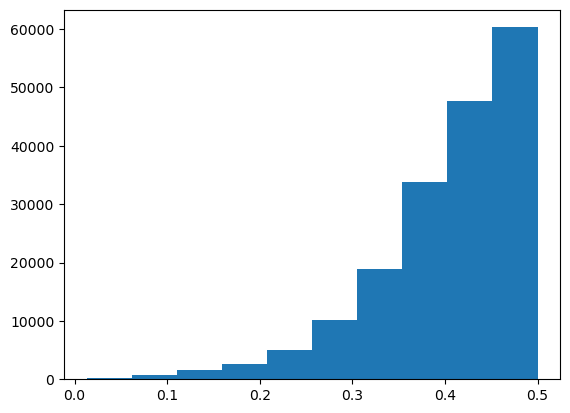

In [294]:
plt.hist(seqz_chr1.Bf)

(array([1.6000e+01, 4.0000e+01, 1.2600e+02, 3.9600e+02, 1.2750e+03,
        5.1240e+03, 1.3019e+04, 2.5366e+04, 4.7814e+04, 5.9332e+04]),
 array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ]),
 <BarContainer object of 10 artists>)

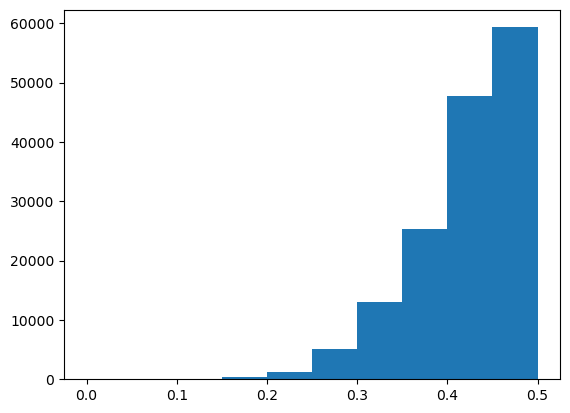

In [301]:
plt.hist(pr.PyRanges(cnvplotter.data[sampleid]['tumor_baf'])['1'].baf_raw)

(array([1.6000e+01, 4.0000e+01, 1.2600e+02, 3.9600e+02, 1.2750e+03,
        5.1240e+03, 1.3019e+04, 2.5366e+04, 4.7814e+04, 5.9332e+04]),
 array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ]),
 <BarContainer object of 10 artists>)

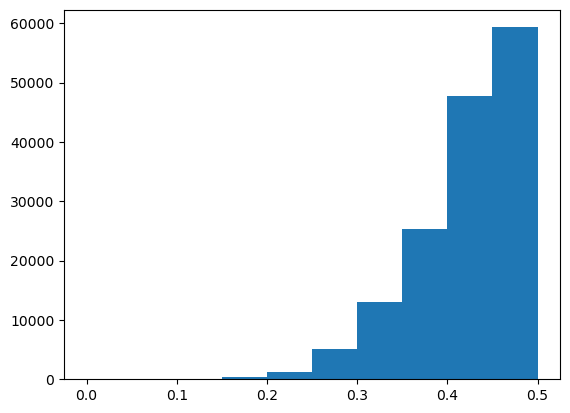

In [301]:
plt.hist(pr.PyRanges(cnvplotter.data[sampleid]['tumor_baf'])['1'].baf_raw)

In [319]:
cnvplotter.data[sampleid]['tumor_baf']

,Chromosome,Start,End,baf_raw
0,1,54420,54421,0.488636
1,1,55298,55299,0.368421
2,1,87189,87190,0.420455
3,1,88168,88169,0.341463
4,1,723752,723761,0.405405
...,...,...,...,...
45,GL000192.1,531006,531007,0.335938
46,GL000192.1,532150,532151,0.386364
47,GL000192.1,544363,544364,0.482759
48,GL000192.1,544858,544859,0.447368


In [321]:
baf_seg = rcopynumber.run_rcopynumber_unified(
    baf_df=cnvplotter.data[sampleid]['tumor_baf'],
    refver='hg19',
    as_gr=False,
    winsorize=False,
    compact=False,
    verbose=True,
)

[KST 2023-03-31 11:11:27.797 rcopynumber.run_rcopynumber_unified] line 708: Writing dataframe into file for R-copynumber input
[KST 2023-03-31 11:11:42.834 rcopynumber.run_rcopynumber_unified] line 713: Running R-copynumber


aspcf finished for chromosome arm 1p 
aspcf finished for chromosome arm 1q 
aspcf finished for chromosome arm 2p 
aspcf finished for chromosome arm 2q 
aspcf finished for chromosome arm 3p 
aspcf finished for chromosome arm 3q 
aspcf finished for chromosome arm 4p 
aspcf finished for chromosome arm 4q 
aspcf finished for chromosome arm 5p 
aspcf finished for chromosome arm 5q 
aspcf finished for chromosome arm 6p 
aspcf finished for chromosome arm 6q 
aspcf finished for chromosome arm 7p 
aspcf finished for chromosome arm 7q 
aspcf finished for chromosome arm 8p 
aspcf finished for chromosome arm 8q 
aspcf finished for chromosome arm 9p 
aspcf finished for chromosome arm 9q 
aspcf finished for chromosome arm 10p 
aspcf finished for chromosome arm 10q 
aspcf finished for chromosome arm 11p 
aspcf finished for chromosome arm 11q 
aspcf finished for chromosome arm 12p 
aspcf finished for chromosome arm 12q 
aspcf finished for chromosome arm 13q 
aspcf finished for chromosome arm 14q 
aspc

[KST 2023-03-31 11:12:26.395 rcopynumber.run_rcopynumber_unified] line 732: Loading R-copynumber output


In [322]:
baf_seg[0]

,Chromosome,Start,End,depth_segment_mean,baf_segment_mean
0,1,54420,121477799,1,0.4130
1,1,142792809,249216702,1,0.4292
2,2,16168,92288519,1,0.4245
3,2,95527943,243183863,1,0.4195
4,3,61761,90504122,1,0.4255
5,3,93522068,197896856,1,0.4227
6,4,28384,49633261,1,0.3991
7,4,52680888,191037243,1,0.4257
8,5,14781,46404548,1,0.4337
9,5,49441600,180719407,1,0.4141


In [ ]:
depth_seg = rcopynumber.run_rcopynumber_unified(
    depth_df=cnvplotter.data[sampleid]['tumor_baf'].rename(columns={'baf_raw': 'depth_raw'}),
    refver='hg19',
    as_gr=False,
    winsorize=False,
    compact=False,
    verbose=True,
)

##### depth

In [18]:
wgs_normal_mosdepth_df = libmosdepth.load_mosdepth_output(wgs_normal_mosdepth_output_path, as_gr=False)
wgs_tumor_mosdepth_df = libmosdepth.load_mosdepth_output(wgs_tumor_mosdepth_output_path, as_gr=False)

In [19]:
wgs_normal_depth_df, wgs_normal_gcbin_average_depths = cnvmisc.postprocess_depth_df(
    wgs_normal_mosdepth_df, 
    gc_df=libgcfraction.get_gc_df('hg19', 100, True),
    preset_cutoffs='normal_wgs',
    as_gr=False,
)

In [20]:
wgs_normal_depth_df_2, wgs_normal_gcbin_average_depths = cnvmisc.postprocess_depth_df(
    wgs_normal_mosdepth_df, 
    gc_df=libgcfraction.get_gc_df('hg19', 100, True),
    preset_cutoffs='wgs',
    as_gr=False,
)

In [28]:
wgs_tumor_depth_df, wgs_tumor_gcbin_average_depths = cnvmisc.postprocess_depth_df(
    wgs_tumor_mosdepth_df, 
    gc_df=libgcfraction.get_gc_df('hg19', 100, True),
    preset_cutoffs='wgs',
    as_gr=False,
)

In [61]:
wgs_depthratio_df = cnvmisc.make_depth_ratio_df(wgs_tumor_depth_df, wgs_normal_depth_df)

In [62]:
binned_wgs_depthratio_df = cnvmisc.upsize_depth_df_bin(wgs_depthratio_df, size=10000, refver='hg19')

##### baf

In [275]:
vafdf = libvp.get_vafdf(baf_vcf_path, sampleid=['LU-14_normal', 'LU-14_tumor'], nproc=12)

[KST 2023-03-30 00:49:15.171 variantplus.get_vafdf] line 1834: Extracting vcf position information
[KST 2023-03-30 00:50:16.163 variantplus._get_vafdf_targetfunc] line 1867: Beginning job over region <Interval> 1:54,421-249,250,621 (1-based)
[KST 2023-03-30 00:50:16.198 variantplus._get_vafdf_targetfunc] line 1867: Beginning job over region <Interval> 2:16,784,880-243,199,373 (1-based)
[KST 2023-03-30 00:50:16.243 variantplus._get_vafdf_targetfunc] line 1867: Beginning job over region <Interval> 3:15,078,366-198,022,430 (1-based)
[KST 2023-03-30 00:50:16.291 variantplus._get_vafdf_targetfunc] line 1867: Beginning job over region <Interval> 4:56,877,477-191,154,276 (1-based)
[KST 2023-03-30 00:50:16.336 variantplus._get_vafdf_targetfunc] line 1867: Beginning job over region <Interval> 5:88,917,395-180,915,260 (1-based)
[KST 2023-03-30 00:50:16.384 variantplus._get_vafdf_targetfunc] line 1867: Beginning job over region <Interval> 6:119,531,838-171,115,067 (1-based)
[KST 2023-03-30 00:50:

In [277]:
vafdf.head()

,Chromosome,Start,End,POS,REF,ALT,vaf_LU-14_normal,vaf_LU-14_tumor
0,1,54420.0,54421.0,54421.0,A,G,0.369565,0.488636
1,1,55298.0,55299.0,55299.0,C,T,0.645570,0.631579
2,1,87189.0,87190.0,87190.0,G,A,0.504950,0.579545
3,1,88168.0,88169.0,88169.0,C,T,0.566667,0.658537
4,1,723752.0,723761.0,723753.0,AGAGAGAGG,A,0.545455,0.405405


In [69]:
bin_df = binned_wgs_depthratio_df.iloc[:, :3]
binned_baf_df = pyranges_helper.join(
    bin_df, vafdf.loc[:, vafdf.columns.drop(['POS', 'REF', 'ALT'])], 
    how='left', merge='mean', 
    sort=True, refver='hg19',
    verbose=False,
)

In [106]:
# run copynumber
seg_df, depth_baf_merged_df = rcopynumber.run_rcopynumber_unified(
    depth_df=binned_wgs_depthratio_df.rename(columns={'depth_ratio_sequenzastyle': 'depth_raw'}),
    baf_df=binned_baf_df.rename(columns={'vaf_LU-14_tumor': 'baf_raw'}),
    refver='hg19',
    as_gr=False,
    winsorize=True, compact=False, verbose=True,
)

[KST 2023-03-29 00:33:51.011 rcopynumber.make_merged_df] line 414: Joining depth and baf dataframes
[KST 2023-03-29 00:34:19.979 rcopynumber.make_merged_df] line 427: Adding chromosome arm information
[KST 2023-03-29 00:34:20.175 rcopynumber.make_merged_df] line 430: Removing rows with missing depth or arm information
[KST 2023-03-29 00:34:20.226 rcopynumber.run_rcopynumber_unified] line 614: Writing dataframe into file for R-copynumber input
[KST 2023-03-29 00:34:24.115 rcopynumber.run_rcopynumber_unified] line 619: Running R-copynumber


winsorize finished for chromosome arm 1p 
winsorize finished for chromosome arm 1q 
winsorize finished for chromosome arm 2p 
winsorize finished for chromosome arm 2q 
winsorize finished for chromosome arm 3p 
winsorize finished for chromosome arm 3q 
winsorize finished for chromosome arm 4p 
winsorize finished for chromosome arm 4q 
winsorize finished for chromosome arm 5p 
winsorize finished for chromosome arm 5q 
winsorize finished for chromosome arm 6p 
winsorize finished for chromosome arm 6q 
winsorize finished for chromosome arm 7p 
winsorize finished for chromosome arm 7q 
winsorize finished for chromosome arm 8p 
winsorize finished for chromosome arm 8q 
winsorize finished for chromosome arm 9p 
winsorize finished for chromosome arm 9q 
winsorize finished for chromosome arm 10p 
winsorize finished for chromosome arm 10q 
winsorize finished for chromosome arm 11p 
winsorize finished for chromosome arm 11q 
winsorize finished for chromosome arm 12p 
winsorize finished for chromo

aspcf is not run for sample in chromosome arm Xq because all of the BAF-values are outside the threshold values. Mean is returned for logR.
aspcf is not run for sample in chromosome arm Yp because all of the BAF-values are outside the threshold values. Mean is returned for logR.
aspcf is not run for sample in chromosome arm Yq because all of the BAF-values are outside the threshold values. Mean is returned for logR.
[KST 2023-03-29 00:35:05.823 rcopynumber.run_rcopynumber_unified] line 638: Loading R-copynumber output


In [108]:
seg_df

,Chromosome,Start,End,depth_segment_mean,baf_segment_mean
0,1,14999,90755000,1.0214,0.5000
1,1,90764999,91355000,1.0196,0.4006
2,1,91364999,105575000,1.0241,0.5000
3,1,105584999,105775000,1.0228,0.4114
4,1,105784999,121355000,1.0205,0.5000
...,...,...,...,...,...
276,X,2164999,6715000,0.9582,0.2867
277,X,6724999,58565000,0.9541,0.5000
278,X,61684999,155255000,1.2203,NaN
279,Y,2644999,10105000,0.8942,NaN


In [140]:
locus = ('1', 100_000_000, 140_000_000)
# locus = ('1', 143_900_000, 144_100_000)

In [135]:
igv.goto([locus])

OK


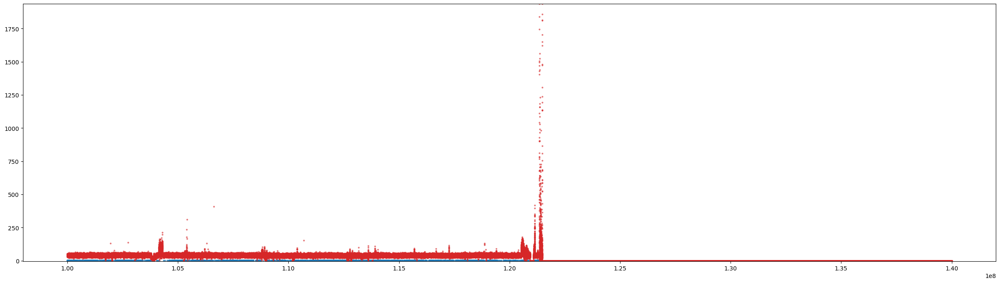

In [141]:
subdf = vafgr[locus[0], locus[1]:locus[2]].df
depth_subdf = normal_depth_gr[locus[0], locus[1]:locus[2]].df
# subdf = vafgr['1'].df

# print(subdf)

fig, ax = plt.subplots(figsize=(30, 8))
ax.set_ylim(-5, depth_subdf['mean_depth'].max())
ax.plot(subdf['Start'], subdf['vaf_LU-14_normal'], marker='o', linestyle='', markersize=2, color='tab:blue', alpha=0.5)
ax.plot(depth_subdf['Start'], depth_subdf['mean_depth'], marker='o', linestyle='', markersize=2, color='tab:red', alpha=0.5)
# ax.plot(subdf['Start'], subdf['vaf_LU-14_tumor'], marker='o', linestyle='', markersize=1, color='tab:red', alpha=0.5)